In [ ]:
!nvidia-smi -L

GPU 0: Tesla P100-PCIE-16GB (UUID: GPU-08f9e69b-50dc-68cb-1b3e-9321ae8936d0)


In [ ]:
!rm -r sample_data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!git clone https://github.com/manigalati/psa

Cloning into 'psa'...
remote: Enumerating objects: 115, done.
remote: Counting objects: 100% (53/53), done.
remote: Compressing objects: 100% (53/53), done.
remote: Total 115 (delta 26), reused 0 (delta 0), pack-reused 62
Receiving objects: 100% (115/115), 1.24 MiB | 6.53 MiB/s, done.
Resolving deltas: 100% (51/51), done.


In [ ]:
%cd psa

/content/psa


In [ ]:
!pip install git+https://github.com/lucasb-eyer/pydensecrf.git

  Cloning https://github.com/lucasb-eyer/pydensecrf.git to /tmp/pip-req-build-7ltjzzkm
  Running command git clone -q https://github.com/lucasb-eyer/pydensecrf.git /tmp/pip-req-build-7ltjzzkm
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for pydensecrf: filename=pydensecrf-1.0rc2-cp37-cp37m-linux_x86_64.whl size=2774138 sha256=4b59c61bc77a541712e741e51ed987393913b386936c155126b994428e445a88
  Stored in directory: /tmp/pip-ephem-wheel-cache-urg0fc3k/wheels/81/ac/ed/09f1890b954ca1ff7f189518cc9a319138e50e7ea88937fae9
Successfully built pydensecrf


002_96_vessel.npy


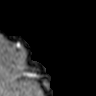

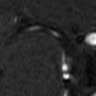

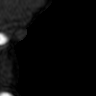

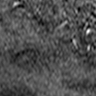

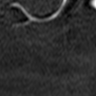

...

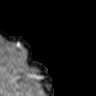

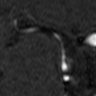

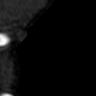

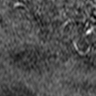

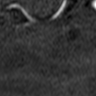

002_96_empty.npy


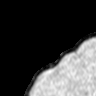

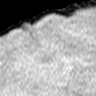

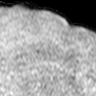

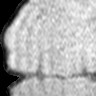

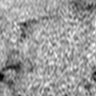

...

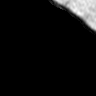

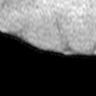

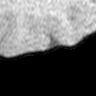

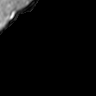

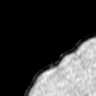

004_96_vessel.npy


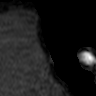

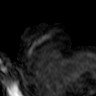

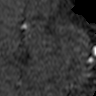

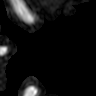

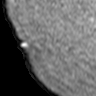

...

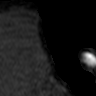

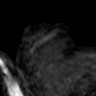

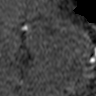

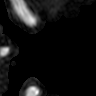

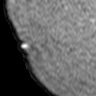

004_96_empty.npy


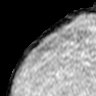

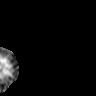

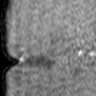

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in true_divide
  


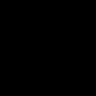

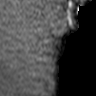

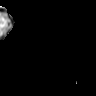

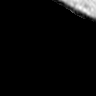

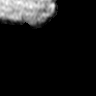

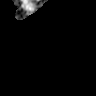

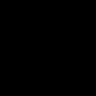

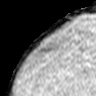

005_96_vessel.npy


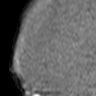

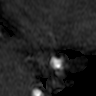

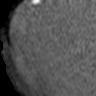

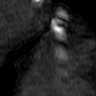

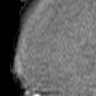

...

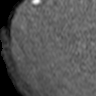

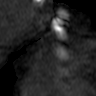

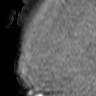

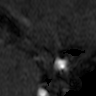

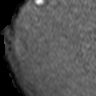

005_96_empty.npy


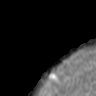

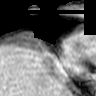

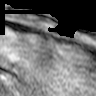

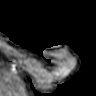

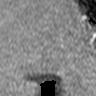

...

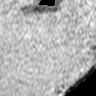

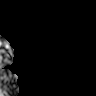

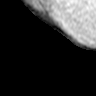

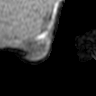

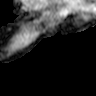

006_96_vessel.npy


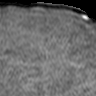

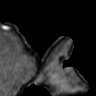

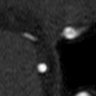

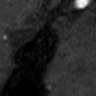

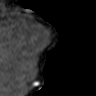

...

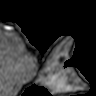

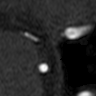

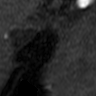

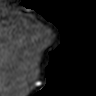

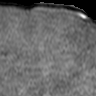

006_96_empty.npy


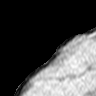

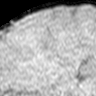

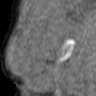

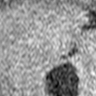

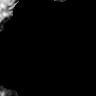

...

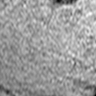

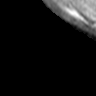

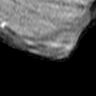

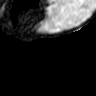

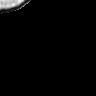

008_96_vessel.npy


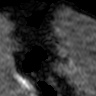

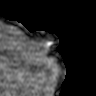

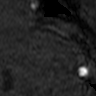

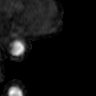

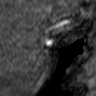

...

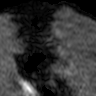

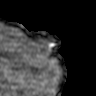

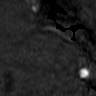

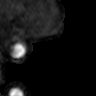

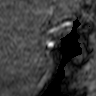

008_96_empty.npy


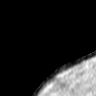

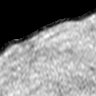

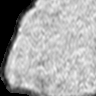

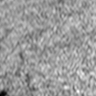

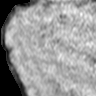

...

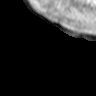

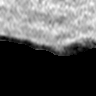

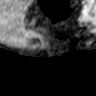

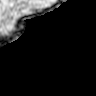

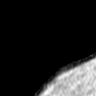

009_96_vessel.npy


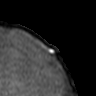

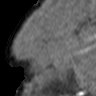

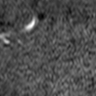

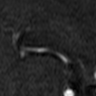

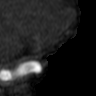

...

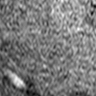

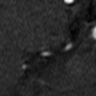

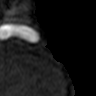

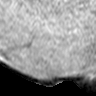

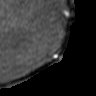

009_96_empty.npy


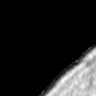

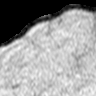

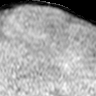

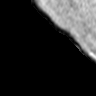

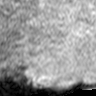

...

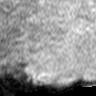

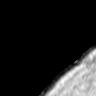

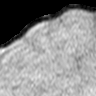

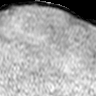

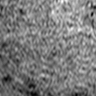

17_96_vessel.npy


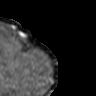

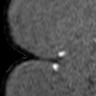

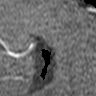

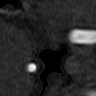

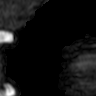

...

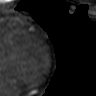

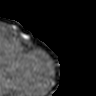

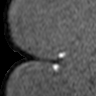

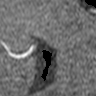

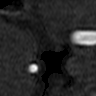

17_96_empty.npy


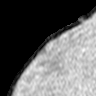

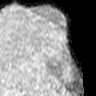

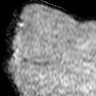

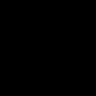

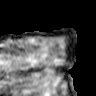

...

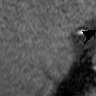

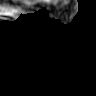

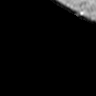

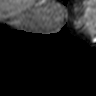

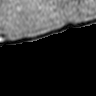

18_96_vessel.npy


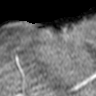

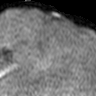

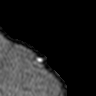

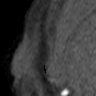

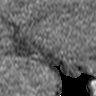

...

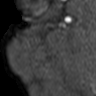

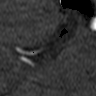

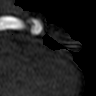

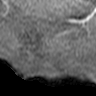

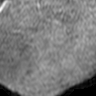

18_96_empty.npy


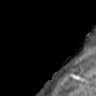

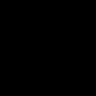

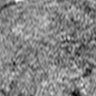

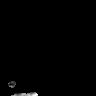

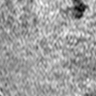

...

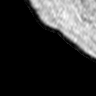

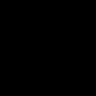

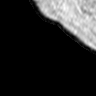

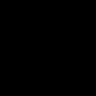

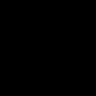

21_96_vessel.npy


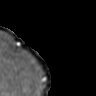

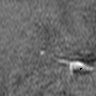

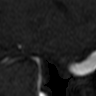

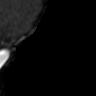

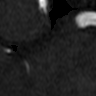

...

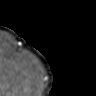

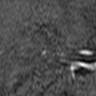

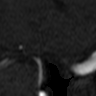

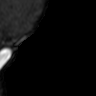

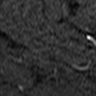

21_96_empty.npy


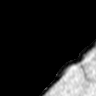

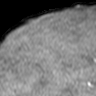

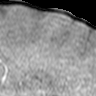

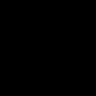

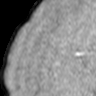

...

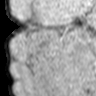

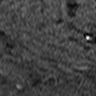

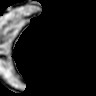

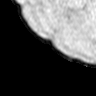

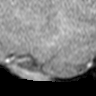

22_96_vessel.npy


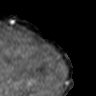

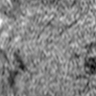

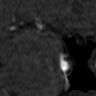

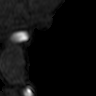

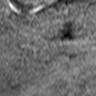

...

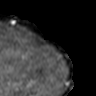

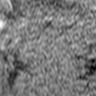

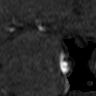

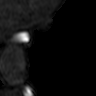

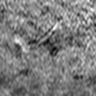

22_96_empty.npy


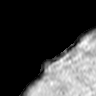

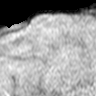

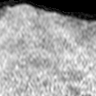

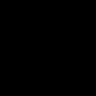

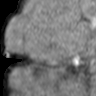

...

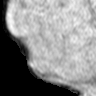

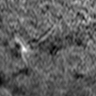

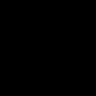

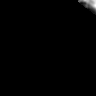

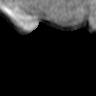

In [ ]:
import os
import numpy as np
from PIL import Image

def display_image(img,title=None):
  img = (img - np.min(img)) / (np.max(img) - np.min(img))
  img *= 255
  img = Image.fromarray(img.astype(np.uint8))
  if title: print(title)
  display(img)

src="/content/drive/MyDrive/tesi/CAPTCHA/patch96"

for img in os.listdir(src):
  print(img)
  img=os.path.join(src,img)
  img=np.load(img)
  for iter,slide in enumerate(img):
    display_image(slide)
    if iter==10:
      break

## Dataloader

In [ ]:
#!mkdir -p data/train_pnetcls
!mkdir -p data/img

#!cp -r /content/drive/MyDrive/tesi/CAPTCHA/train_pnetcls/* data/train_pnetcls/
#!cp -r /content/drive/MyDrive/tesi/CAPTCHA/img/* data/img/
!cp -r /content/drive/MyDrive/tesi/CAPTCHA/patch96/* data/img/

!mkdir data/img_val
#!mv data/img/43_96_img.npy data/img_val
!mv data/img/22_96_empty.npy data/img_val
!mv data/img/22_96_vessel.npy data/img_val

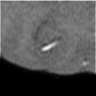

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


In [ ]:
import os
import numpy as np
from PIL import Image

example=Image.open("example.png").resize((96,96),Image.ANTIALIAS)
example=np.array(example)[:,:,0]
display(Image.fromarray(example))

closest=[np.inf,None,None]
for brain in os.listdir("/content/psa/data/img/"):
  brain=f"/content/psa/data/img/{brain}"
  for i,img in enumerate(np.load(brain)):
    if brain=="/content/psa/data/img/009_96_img.npy"and i==336: continue
    img = (img - np.min(img)) / (np.max(img) - np.min(img))
    img *= 255
    img = img.astype(np.uint8)
    if closest[0] >= np.sum(img-example):
      closest[0] = np.sum(img-example)
      closest[1] = brain
      closest[2] = i

In [ ]:
np.save("example.npy",example)

## Class imbalance

In [ ]:
import numpy as np
import os

total_vessel=0
total_empty=0
for image in os.listdir("/content/psa/data/img"):
  if "vessel" in image:
    total_vessel+=np.load("/content/psa/data/img/"+image).shape[0]
    print("vessel: ",total_vessel)
  else:
    total_empty+=np.load("/content/psa/data/img/"+image).shape[0]
    print("empty: ",total_empty)

vessel:  1180
empty:  876
empty:  1868
vessel:  2615
empty:  3467
empty:  4756
empty:  6052
vessel:  3859
empty:  7642
vessel:  5330
vessel:  6438
vessel:  7764
empty:  8973
vessel:  8952
vessel:  10520
vessel:  11226
empty:  10322
empty:  11438


## Training

### w/ our optimizer

In [ ]:
%cd psa

/content/psa


{'batch_size': 16, 'max_epoches': 15, 'network': 'network.vgg16_cls', 'lr': 0.0001, 'num_workers': 8, 'wt_dec': 0.0005, 'weights': None, 'train_list': 'voc12/train_aug.txt', 'val_list': 'voc12/val.txt', 'session_name': 'vgg_cls', 'crop_size': 92, 'voc12_root': 'data/img', 'voc12_root_val': 'data/img_val'}


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Session started:  Mon Jul 12 17:48:56 2021


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
Iter:    0/21240 Loss:0.6929 imps:69.0 Fin:Mon Jul 12 20:33:04 2021 lr: 0.0001
example


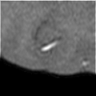

cam_0


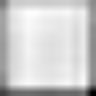

cam_1


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in true_divide


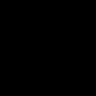

crf_la_0


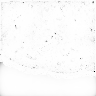

crf_la_1


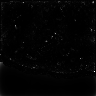

crf_la_2


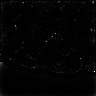

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 

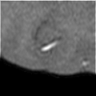

cam_0


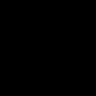

cam_1


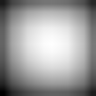

crf_la_0


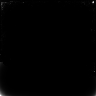

crf_la_1


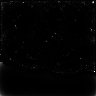

crf_la_2


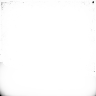

tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 

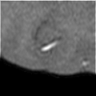

cam_0


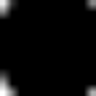

cam_1


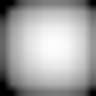

crf_la_0


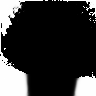

crf_la_1


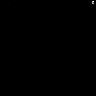

crf_la_2


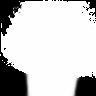

tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 

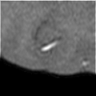

cam_0


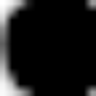

cam_1


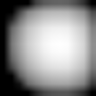

crf_la_0


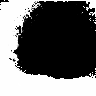

crf_la_1


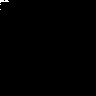

crf_la_2


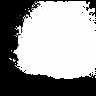

tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 

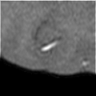

cam_0


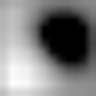

cam_1


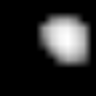

crf_la_0


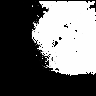

crf_la_1


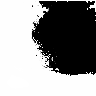

crf_la_2


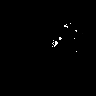

tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 

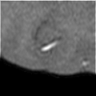

cam_0


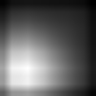

cam_1


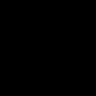

crf_la_0


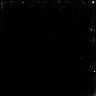

crf_la_1


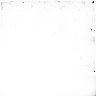

crf_la_2


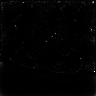

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 

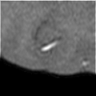

cam_0


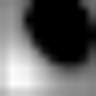

cam_1


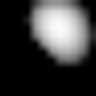

crf_la_0


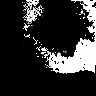

crf_la_1


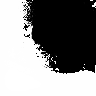

crf_la_2


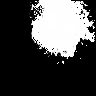

tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 

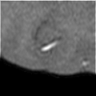

cam_0


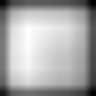

cam_1


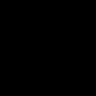

crf_la_0


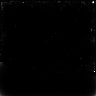

crf_la_1


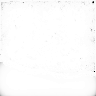

crf_la_2


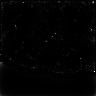

tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 

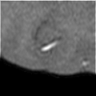

cam_0


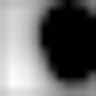

cam_1


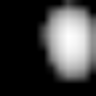

crf_la_0


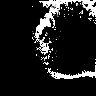

crf_la_1


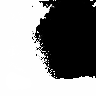

crf_la_2


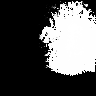

tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 

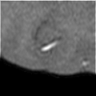

cam_0


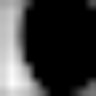

cam_1


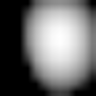

crf_la_0


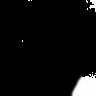

crf_la_1


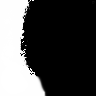

crf_la_2


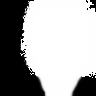

tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 

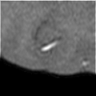

cam_0


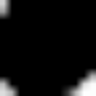

cam_1


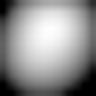

crf_la_0


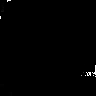

crf_la_1


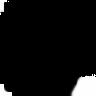

crf_la_2


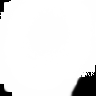

tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 

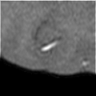

cam_0


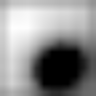

cam_1


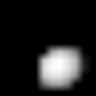

crf_la_0


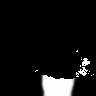

crf_la_1


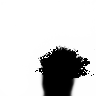

crf_la_2


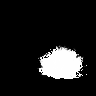

tensor([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 

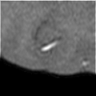

cam_0


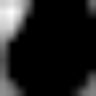

cam_1


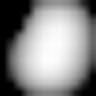

crf_la_0


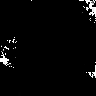

crf_la_1


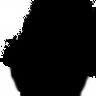

crf_la_2


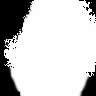

tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 

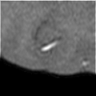

cam_0


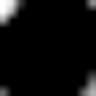

cam_1


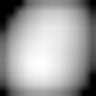

crf_la_0


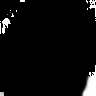

crf_la_1


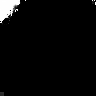

crf_la_2


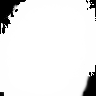

tensor([1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 

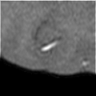

cam_0


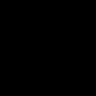

cam_1


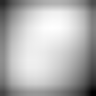

crf_la_0


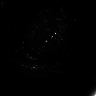

crf_la_1


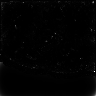

crf_la_2


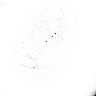

tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 

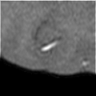

cam_0


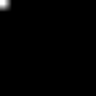

cam_1


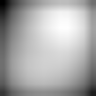

crf_la_0


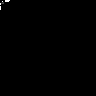

crf_la_1


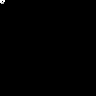

crf_la_2


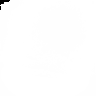

tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 

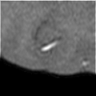

cam_0


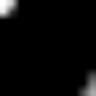

cam_1


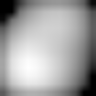

crf_la_0


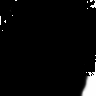

crf_la_1


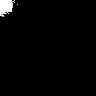

crf_la_2


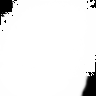

tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 

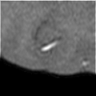

cam_0


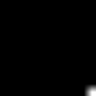

cam_1


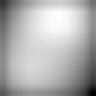

crf_la_0


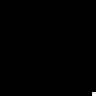

crf_la_1


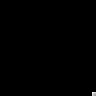

crf_la_2


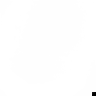

tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 

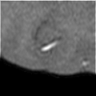

cam_0


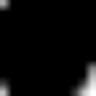

cam_1


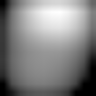

crf_la_0


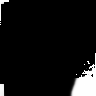

crf_la_1


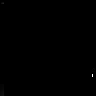

crf_la_2


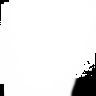

tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 

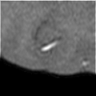

cam_0


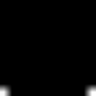

cam_1


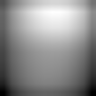

crf_la_0


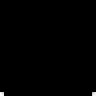

crf_la_1


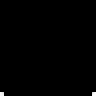

crf_la_2


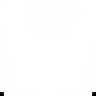

tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 

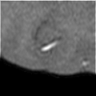

cam_0


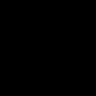

cam_1


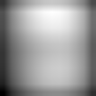

crf_la_0


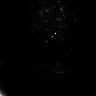

crf_la_1


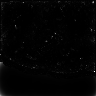

crf_la_2


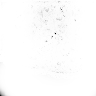

tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 

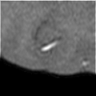

cam_0


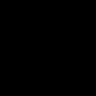

cam_1


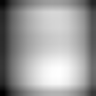

crf_la_0


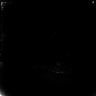

crf_la_1


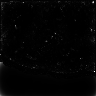

crf_la_2


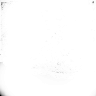

tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 

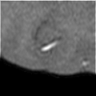

cam_0


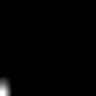

cam_1


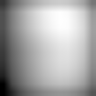

crf_la_0


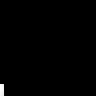

crf_la_1


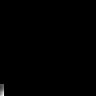

crf_la_2


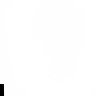

tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 

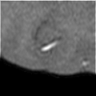

cam_0


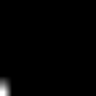

cam_1


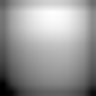

crf_la_0


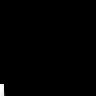

crf_la_1


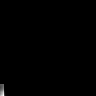

crf_la_2


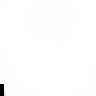

tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 

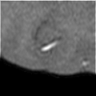

cam_0


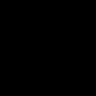

cam_1


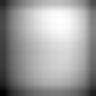

crf_la_0


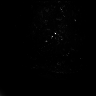

crf_la_1


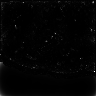

crf_la_2


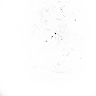

tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 

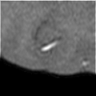

cam_0


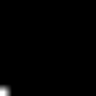

cam_1


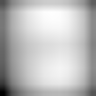

crf_la_0


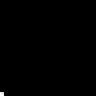

crf_la_1


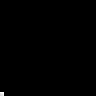

crf_la_2


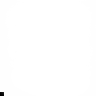

tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 

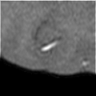

cam_0


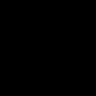

cam_1


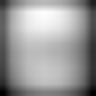

crf_la_0


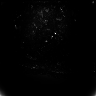

crf_la_1


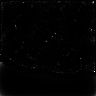

crf_la_2


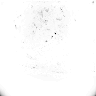

tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 

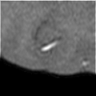

cam_0


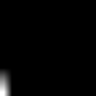

cam_1


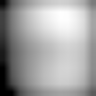

crf_la_0


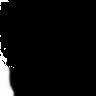

crf_la_1


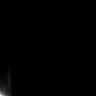

crf_la_2


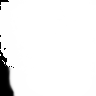

tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 

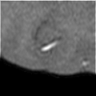

cam_0


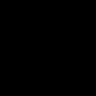

cam_1


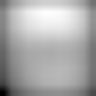

crf_la_0


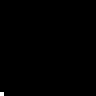

crf_la_1


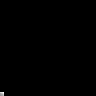

crf_la_2


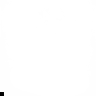

tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 

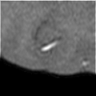

cam_0


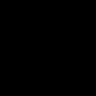

cam_1


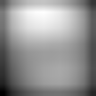

crf_la_0


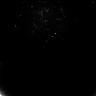

crf_la_1


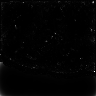

crf_la_2


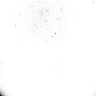

tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 

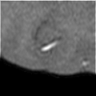

cam_0


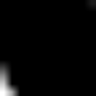

cam_1


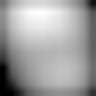

crf_la_0


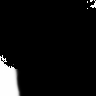

crf_la_1


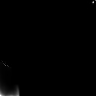

crf_la_2


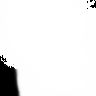

tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 

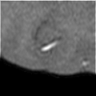

cam_0


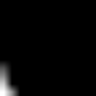

cam_1


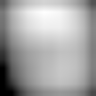

crf_la_0


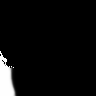

crf_la_1


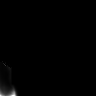

crf_la_2


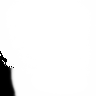

tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 

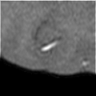

cam_0


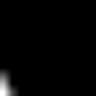

cam_1


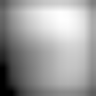

crf_la_0


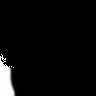

crf_la_1


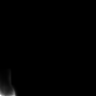

crf_la_2


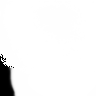

tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 

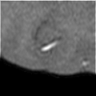

cam_0


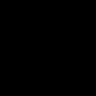

cam_1


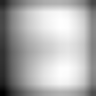

crf_la_0


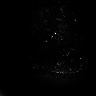

crf_la_1


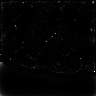

crf_la_2


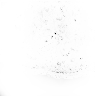

tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 

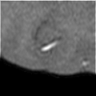

cam_0


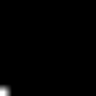

cam_1


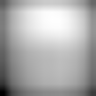

crf_la_0


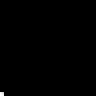

crf_la_1


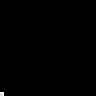

crf_la_2


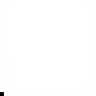

tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 

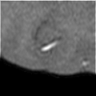

cam_0


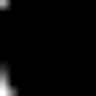

cam_1


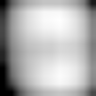

crf_la_0


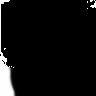

crf_la_1


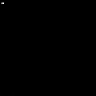

crf_la_2


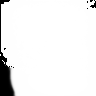

tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 

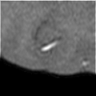

cam_0


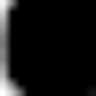

cam_1


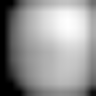

crf_la_0


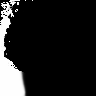

crf_la_1


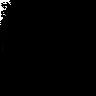

crf_la_2


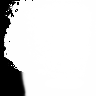

tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 

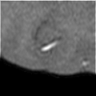

cam_0


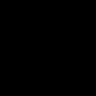

cam_1


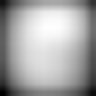

crf_la_0


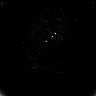

crf_la_1


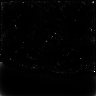

crf_la_2


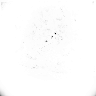

tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 

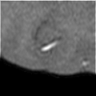

cam_0


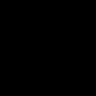

cam_1


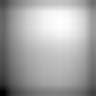

crf_la_0


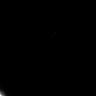

crf_la_1


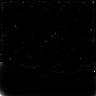

crf_la_2


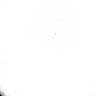

tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 

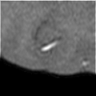

cam_0


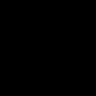

cam_1


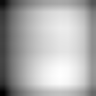

crf_la_0


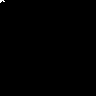

crf_la_1


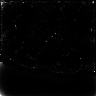

crf_la_2


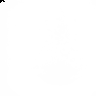

tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 

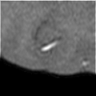

cam_0


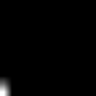

cam_1


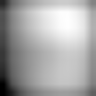

crf_la_0


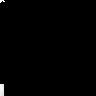

crf_la_1


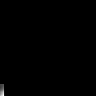

crf_la_2


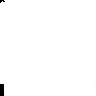

tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 

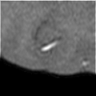

cam_0


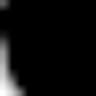

cam_1


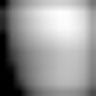

crf_la_0


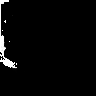

crf_la_1


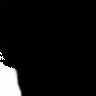

crf_la_2


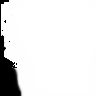

tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 

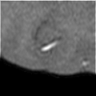

cam_0


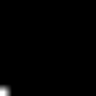

cam_1


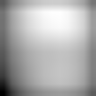

crf_la_0


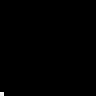

crf_la_1


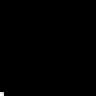

crf_la_2


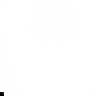

tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 

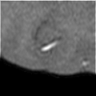

cam_0


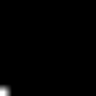

cam_1


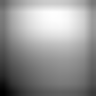

crf_la_0


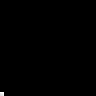

crf_la_1


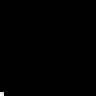

crf_la_2


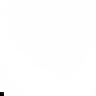

tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 

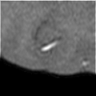

cam_0


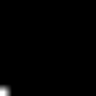

cam_1


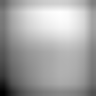

crf_la_0


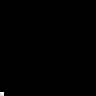

crf_la_1


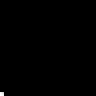

crf_la_2


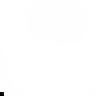

tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 

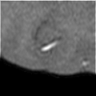

cam_0


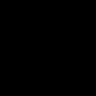

cam_1


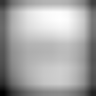

crf_la_0


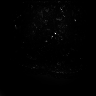

crf_la_1


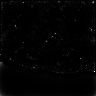

crf_la_2


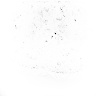

tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 

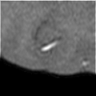

cam_0


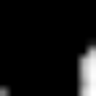

cam_1


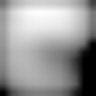

crf_la_0


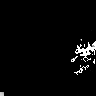

crf_la_1


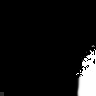

crf_la_2


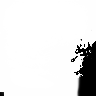

tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 

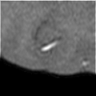

cam_0


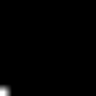

cam_1


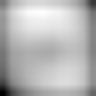

crf_la_0


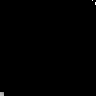

crf_la_1


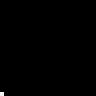

crf_la_2


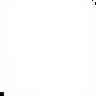

tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 

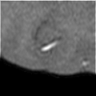

cam_0


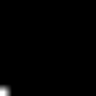

cam_1


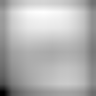

crf_la_0


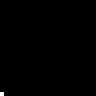

crf_la_1


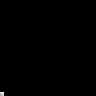

crf_la_2


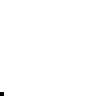

tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 

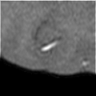

cam_0


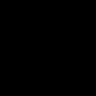

cam_1


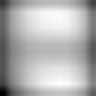

crf_la_0


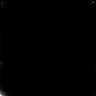

crf_la_1


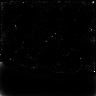

crf_la_2


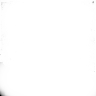

tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 

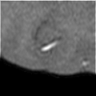

cam_0


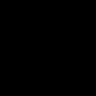

cam_1


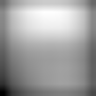

crf_la_0


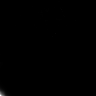

crf_la_1


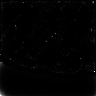

crf_la_2


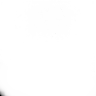

tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 

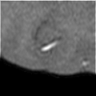

cam_0


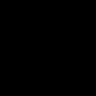

cam_1


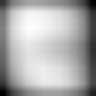

crf_la_0


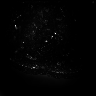

crf_la_1


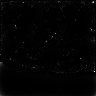

crf_la_2


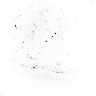

tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 

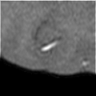

cam_0


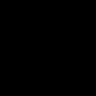

cam_1


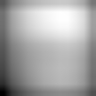

crf_la_0


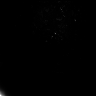

crf_la_1


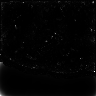

crf_la_2


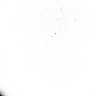

tensor([1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 

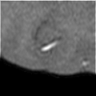

cam_0


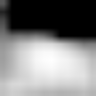

cam_1


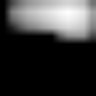

crf_la_0


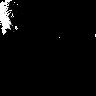

crf_la_1


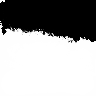

crf_la_2


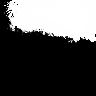

tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 

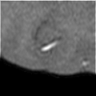

cam_0


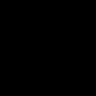

cam_1


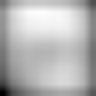

crf_la_0


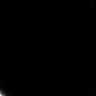

crf_la_1


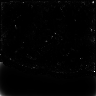

crf_la_2


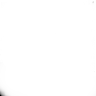

tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 

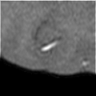

cam_0


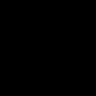

cam_1


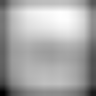

crf_la_0


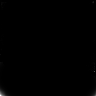

crf_la_1


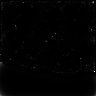

crf_la_2


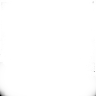

tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 

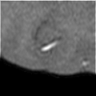

cam_0


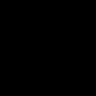

cam_1


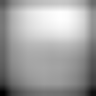

crf_la_0


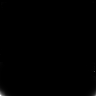

crf_la_1


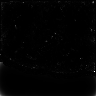

crf_la_2


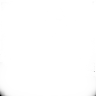

tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 

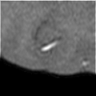

cam_0


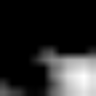

cam_1


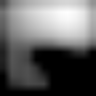

crf_la_0


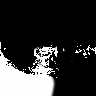

crf_la_1


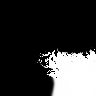

crf_la_2


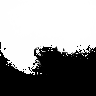

tensor([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 

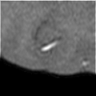

cam_0


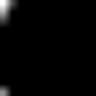

cam_1


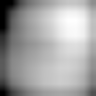

crf_la_0


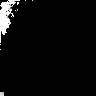

crf_la_1


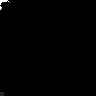

crf_la_2


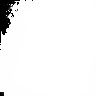

tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 

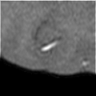

cam_0


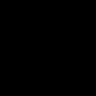

cam_1


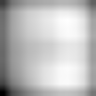

crf_la_0


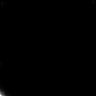

crf_la_1


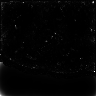

crf_la_2


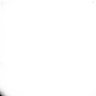

tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 

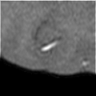

cam_0


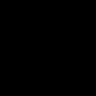

cam_1


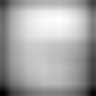

crf_la_0


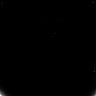

crf_la_1


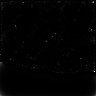

crf_la_2


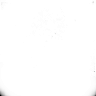

tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 

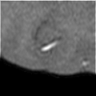

cam_0


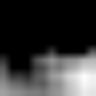

cam_1


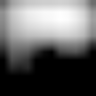

crf_la_0


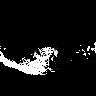

crf_la_1


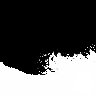

crf_la_2


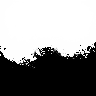

tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 

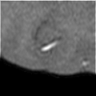

cam_0


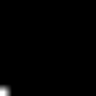

cam_1


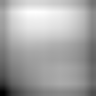

crf_la_0


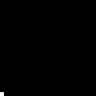

crf_la_1


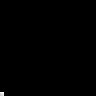

crf_la_2


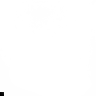

tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 

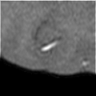

cam_0


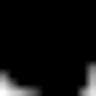

cam_1


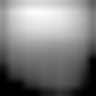

crf_la_0


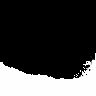

crf_la_1


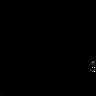

crf_la_2


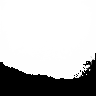

tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 

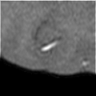

cam_0


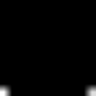

cam_1


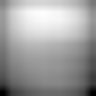

crf_la_0


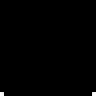

crf_la_1


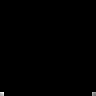

crf_la_2


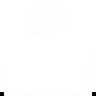

tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 

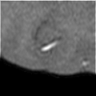

cam_0


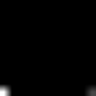

cam_1


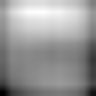

crf_la_0


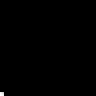

crf_la_1


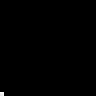

crf_la_2


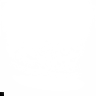

tensor([0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 

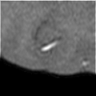

cam_0


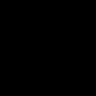

cam_1


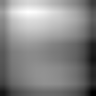

crf_la_0


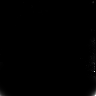

crf_la_1


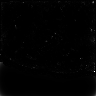

crf_la_2


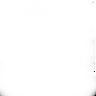

tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 

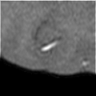

cam_0


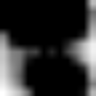

cam_1


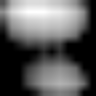

crf_la_0


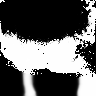

crf_la_1


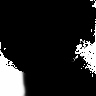

crf_la_2


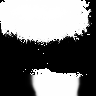

tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 

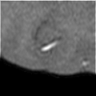

cam_0


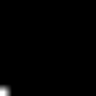

cam_1


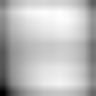

crf_la_0


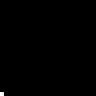

crf_la_1


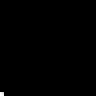

crf_la_2


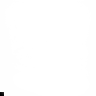

tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 

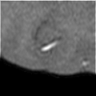

cam_0


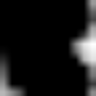

cam_1


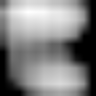

crf_la_0


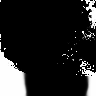

crf_la_1


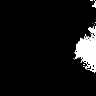

crf_la_2


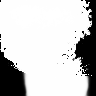

tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 

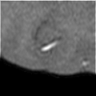

cam_0


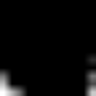

cam_1


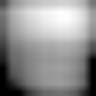

crf_la_0


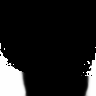

crf_la_1


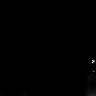

crf_la_2


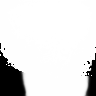

tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 

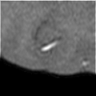

cam_0


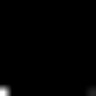

cam_1


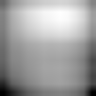

crf_la_0


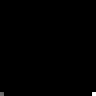

crf_la_1


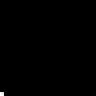

crf_la_2


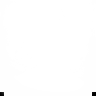

tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 

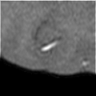

cam_0


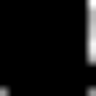

cam_1


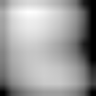

crf_la_0


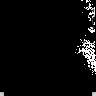

crf_la_1


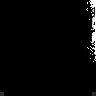

crf_la_2


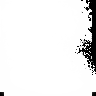

tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 

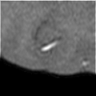

cam_0


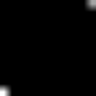

cam_1


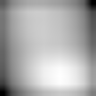

crf_la_0


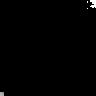

crf_la_1


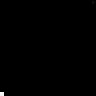

crf_la_2


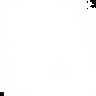

tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 

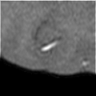

cam_0


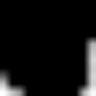

cam_1


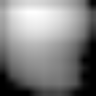

crf_la_0


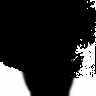

crf_la_1


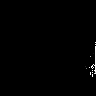

crf_la_2


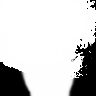

tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 

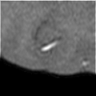

cam_0


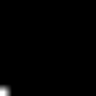

cam_1


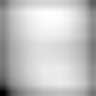

crf_la_0


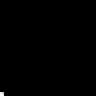

crf_la_1


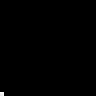

crf_la_2


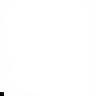

tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 

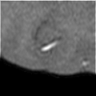

cam_0


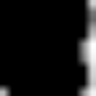

cam_1


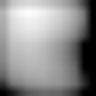

crf_la_0


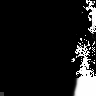

crf_la_1


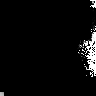

crf_la_2


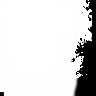

tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 

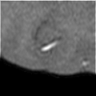

cam_0


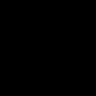

cam_1


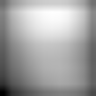

crf_la_0


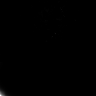

crf_la_1


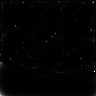

crf_la_2


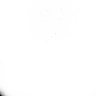

tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 

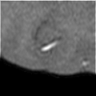

cam_0


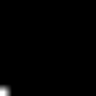

cam_1


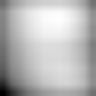

crf_la_0


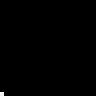

crf_la_1


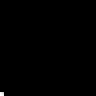

crf_la_2


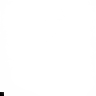

tensor([0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 

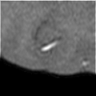

cam_0


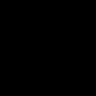

cam_1


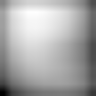

crf_la_0


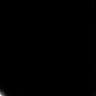

crf_la_1


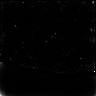

crf_la_2


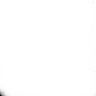

tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 

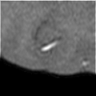

cam_0


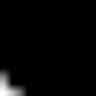

cam_1


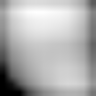

crf_la_0


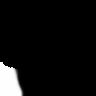

crf_la_1


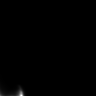

crf_la_2


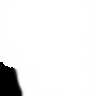

tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 

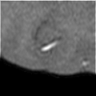

cam_0


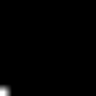

cam_1


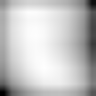

crf_la_0


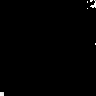

crf_la_1


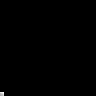

crf_la_2


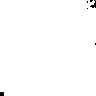

tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 

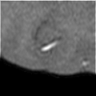

cam_0


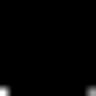

cam_1


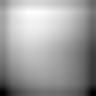

crf_la_0


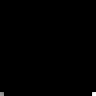

crf_la_1


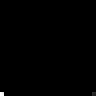

crf_la_2


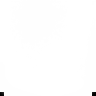

tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 

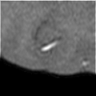

cam_0


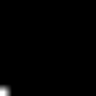

cam_1


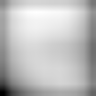

crf_la_0


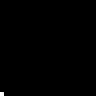

crf_la_1


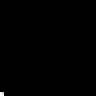

crf_la_2


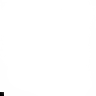

tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 

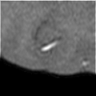

cam_0


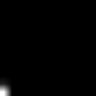

cam_1


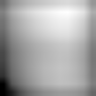

crf_la_0


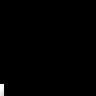

crf_la_1


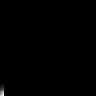

crf_la_2


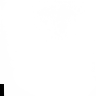

tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 

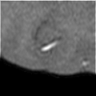

cam_0


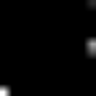

cam_1


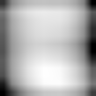

crf_la_0


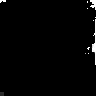

crf_la_1


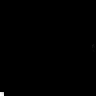

crf_la_2


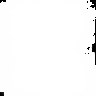

tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 

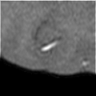

cam_0


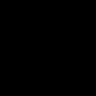

cam_1


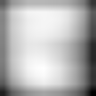

crf_la_0


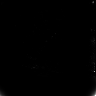

crf_la_1


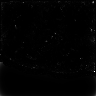

crf_la_2


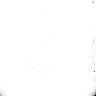

tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 

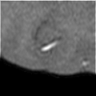

cam_0


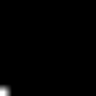

cam_1


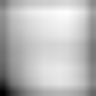

crf_la_0


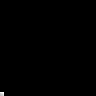

crf_la_1


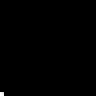

crf_la_2


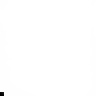

tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 

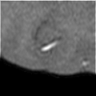

cam_0


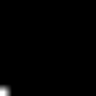

cam_1


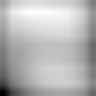

crf_la_0


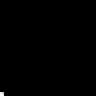

crf_la_1


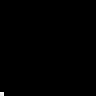

crf_la_2


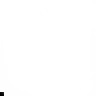

tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 

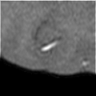

cam_0


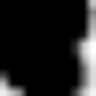

cam_1


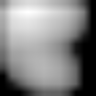

crf_la_0


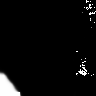

crf_la_1


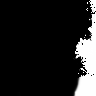

crf_la_2


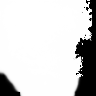

tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 

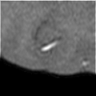

cam_0


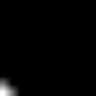

cam_1


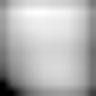

crf_la_0


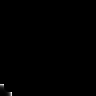

crf_la_1


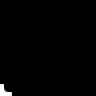

crf_la_2


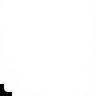

tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 

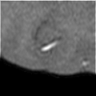

cam_0


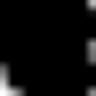

cam_1


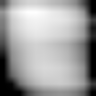

crf_la_0


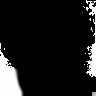

crf_la_1


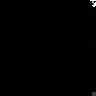

crf_la_2


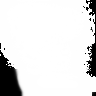

tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 

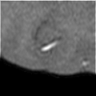

cam_0


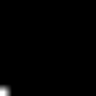

cam_1


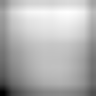

crf_la_0


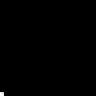

crf_la_1


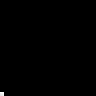

crf_la_2


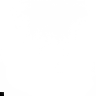

tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 

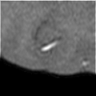

cam_0


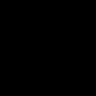

cam_1


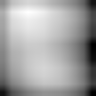

crf_la_0


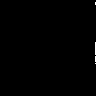

crf_la_1


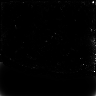

crf_la_2


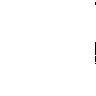

tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 

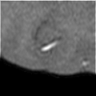

cam_0


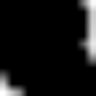

cam_1


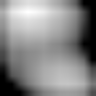

crf_la_0


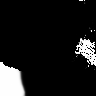

crf_la_1


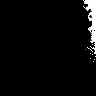

crf_la_2


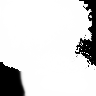

tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 

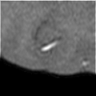

cam_0


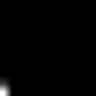

cam_1


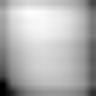

crf_la_0


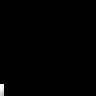

crf_la_1


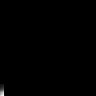

crf_la_2


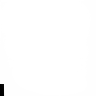

tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 

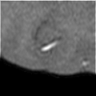

cam_0


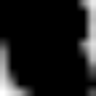

cam_1


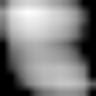

crf_la_0


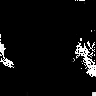

crf_la_1


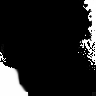

crf_la_2


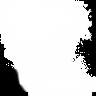

tensor([0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

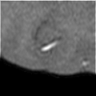

cam_0


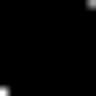

cam_1


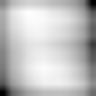

crf_la_0


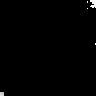

crf_la_1


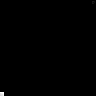

crf_la_2


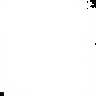

tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 

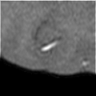

cam_0


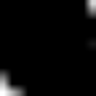

cam_1


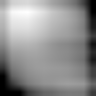

crf_la_0


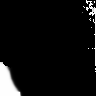

crf_la_1


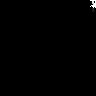

crf_la_2


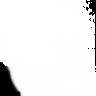

tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 

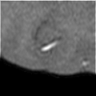

cam_0


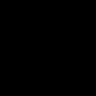

cam_1


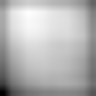

crf_la_0


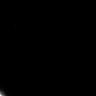

crf_la_1


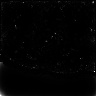

crf_la_2


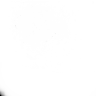

tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 

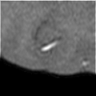

cam_0


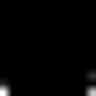

cam_1


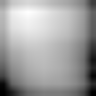

crf_la_0


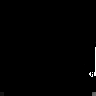

crf_la_1


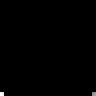

crf_la_2


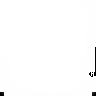

tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 

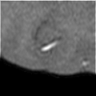

cam_0


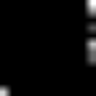

cam_1


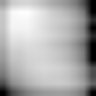

crf_la_0


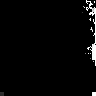

crf_la_1


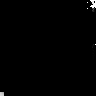

crf_la_2


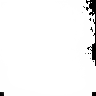

tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 

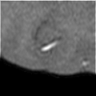

cam_0


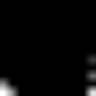

cam_1


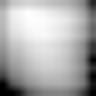

crf_la_0


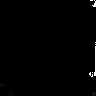

crf_la_1


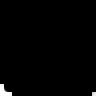

crf_la_2


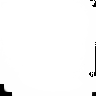

tensor([1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 

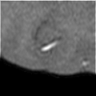

cam_0


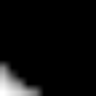

cam_1


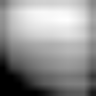

crf_la_0


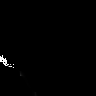

crf_la_1


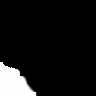

crf_la_2


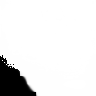

tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 

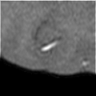

cam_0


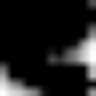

cam_1


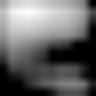

crf_la_0


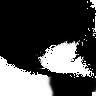

crf_la_1


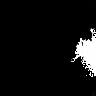

crf_la_2


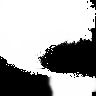

tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 

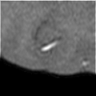

cam_0


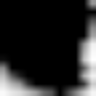

cam_1


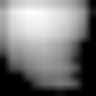

crf_la_0


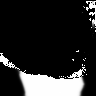

crf_la_1


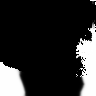

crf_la_2


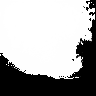

tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 

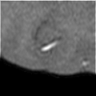

cam_0


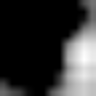

cam_1


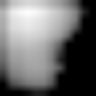

crf_la_0


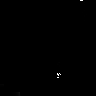

crf_la_1


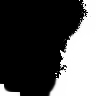

crf_la_2


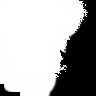

tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 

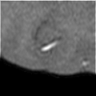

cam_0


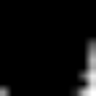

cam_1


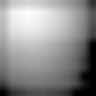

crf_la_0


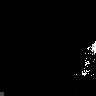

crf_la_1


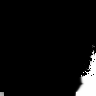

crf_la_2


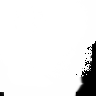

tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 

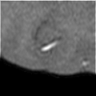

cam_0


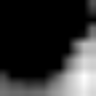

cam_1


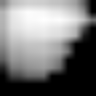

crf_la_0


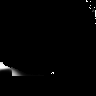

crf_la_1


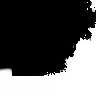

crf_la_2


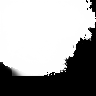

tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 

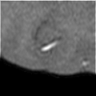

cam_0


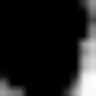

cam_1


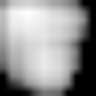

crf_la_0


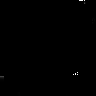

crf_la_1


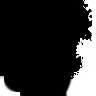

crf_la_2


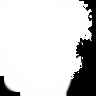

tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 

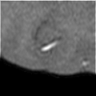

cam_0


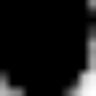

cam_1


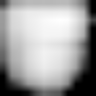

crf_la_0


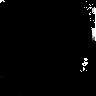

crf_la_1


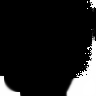

crf_la_2


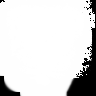

tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 

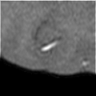

cam_0


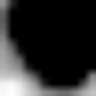

cam_1


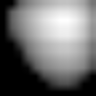

crf_la_0


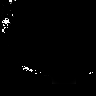

crf_la_1


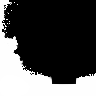

crf_la_2


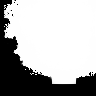

tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 

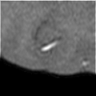

cam_0


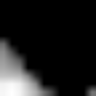

cam_1


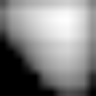

crf_la_0


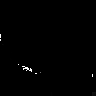

crf_la_1


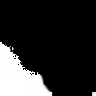

crf_la_2


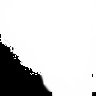

tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 

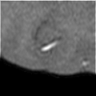

cam_0


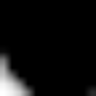

cam_1


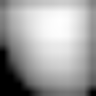

crf_la_0


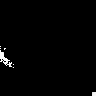

crf_la_1


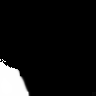

crf_la_2


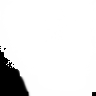

tensor([1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 

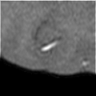

cam_0


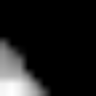

cam_1


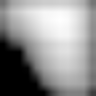

crf_la_0


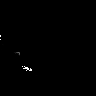

crf_la_1


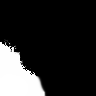

crf_la_2


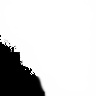

tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 

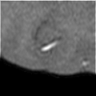

cam_0


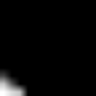

cam_1


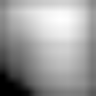

crf_la_0


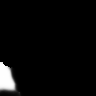

crf_la_1


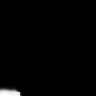

crf_la_2


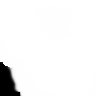

tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 

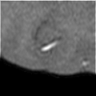

cam_0


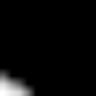

cam_1


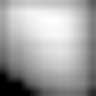

crf_la_0


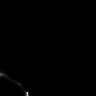

crf_la_1


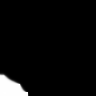

crf_la_2


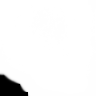

tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 

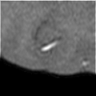

cam_0


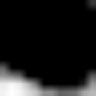

cam_1


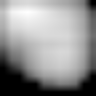

crf_la_0


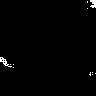

crf_la_1


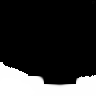

crf_la_2


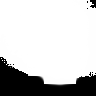

tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 

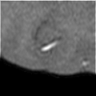

cam_0


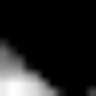

cam_1


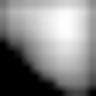

crf_la_0


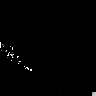

crf_la_1


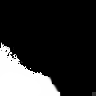

crf_la_2


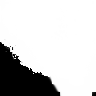

tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 

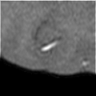

cam_0


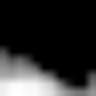

cam_1


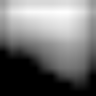

crf_la_0


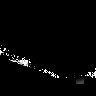

crf_la_1


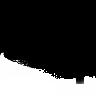

crf_la_2


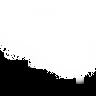

tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 

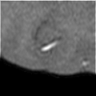

cam_0


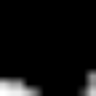

cam_1


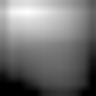

crf_la_0


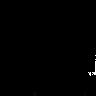

crf_la_1


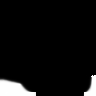

crf_la_2


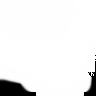

tensor([0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 

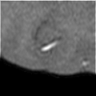

cam_0


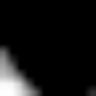

cam_1


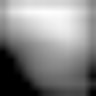

crf_la_0


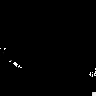

crf_la_1


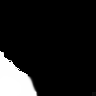

crf_la_2


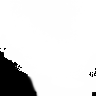

tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 

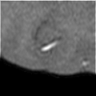

cam_0


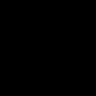

cam_1


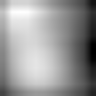

crf_la_0


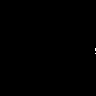

crf_la_1


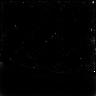

crf_la_2


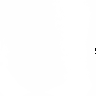

tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 

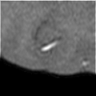

cam_0


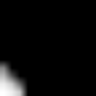

cam_1


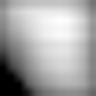

crf_la_0


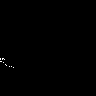

crf_la_1


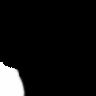

crf_la_2


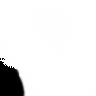

tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 

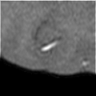

cam_0


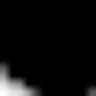

cam_1


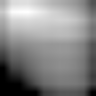

crf_la_0


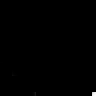

crf_la_1


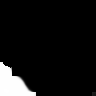

crf_la_2


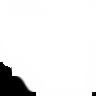

tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 

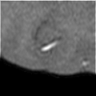

cam_0


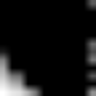

cam_1


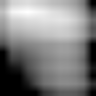

crf_la_0


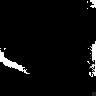

crf_la_1


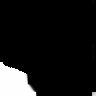

crf_la_2


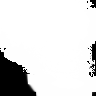

tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 

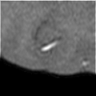

cam_0


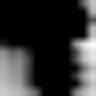

cam_1


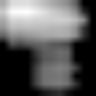

crf_la_0


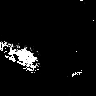

crf_la_1


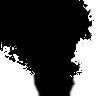

crf_la_2


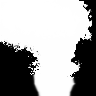

tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 

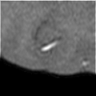

cam_0


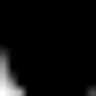

cam_1


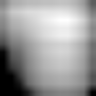

crf_la_0


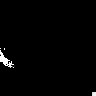

crf_la_1


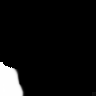

crf_la_2


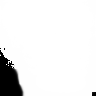

tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 

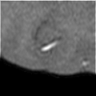

cam_0


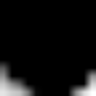

cam_1


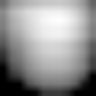

crf_la_0


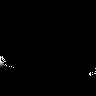

crf_la_1


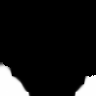

crf_la_2


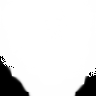

tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 

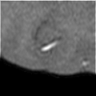

cam_0


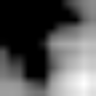

cam_1


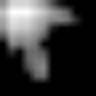

crf_la_0


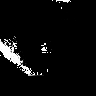

crf_la_1


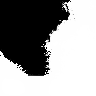

crf_la_2


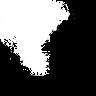

tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 

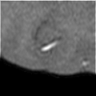

cam_0


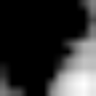

cam_1


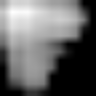

crf_la_0


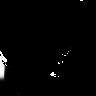

crf_la_1


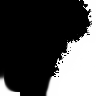

crf_la_2


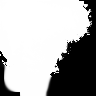

tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 

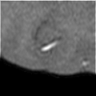

cam_0


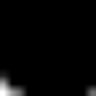

cam_1


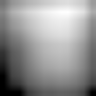

crf_la_0


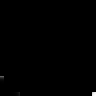

crf_la_1


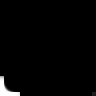

crf_la_2


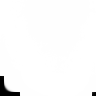

tensor([1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 

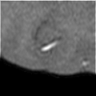

cam_0


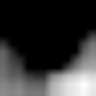

cam_1


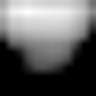

crf_la_0


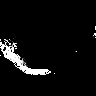

crf_la_1


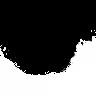

crf_la_2


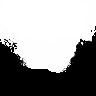

tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 

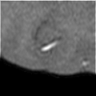

cam_0


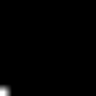

cam_1


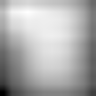

crf_la_0


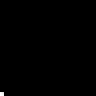

crf_la_1


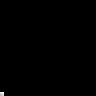

crf_la_2


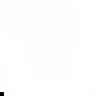

tensor([0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 

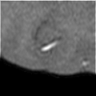

cam_0


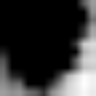

cam_1


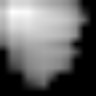

crf_la_0


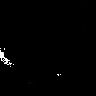

crf_la_1


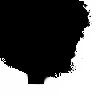

crf_la_2


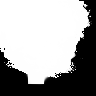

tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 

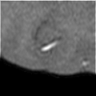

cam_0


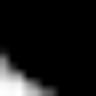

cam_1


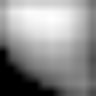

crf_la_0


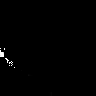

crf_la_1


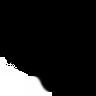

crf_la_2


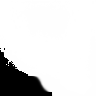

tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 

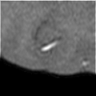

cam_0


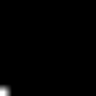

cam_1


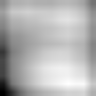

crf_la_0


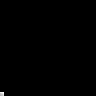

crf_la_1


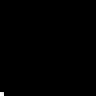

crf_la_2


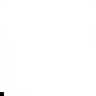

tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 

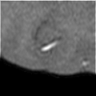

cam_0


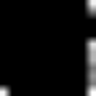

cam_1


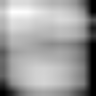

crf_la_0


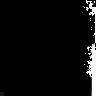

crf_la_1


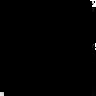

crf_la_2


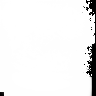

tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 

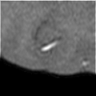

cam_0


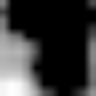

cam_1


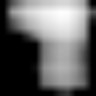

crf_la_0


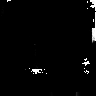

crf_la_1


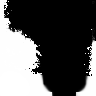

crf_la_2


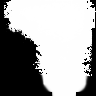

tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 

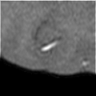

cam_0


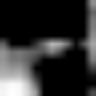

cam_1


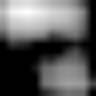

crf_la_0


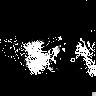

crf_la_1


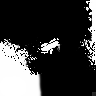

crf_la_2


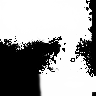

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 

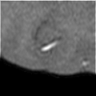

cam_0


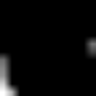

cam_1


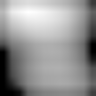

crf_la_0


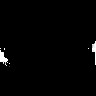

crf_la_1


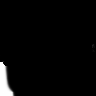

crf_la_2


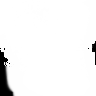

tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 

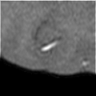

cam_0


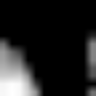

cam_1


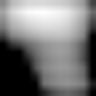

crf_la_0


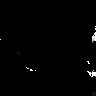

crf_la_1


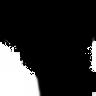

crf_la_2


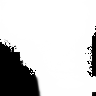

tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 

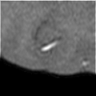

cam_0


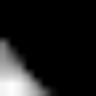

cam_1


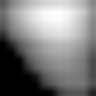

crf_la_0


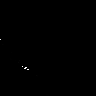

crf_la_1


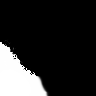

crf_la_2


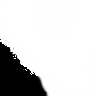

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 

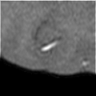

cam_0


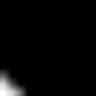

cam_1


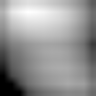

crf_la_0


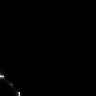

crf_la_1


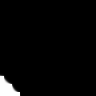

crf_la_2


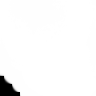

tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 

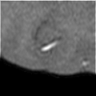

cam_0


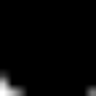

cam_1


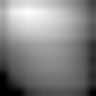

crf_la_0


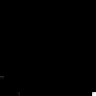

crf_la_1


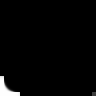

crf_la_2


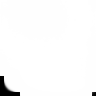

tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 

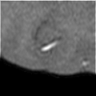

cam_0


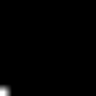

cam_1


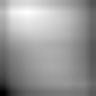

crf_la_0


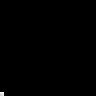

crf_la_1


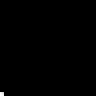

crf_la_2


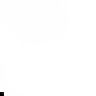

tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 

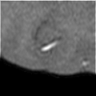

cam_0


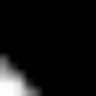

cam_1


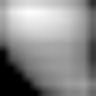

crf_la_0


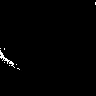

crf_la_1


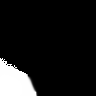

crf_la_2


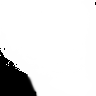

tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 

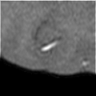

cam_0


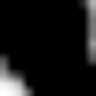

cam_1


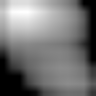

crf_la_0


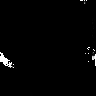

crf_la_1


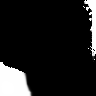

crf_la_2


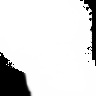

tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 

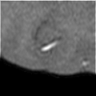

cam_0


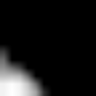

cam_1


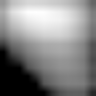

crf_la_0


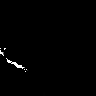

crf_la_1


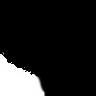

crf_la_2


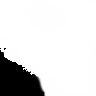

tensor([1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 

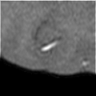

cam_0


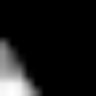

cam_1


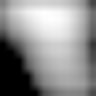

crf_la_0


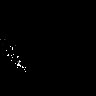

crf_la_1


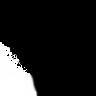

crf_la_2


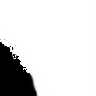

tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 

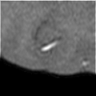

cam_0


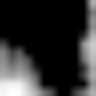

cam_1


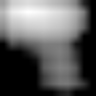

crf_la_0


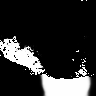

crf_la_1


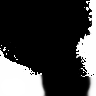

crf_la_2


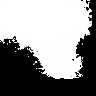

tensor([1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 

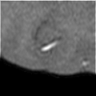

cam_0


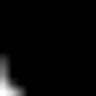

cam_1


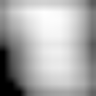

crf_la_0


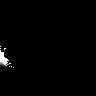

crf_la_1


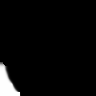

crf_la_2


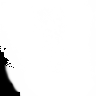

tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 

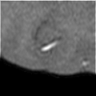

cam_0


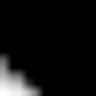

cam_1


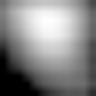

crf_la_0


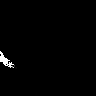

crf_la_1


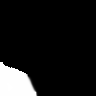

crf_la_2


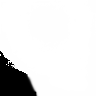

tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 

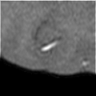

cam_0


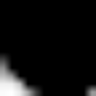

cam_1


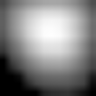

crf_la_0


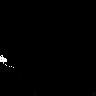

crf_la_1


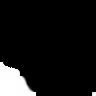

crf_la_2


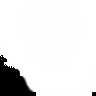

tensor([1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 

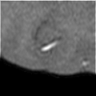

cam_0


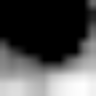

cam_1


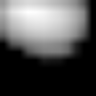

crf_la_0


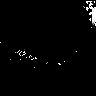

crf_la_1


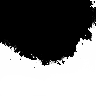

crf_la_2


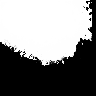

tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 

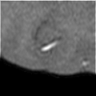

cam_0


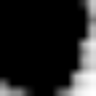

cam_1


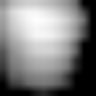

crf_la_0


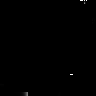

crf_la_1


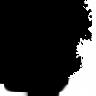

crf_la_2


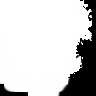

tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 

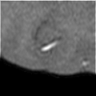

cam_0


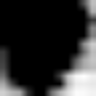

cam_1


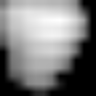

crf_la_0


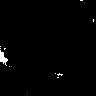

crf_la_1


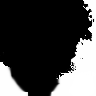

crf_la_2


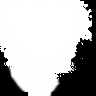

tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 

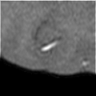

cam_0


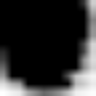

cam_1


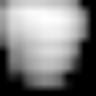

crf_la_0


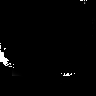

crf_la_1


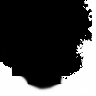

crf_la_2


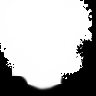

tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 

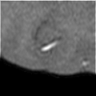

cam_0


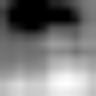

cam_1


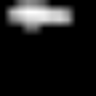

crf_la_0


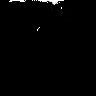

crf_la_1


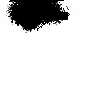

crf_la_2


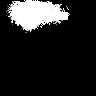

tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 

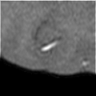

cam_0


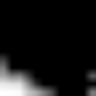

cam_1


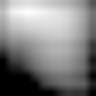

crf_la_0


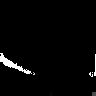

crf_la_1


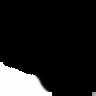

crf_la_2


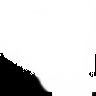

tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 

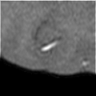

cam_0


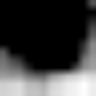

cam_1


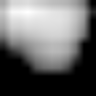

crf_la_0


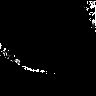

crf_la_1


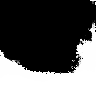

crf_la_2


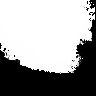

tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 

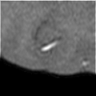

cam_0


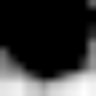

cam_1


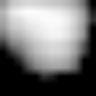

crf_la_0


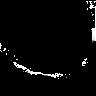

crf_la_1


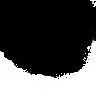

crf_la_2


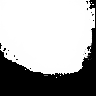

tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 

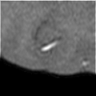

cam_0


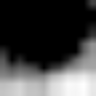

cam_1


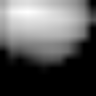

crf_la_0


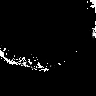

crf_la_1


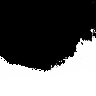

crf_la_2


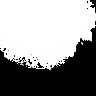

tensor([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 

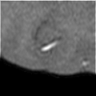

cam_0


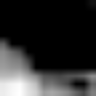

cam_1


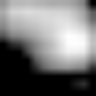

crf_la_0


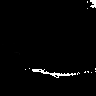

crf_la_1


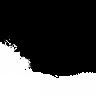

crf_la_2


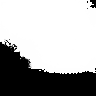

tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 

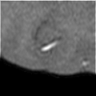

cam_0


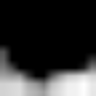

cam_1


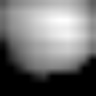

crf_la_0


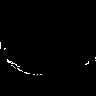

crf_la_1


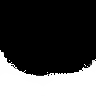

crf_la_2


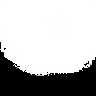

tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 

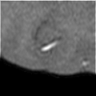

cam_0


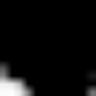

cam_1


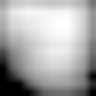

crf_la_0


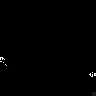

crf_la_1


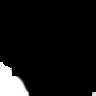

crf_la_2


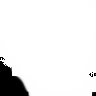

tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 

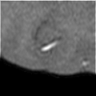

cam_0


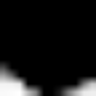

cam_1


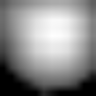

crf_la_0


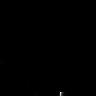

crf_la_1


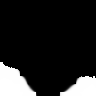

crf_la_2


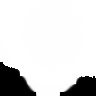

tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 

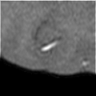

cam_0


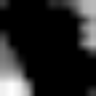

cam_1


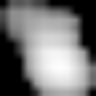

crf_la_0


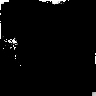

crf_la_1


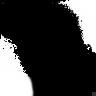

crf_la_2


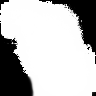

tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 

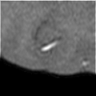

cam_0


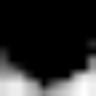

cam_1


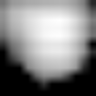

crf_la_0


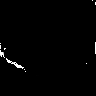

crf_la_1


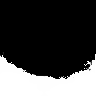

crf_la_2


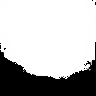

tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 

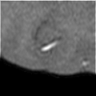

cam_0


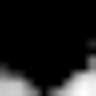

cam_1


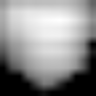

crf_la_0


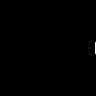

crf_la_1


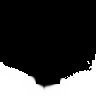

crf_la_2


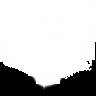

tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 

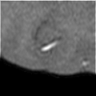

cam_0


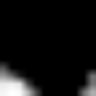

cam_1


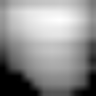

crf_la_0


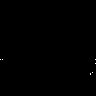

crf_la_1


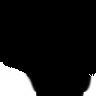

crf_la_2


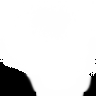

tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

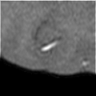

cam_0


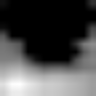

cam_1


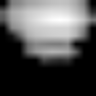

crf_la_0


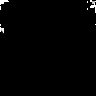

crf_la_1


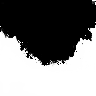

crf_la_2


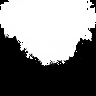

tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 

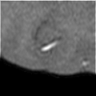

cam_0


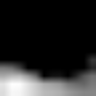

cam_1


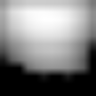

crf_la_0


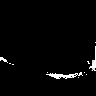

crf_la_1


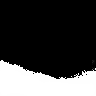

crf_la_2


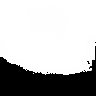

tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 

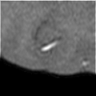

cam_0


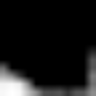

cam_1


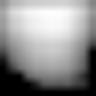

crf_la_0


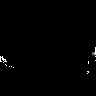

crf_la_1


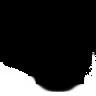

crf_la_2


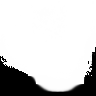

tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 

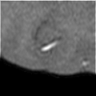

cam_0


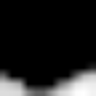

cam_1


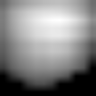

crf_la_0


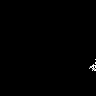

crf_la_1


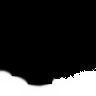

crf_la_2


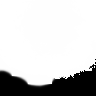

tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 

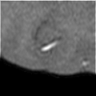

cam_0


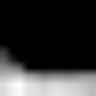

cam_1


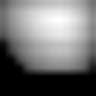

crf_la_0


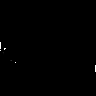

crf_la_1


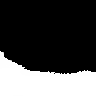

crf_la_2


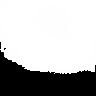

tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 

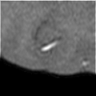

cam_0


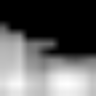

cam_1


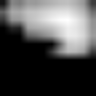

crf_la_0


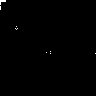

crf_la_1


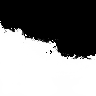

crf_la_2


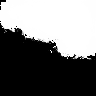

tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 

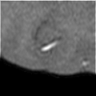

cam_0


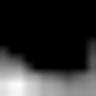

cam_1


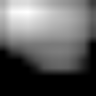

crf_la_0


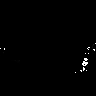

crf_la_1


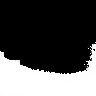

crf_la_2


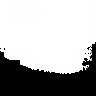

tensor([0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 

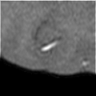

cam_0


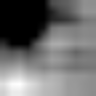

cam_1


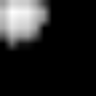

crf_la_0


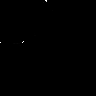

crf_la_1


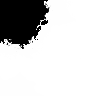

crf_la_2


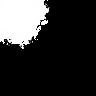

tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 

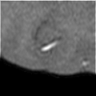

cam_0


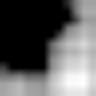

cam_1


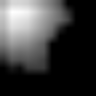

crf_la_0


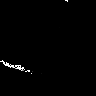

crf_la_1


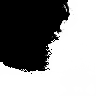

crf_la_2


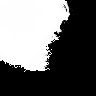

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 

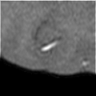

cam_0


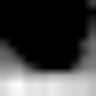

cam_1


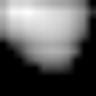

crf_la_0


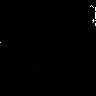

crf_la_1


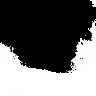

crf_la_2


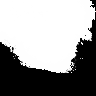

tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 

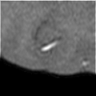

cam_0


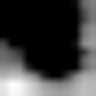

cam_1


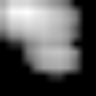

crf_la_0


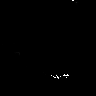

crf_la_1


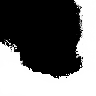

crf_la_2


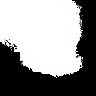

tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 

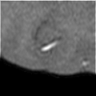

cam_0


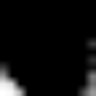

cam_1


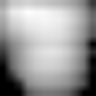

crf_la_0


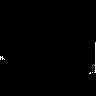

crf_la_1


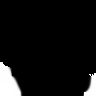

crf_la_2


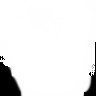

tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 

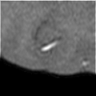

cam_0


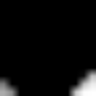

cam_1


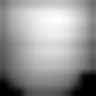

crf_la_0


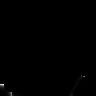

crf_la_1


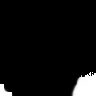

crf_la_2


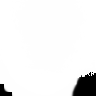

tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 

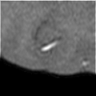

cam_0


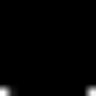

cam_1


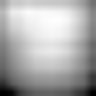

crf_la_0


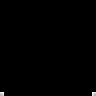

crf_la_1


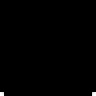

crf_la_2


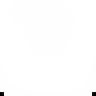

tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 

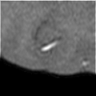

cam_0


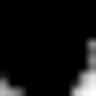

cam_1


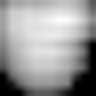

crf_la_0


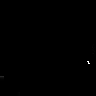

crf_la_1


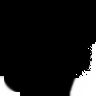

crf_la_2


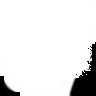

tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 

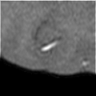

cam_0


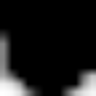

cam_1


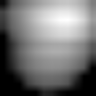

crf_la_0


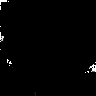

crf_la_1


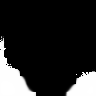

crf_la_2


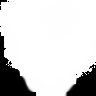

tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 

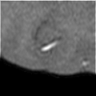

cam_0


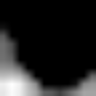

cam_1


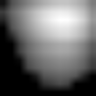

crf_la_0


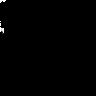

crf_la_1


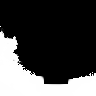

crf_la_2


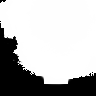

tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 

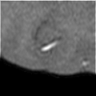

cam_0


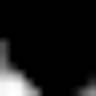

cam_1


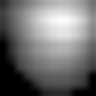

crf_la_0


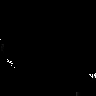

crf_la_1


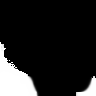

crf_la_2


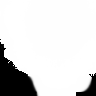

tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 

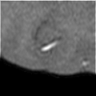

cam_0


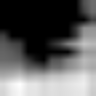

cam_1


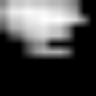

crf_la_0


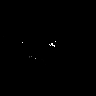

crf_la_1


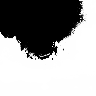

crf_la_2


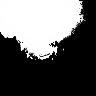

tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 

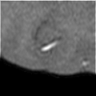

cam_0


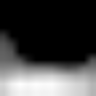

cam_1


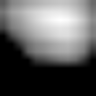

crf_la_0


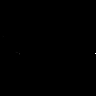

crf_la_1


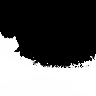

crf_la_2


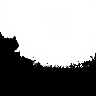

tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 

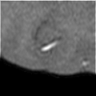

cam_0


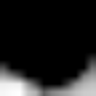

cam_1


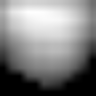

crf_la_0


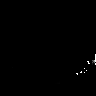

crf_la_1


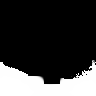

crf_la_2


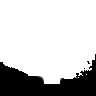

tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 

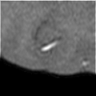

cam_0


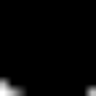

cam_1


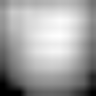

crf_la_0


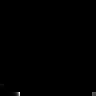

crf_la_1


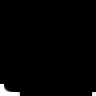

crf_la_2


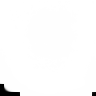

tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 

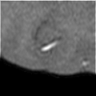

cam_0


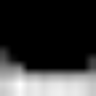

cam_1


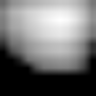

crf_la_0


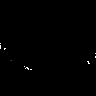

crf_la_1


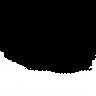

crf_la_2


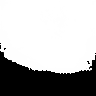

tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 

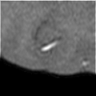

cam_0


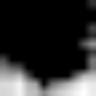

cam_1


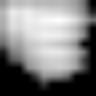

crf_la_0


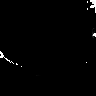

crf_la_1


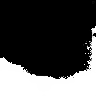

crf_la_2


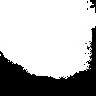

tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 

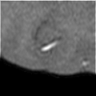

cam_0


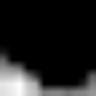

cam_1


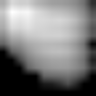

crf_la_0


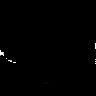

crf_la_1


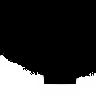

crf_la_2


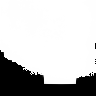

tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 

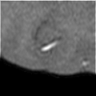

cam_0


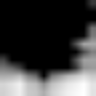

cam_1


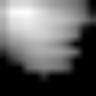

crf_la_0


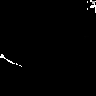

crf_la_1


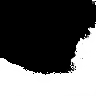

crf_la_2


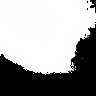

tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 

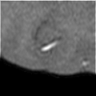

cam_0


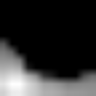

cam_1


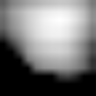

crf_la_0


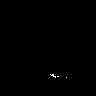

crf_la_1


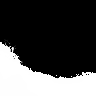

crf_la_2


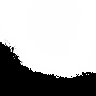

tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 

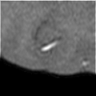

cam_0


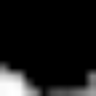

cam_1


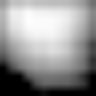

crf_la_0


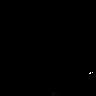

crf_la_1


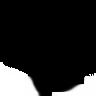

crf_la_2


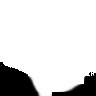

tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 

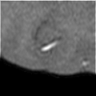

cam_0


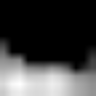

cam_1


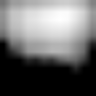

crf_la_0


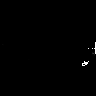

crf_la_1


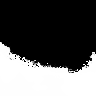

crf_la_2


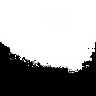

tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 

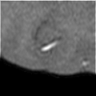

cam_0


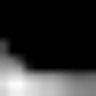

cam_1


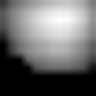

crf_la_0


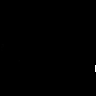

crf_la_1


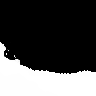

crf_la_2


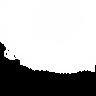

tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 

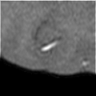

cam_0


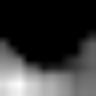

cam_1


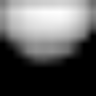

crf_la_0


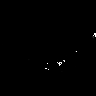

crf_la_1


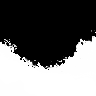

crf_la_2


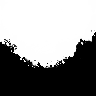

tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 

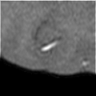

cam_0


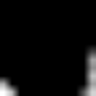

cam_1


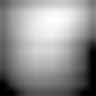

crf_la_0


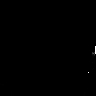

crf_la_1


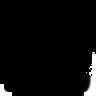

crf_la_2


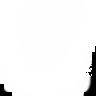

tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 

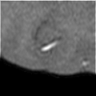

cam_0


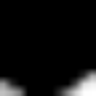

cam_1


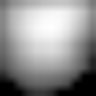

crf_la_0


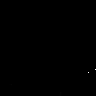

crf_la_1


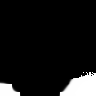

crf_la_2


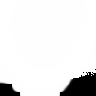

tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 

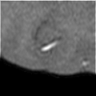

cam_0


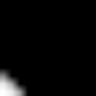

cam_1


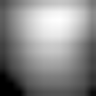

crf_la_0


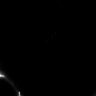

crf_la_1


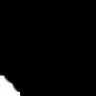

crf_la_2


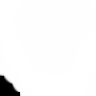

tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 

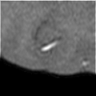

cam_0


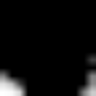

cam_1


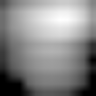

crf_la_0


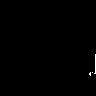

crf_la_1


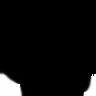

crf_la_2


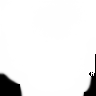

tensor([0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 

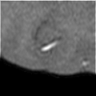

cam_0


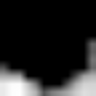

cam_1


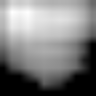

crf_la_0


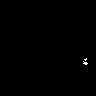

crf_la_1


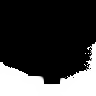

crf_la_2


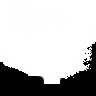

tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 

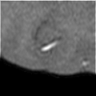

cam_0


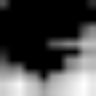

cam_1


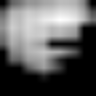

crf_la_0


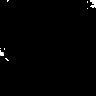

crf_la_1


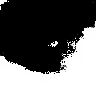

crf_la_2


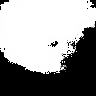

tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 

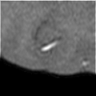

cam_0


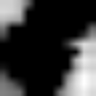

cam_1


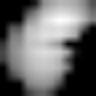

crf_la_0


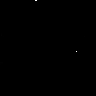

crf_la_1


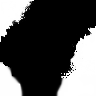

crf_la_2


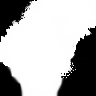

tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 

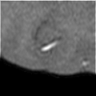

cam_0


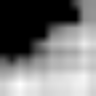

cam_1


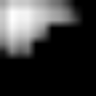

crf_la_0


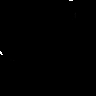

crf_la_1


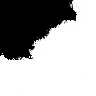

crf_la_2


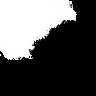

tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 

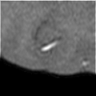

cam_0


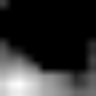

cam_1


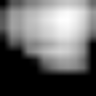

crf_la_0


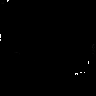

crf_la_1


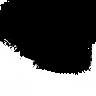

crf_la_2


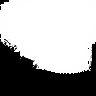

tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 

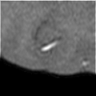

cam_0


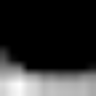

cam_1


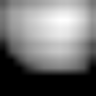

crf_la_0


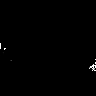

crf_la_1


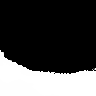

crf_la_2


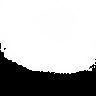

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 

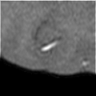

cam_0


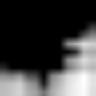

cam_1


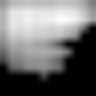

crf_la_0


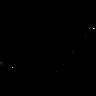

crf_la_1


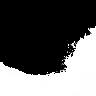

crf_la_2


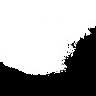

tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 

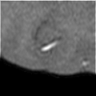

cam_0


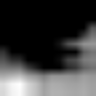

cam_1


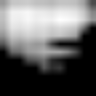

crf_la_0


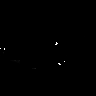

crf_la_1


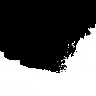

crf_la_2


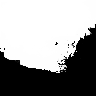

tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 

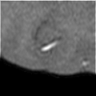

cam_0


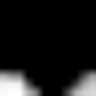

cam_1


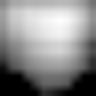

crf_la_0


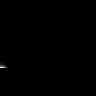

crf_la_1


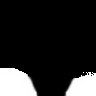

crf_la_2


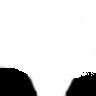

tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 

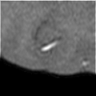

cam_0


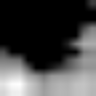

cam_1


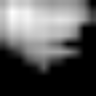

crf_la_0


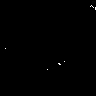

crf_la_1


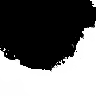

crf_la_2


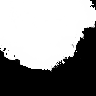

tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 

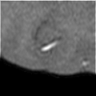

cam_0


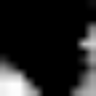

cam_1


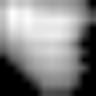

crf_la_0


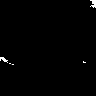

crf_la_1


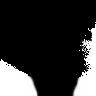

crf_la_2


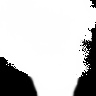

tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 

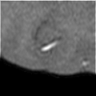

cam_0


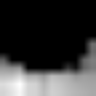

cam_1


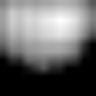

crf_la_0


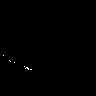

crf_la_1


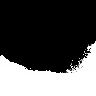

crf_la_2


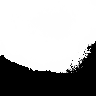

tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 

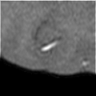

cam_0


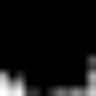

cam_1


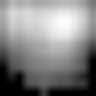

crf_la_0


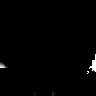

crf_la_1


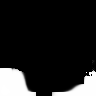

crf_la_2


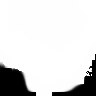

tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 

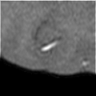

cam_0


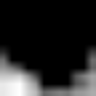

cam_1


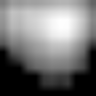

crf_la_0


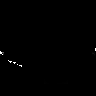

crf_la_1


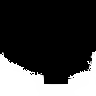

crf_la_2


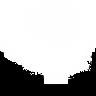

tensor([1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 

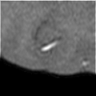

cam_0


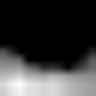

cam_1


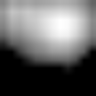

crf_la_0


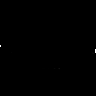

crf_la_1


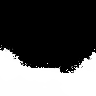

crf_la_2


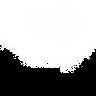

tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 

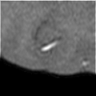

cam_0


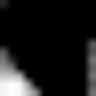

cam_1


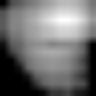

crf_la_0


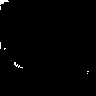

crf_la_1


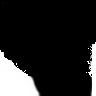

crf_la_2


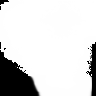

tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 

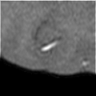

cam_0


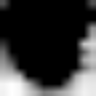

cam_1


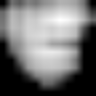

crf_la_0


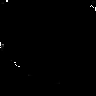

crf_la_1


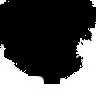

crf_la_2


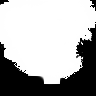

tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 

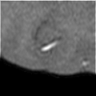

cam_0


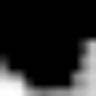

cam_1


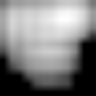

crf_la_0


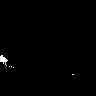

crf_la_1


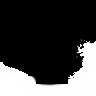

crf_la_2


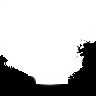

tensor([0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 

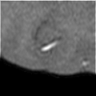

cam_0


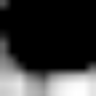

cam_1


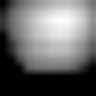

crf_la_0


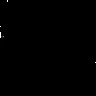

crf_la_1


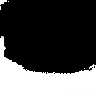

crf_la_2


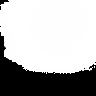

tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 

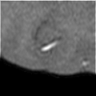

cam_0


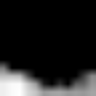

cam_1


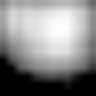

crf_la_0


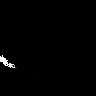

crf_la_1


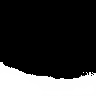

crf_la_2


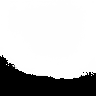

tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 

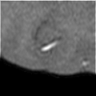

cam_0


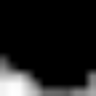

cam_1


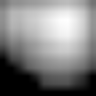

crf_la_0


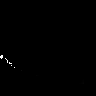

crf_la_1


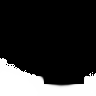

crf_la_2


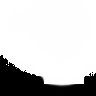

tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 

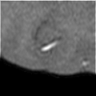

cam_0


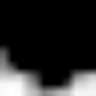

cam_1


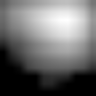

crf_la_0


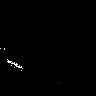

crf_la_1


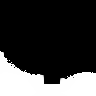

crf_la_2


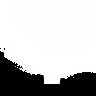

tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 

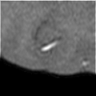

cam_0


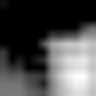

cam_1


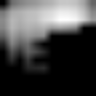

crf_la_0


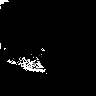

crf_la_1


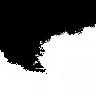

crf_la_2


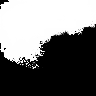

tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 

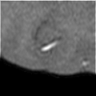

cam_0


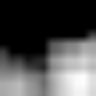

cam_1


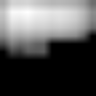

crf_la_0


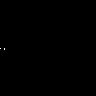

crf_la_1


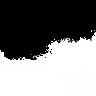

crf_la_2


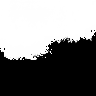

tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 

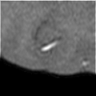

cam_0


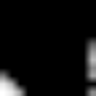

cam_1


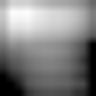

crf_la_0


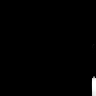

crf_la_1


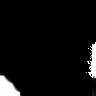

crf_la_2


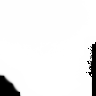

tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 

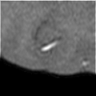

cam_0


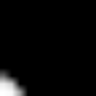

cam_1


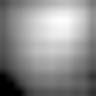

crf_la_0


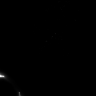

crf_la_1


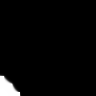

crf_la_2


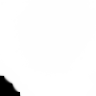

tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 

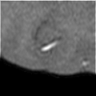

cam_0


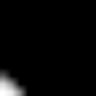

cam_1


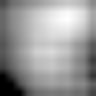

crf_la_0


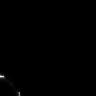

crf_la_1


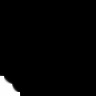

crf_la_2


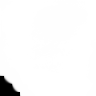

tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 

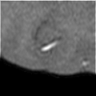

cam_0


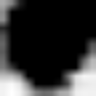

cam_1


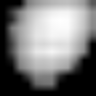

crf_la_0


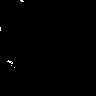

crf_la_1


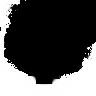

crf_la_2


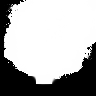

tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 

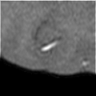

cam_0


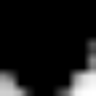

cam_1


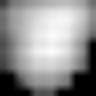

crf_la_0


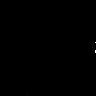

crf_la_1


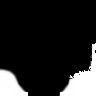

crf_la_2


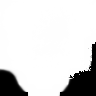

tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 

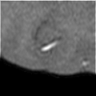

cam_0


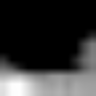

cam_1


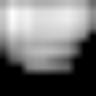

crf_la_0


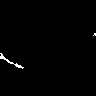

crf_la_1


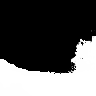

crf_la_2


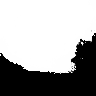

tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 

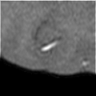

cam_0


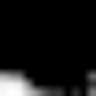

cam_1


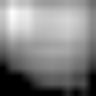

crf_la_0


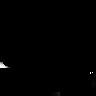

crf_la_1


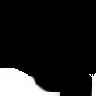

crf_la_2


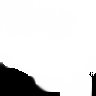

tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 

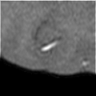

cam_0


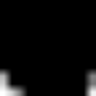

cam_1


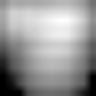

crf_la_0


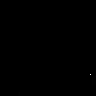

crf_la_1


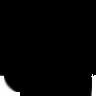

crf_la_2


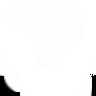

tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 

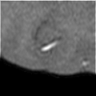

cam_0


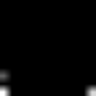

cam_1


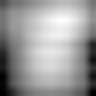

crf_la_0


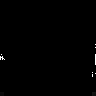

crf_la_1


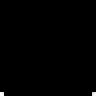

crf_la_2


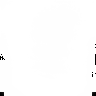

tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 

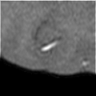

cam_0


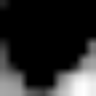

cam_1


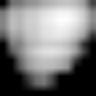

crf_la_0


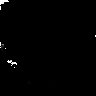

crf_la_1


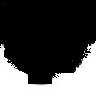

crf_la_2


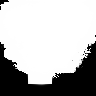

tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 

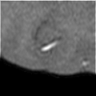

cam_0


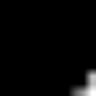

cam_1


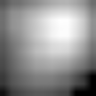

crf_la_0


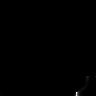

crf_la_1


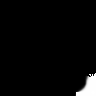

crf_la_2


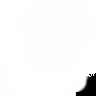

tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 

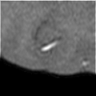

cam_0


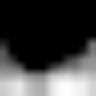

cam_1


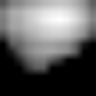

crf_la_0


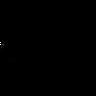

crf_la_1


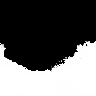

crf_la_2


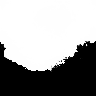

tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 

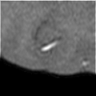

cam_0


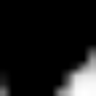

cam_1


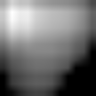

crf_la_0


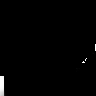

crf_la_1


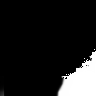

crf_la_2


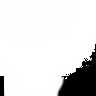

tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 

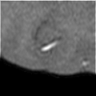

cam_0


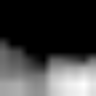

cam_1


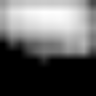

crf_la_0


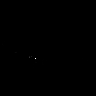

crf_la_1


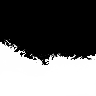

crf_la_2


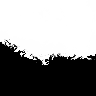

tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 

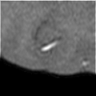

cam_0


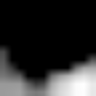

cam_1


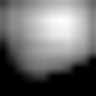

crf_la_0


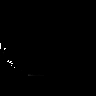

crf_la_1


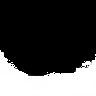

crf_la_2


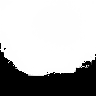

tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 

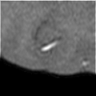

cam_0


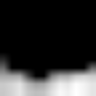

cam_1


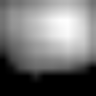

crf_la_0


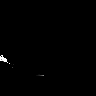

crf_la_1


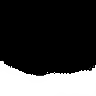

crf_la_2


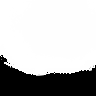

tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 

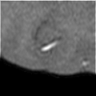

cam_0


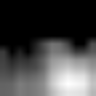

cam_1


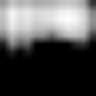

crf_la_0


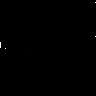

crf_la_1


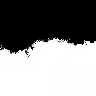

crf_la_2


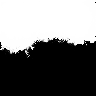

tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 

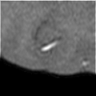

cam_0


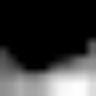

cam_1


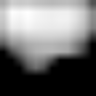

crf_la_0


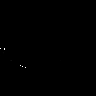

crf_la_1


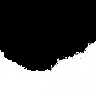

crf_la_2


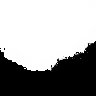

tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 

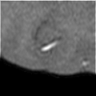

cam_0


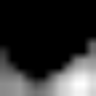

cam_1


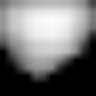

crf_la_0


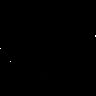

crf_la_1


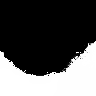

crf_la_2


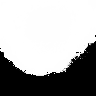

tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 

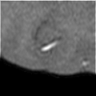

cam_0


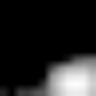

cam_1


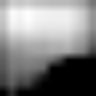

crf_la_0


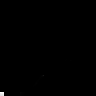

crf_la_1


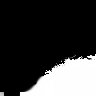

crf_la_2


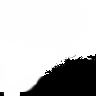

tensor([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 

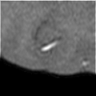

cam_0


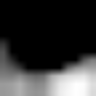

cam_1


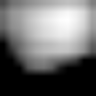

crf_la_0


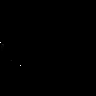

crf_la_1


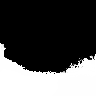

crf_la_2


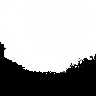

tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 

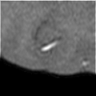

cam_0


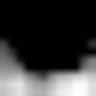

cam_1


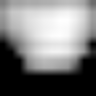

crf_la_0


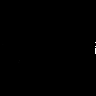

crf_la_1


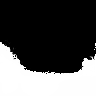

crf_la_2


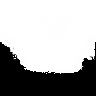

tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 

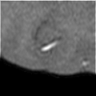

cam_0


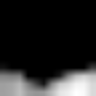

cam_1


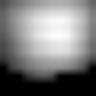

crf_la_0


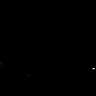

crf_la_1


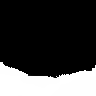

crf_la_2


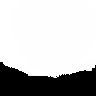

tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 

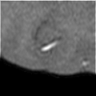

cam_0


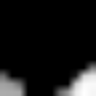

cam_1


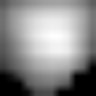

crf_la_0


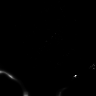

crf_la_1


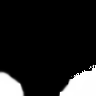

crf_la_2


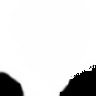

tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 

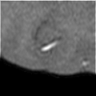

cam_0


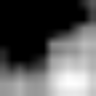

cam_1


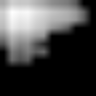

crf_la_0


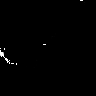

crf_la_1


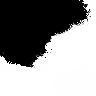

crf_la_2


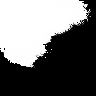

tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 

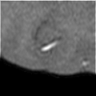

cam_0


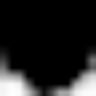

cam_1


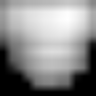

crf_la_0


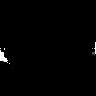

crf_la_1


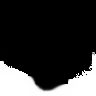

crf_la_2


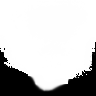

tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 

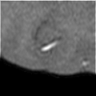

cam_0


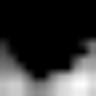

cam_1


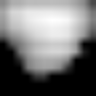

crf_la_0


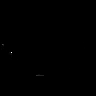

crf_la_1


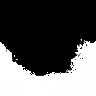

crf_la_2


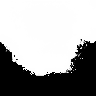

tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 

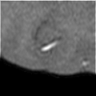

cam_0


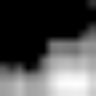

cam_1


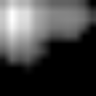

crf_la_0


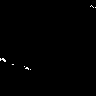

crf_la_1


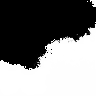

crf_la_2


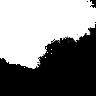

tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 

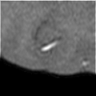

cam_0


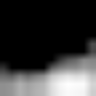

cam_1


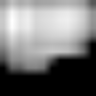

crf_la_0


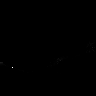

crf_la_1


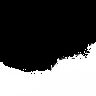

crf_la_2


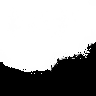

tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 

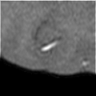

cam_0


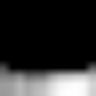

cam_1


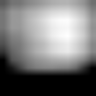

crf_la_0


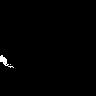

crf_la_1


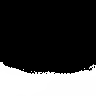

crf_la_2


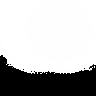

tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 

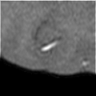

cam_0


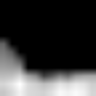

cam_1


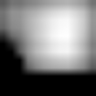

crf_la_0


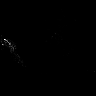

crf_la_1


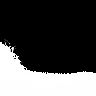

crf_la_2


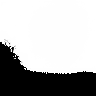

tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 

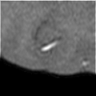

cam_0


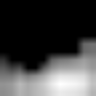

cam_1


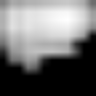

crf_la_0


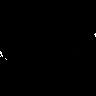

crf_la_1


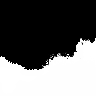

crf_la_2


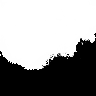

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 

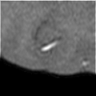

cam_0


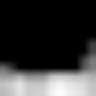

cam_1


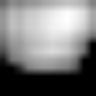

crf_la_0


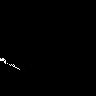

crf_la_1


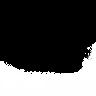

crf_la_2


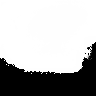

tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 

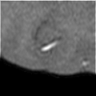

cam_0


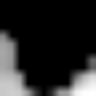

cam_1


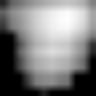

crf_la_0


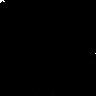

crf_la_1


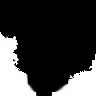

crf_la_2


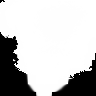

tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 

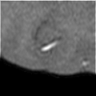

cam_0


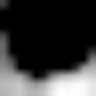

cam_1


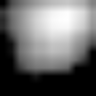

crf_la_0


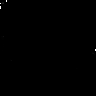

crf_la_1


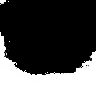

crf_la_2


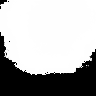

tensor([0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 

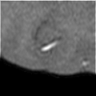

cam_0


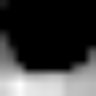

cam_1


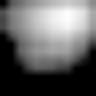

crf_la_0


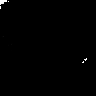

crf_la_1


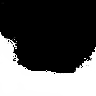

crf_la_2


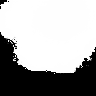

tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 

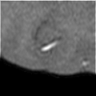

cam_0


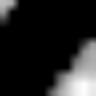

cam_1


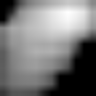

crf_la_0


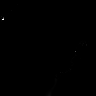

crf_la_1


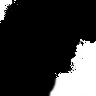

crf_la_2


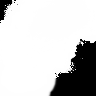

tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 

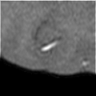

cam_0


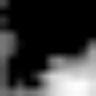

cam_1


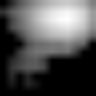

crf_la_0


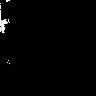

crf_la_1


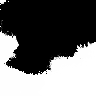

crf_la_2


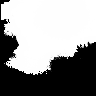

tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 

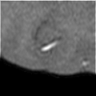

cam_0


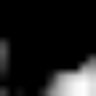

cam_1


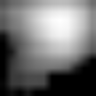

crf_la_0


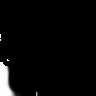

crf_la_1


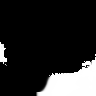

crf_la_2


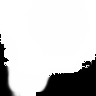

tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 

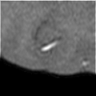

cam_0


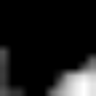

cam_1


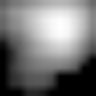

crf_la_0


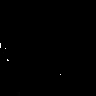

crf_la_1


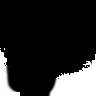

crf_la_2


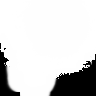

tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 

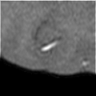

cam_0


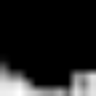

cam_1


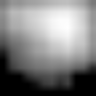

crf_la_0


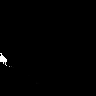

crf_la_1


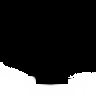

crf_la_2


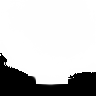

tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 

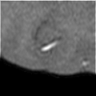

cam_0


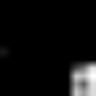

cam_1


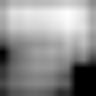

crf_la_0


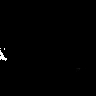

crf_la_1


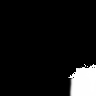

crf_la_2


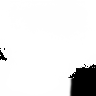

tensor([0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 

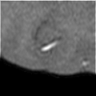

cam_0


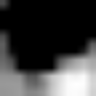

cam_1


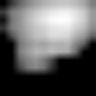

crf_la_0


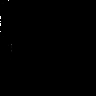

crf_la_1


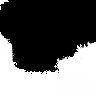

crf_la_2


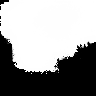

tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 

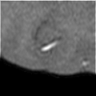

cam_0


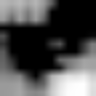

cam_1


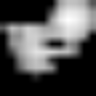

crf_la_0


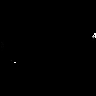

crf_la_1


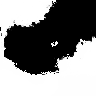

crf_la_2


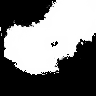

tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 

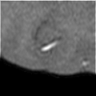

cam_0


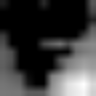

cam_1


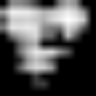

crf_la_0


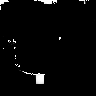

crf_la_1


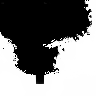

crf_la_2


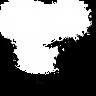

tensor([1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 

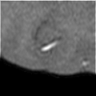

cam_0


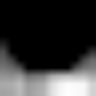

cam_1


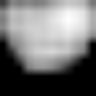

crf_la_0


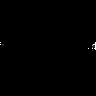

crf_la_1


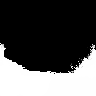

crf_la_2


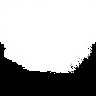

tensor([1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 

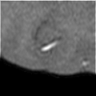

cam_0


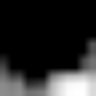

cam_1


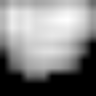

crf_la_0


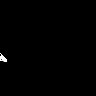

crf_la_1


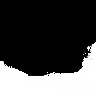

crf_la_2


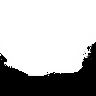

tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 

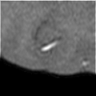

cam_0


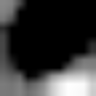

cam_1


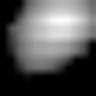

crf_la_0


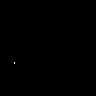

crf_la_1


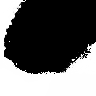

crf_la_2


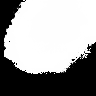

tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 

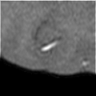

cam_0


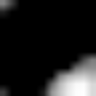

cam_1


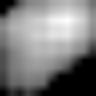

crf_la_0


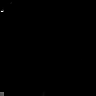

crf_la_1


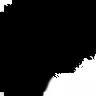

crf_la_2


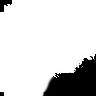

tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 

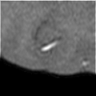

cam_0


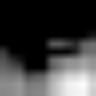

cam_1


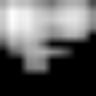

crf_la_0


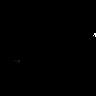

crf_la_1


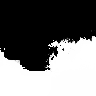

crf_la_2


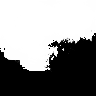

tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 

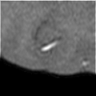

cam_0


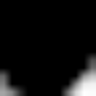

cam_1


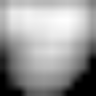

crf_la_0


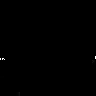

crf_la_1


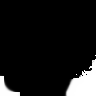

crf_la_2


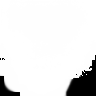

tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 

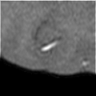

cam_0


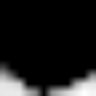

cam_1


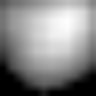

crf_la_0


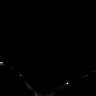

crf_la_1


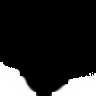

crf_la_2


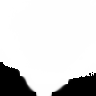

tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 

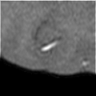

cam_0


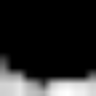

cam_1


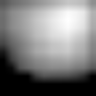

crf_la_0


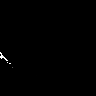

crf_la_1


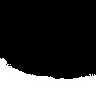

crf_la_2


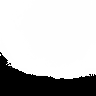

tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 

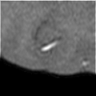

cam_0


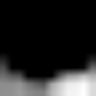

cam_1


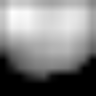

crf_la_0


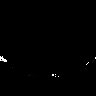

crf_la_1


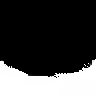

crf_la_2


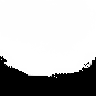

tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 

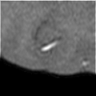

cam_0


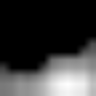

cam_1


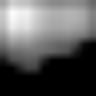

crf_la_0


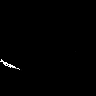

crf_la_1


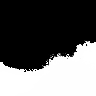

crf_la_2


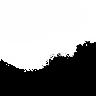

tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 

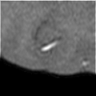

cam_0


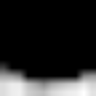

cam_1


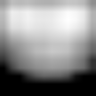

crf_la_0


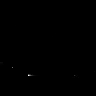

crf_la_1


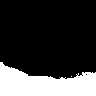

crf_la_2


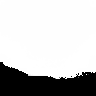

tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 

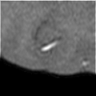

cam_0


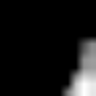

cam_1


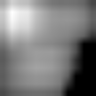

crf_la_0


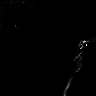

crf_la_1


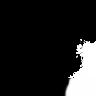

crf_la_2


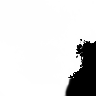

tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 

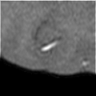

cam_0


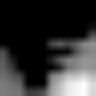

cam_1


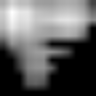

crf_la_0


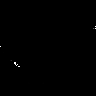

crf_la_1


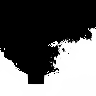

crf_la_2


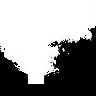

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 

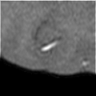

cam_0


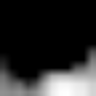

cam_1


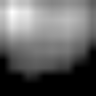

crf_la_0


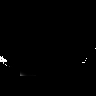

crf_la_1


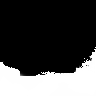

crf_la_2


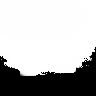

tensor([0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 

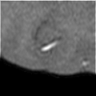

cam_0


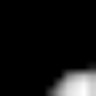

cam_1


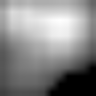

crf_la_0


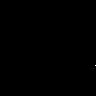

crf_la_1


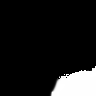

crf_la_2


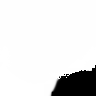

tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 

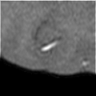

cam_0


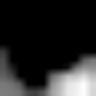

cam_1


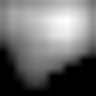

crf_la_0


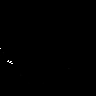

crf_la_1


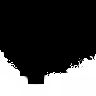

crf_la_2


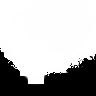

tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 

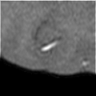

cam_0


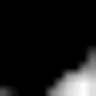

cam_1


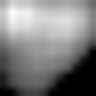

crf_la_0


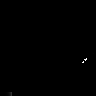

crf_la_1


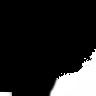

crf_la_2


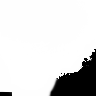

tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 

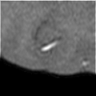

cam_0


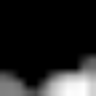

cam_1


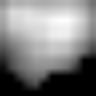

crf_la_0


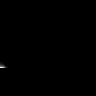

crf_la_1


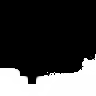

crf_la_2


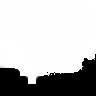

tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 

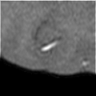

cam_0


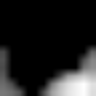

cam_1


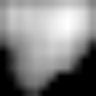

crf_la_0


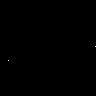

crf_la_1


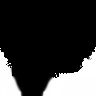

crf_la_2


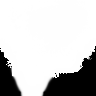

tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 

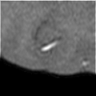

cam_0


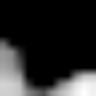

cam_1


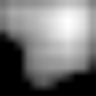

crf_la_0


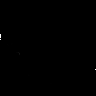

crf_la_1


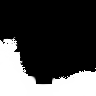

crf_la_2


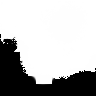

tensor([0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 

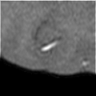

cam_0


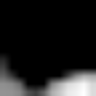

cam_1


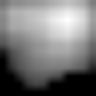

crf_la_0


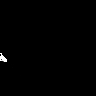

crf_la_1


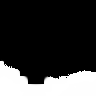

crf_la_2


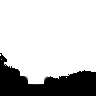

tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 

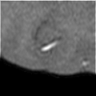

cam_0


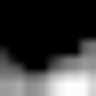

cam_1


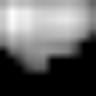

crf_la_0


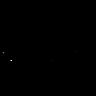

crf_la_1


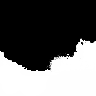

crf_la_2


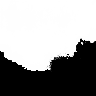

tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 

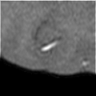

cam_0


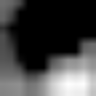

cam_1


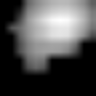

crf_la_0


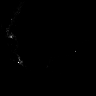

crf_la_1


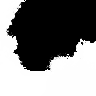

crf_la_2


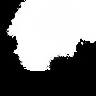

tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 

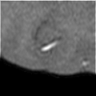

cam_0


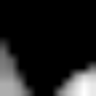

cam_1


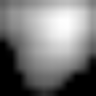

crf_la_0


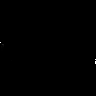

crf_la_1


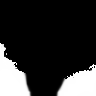

crf_la_2


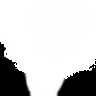

tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 

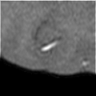

cam_0


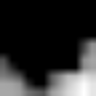

cam_1


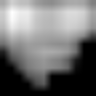

crf_la_0


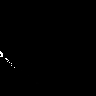

crf_la_1


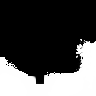

crf_la_2


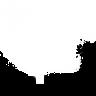

tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 

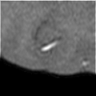

cam_0


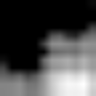

cam_1


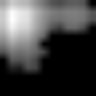

crf_la_0


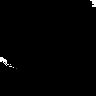

crf_la_1


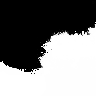

crf_la_2


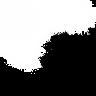

tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 

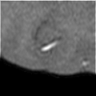

cam_0


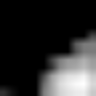

cam_1


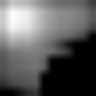

crf_la_0


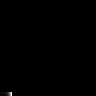

crf_la_1


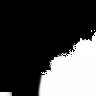

crf_la_2


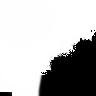

tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 

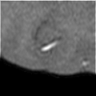

cam_0


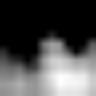

cam_1


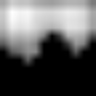

crf_la_0


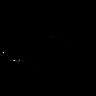

crf_la_1


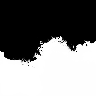

crf_la_2


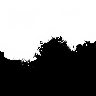

tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 

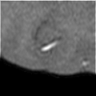

cam_0


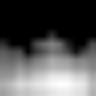

cam_1


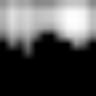

crf_la_0


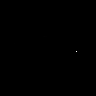

crf_la_1


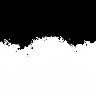

crf_la_2


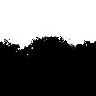

tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 

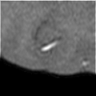

cam_0


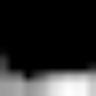

cam_1


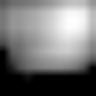

crf_la_0


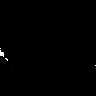

crf_la_1


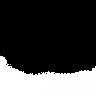

crf_la_2


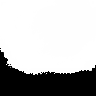

tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 

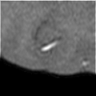

cam_0


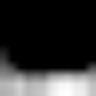

cam_1


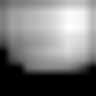

crf_la_0


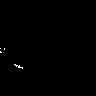

crf_la_1


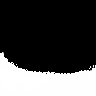

crf_la_2


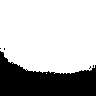

tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 

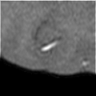

cam_0


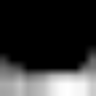

cam_1


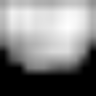

crf_la_0


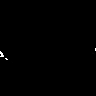

crf_la_1


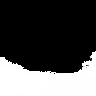

crf_la_2


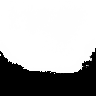

tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 

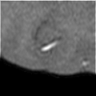

cam_0


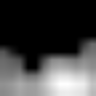

cam_1


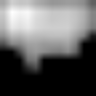

crf_la_0


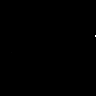

crf_la_1


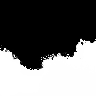

crf_la_2


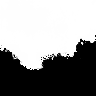

tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 

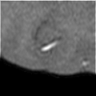

cam_0


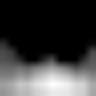

cam_1


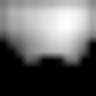

crf_la_0


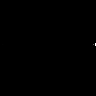

crf_la_1


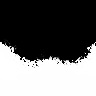

crf_la_2


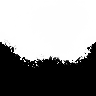

tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 

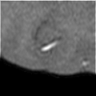

cam_0


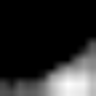

cam_1


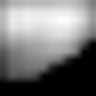

crf_la_0


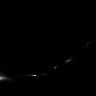

crf_la_1


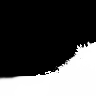

crf_la_2


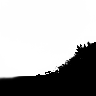

tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 

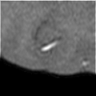

cam_0


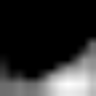

cam_1


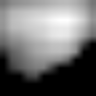

crf_la_0


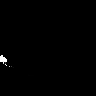

crf_la_1


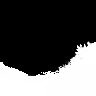

crf_la_2


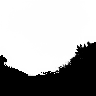

tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 

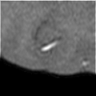

cam_0


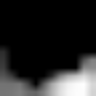

cam_1


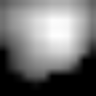

crf_la_0


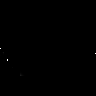

crf_la_1


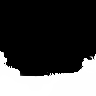

crf_la_2


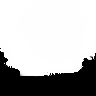

tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 

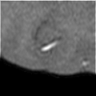

cam_0


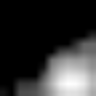

cam_1


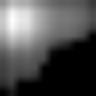

crf_la_0


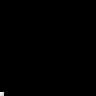

crf_la_1


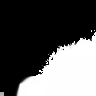

crf_la_2


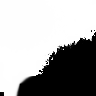

tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 

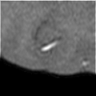

cam_0


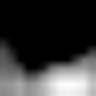

cam_1


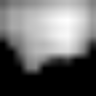

crf_la_0


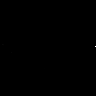

crf_la_1


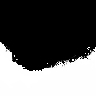

crf_la_2


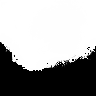

tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 

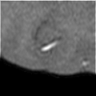

cam_0


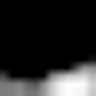

cam_1


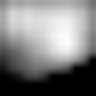

crf_la_0


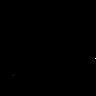

crf_la_1


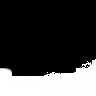

crf_la_2


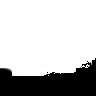

tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 

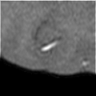

cam_0


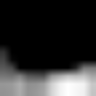

cam_1


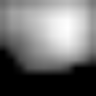

crf_la_0


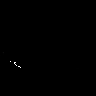

crf_la_1


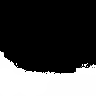

crf_la_2


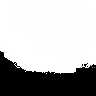

tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 

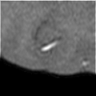

cam_0


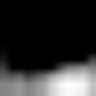

cam_1


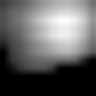

crf_la_0


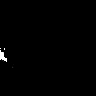

crf_la_1


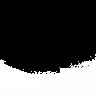

crf_la_2


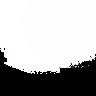

tensor([0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 

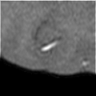

cam_0


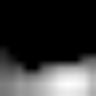

cam_1


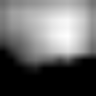

crf_la_0


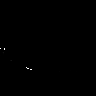

crf_la_1


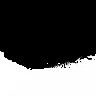

crf_la_2


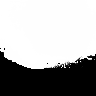

tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 

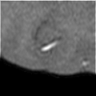

cam_0


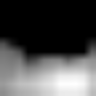

cam_1


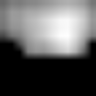

crf_la_0


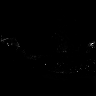

crf_la_1


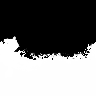

crf_la_2


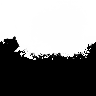

tensor([1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 

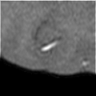

cam_0


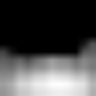

cam_1


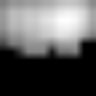

crf_la_0


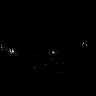

crf_la_1


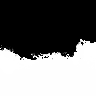

crf_la_2


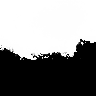

tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

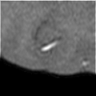

cam_0


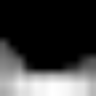

cam_1


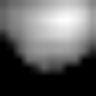

crf_la_0


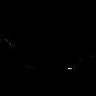

crf_la_1


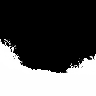

crf_la_2


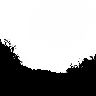

tensor([1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 

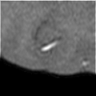

cam_0


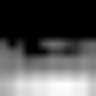

cam_1


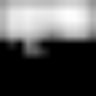

crf_la_0


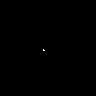

crf_la_1


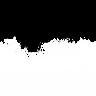

crf_la_2


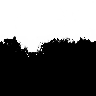

tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 

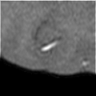

cam_0


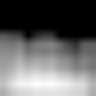

cam_1


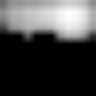

crf_la_0


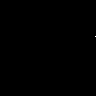

crf_la_1


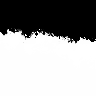

crf_la_2


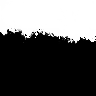

tensor([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 

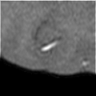

cam_0


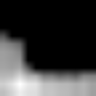

cam_1


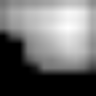

crf_la_0


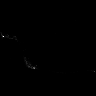

crf_la_1


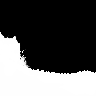

crf_la_2


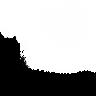

tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 

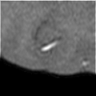

cam_0


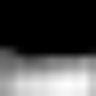

cam_1


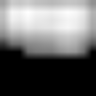

crf_la_0


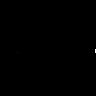

crf_la_1


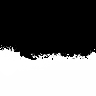

crf_la_2


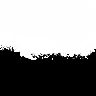

tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 

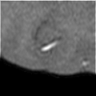

cam_0


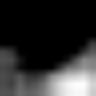

cam_1


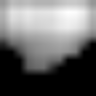

crf_la_0


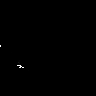

crf_la_1


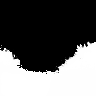

crf_la_2


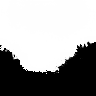

tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 

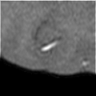

cam_0


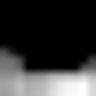

cam_1


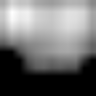

crf_la_0


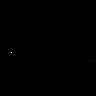

crf_la_1


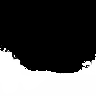

crf_la_2


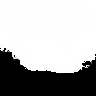

tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 

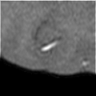

cam_0


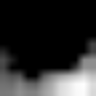

cam_1


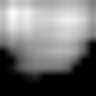

crf_la_0


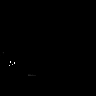

crf_la_1


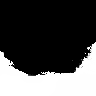

crf_la_2


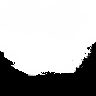

tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 

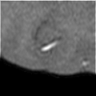

cam_0


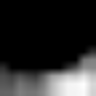

cam_1


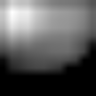

crf_la_0


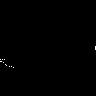

crf_la_1


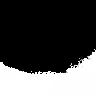

crf_la_2


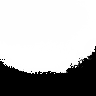

tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 

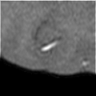

cam_0


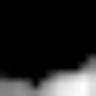

cam_1


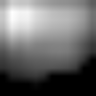

crf_la_0


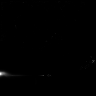

crf_la_1


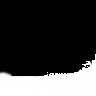

crf_la_2


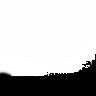

tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 

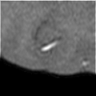

cam_0


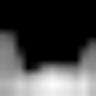

cam_1


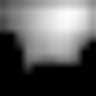

crf_la_0


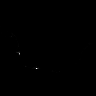

crf_la_1


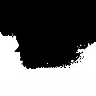

crf_la_2


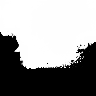

tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 

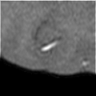

cam_0


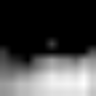

cam_1


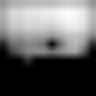

crf_la_0


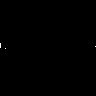

crf_la_1


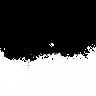

crf_la_2


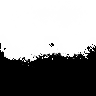

tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 

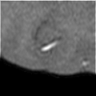

cam_0


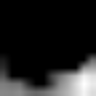

cam_1


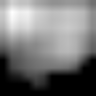

crf_la_0


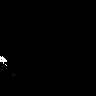

crf_la_1


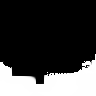

crf_la_2


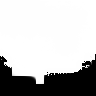

tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 

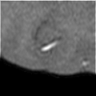

cam_0


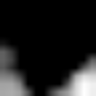

cam_1


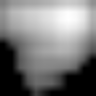

crf_la_0


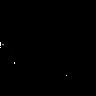

crf_la_1


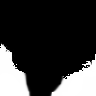

crf_la_2


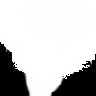

tensor([0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 

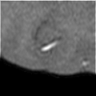

cam_0


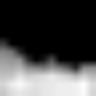

cam_1


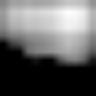

crf_la_0


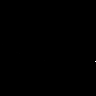

crf_la_1


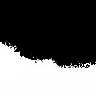

crf_la_2


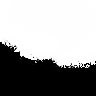

tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 

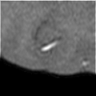

cam_0


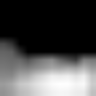

cam_1


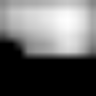

crf_la_0


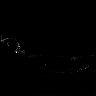

crf_la_1


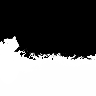

crf_la_2


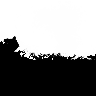

tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 

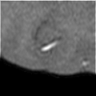

cam_0


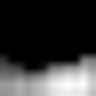

cam_1


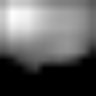

crf_la_0


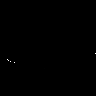

crf_la_1


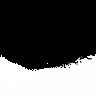

crf_la_2


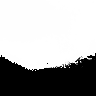

tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 

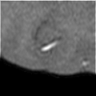

cam_0


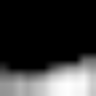

cam_1


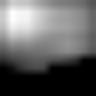

crf_la_0


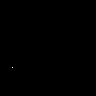

crf_la_1


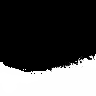

crf_la_2


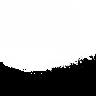

tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 

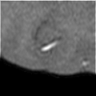

cam_0


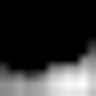

cam_1


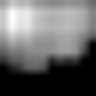

crf_la_0


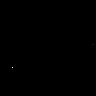

crf_la_1


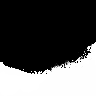

crf_la_2


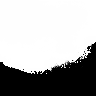

tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 

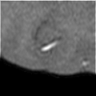

cam_0


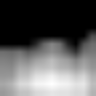

cam_1


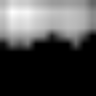

crf_la_0


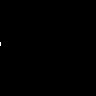

crf_la_1


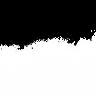

crf_la_2


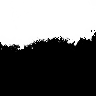

tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 

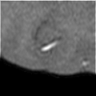

cam_0


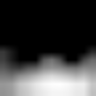

cam_1


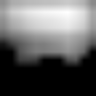

crf_la_0


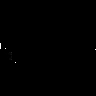

crf_la_1


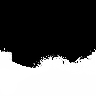

crf_la_2


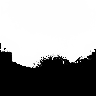

tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 

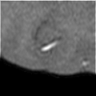

cam_0


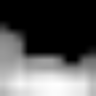

cam_1


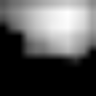

crf_la_0


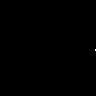

crf_la_1


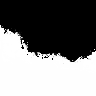

crf_la_2


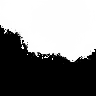

tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 

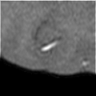

cam_0


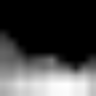

cam_1


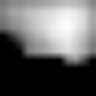

crf_la_0


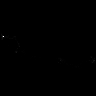

crf_la_1


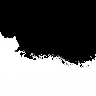

crf_la_2


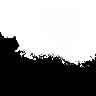

tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 

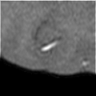

cam_0


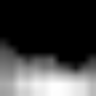

cam_1


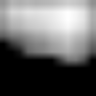

crf_la_0


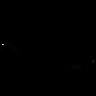

crf_la_1


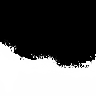

crf_la_2


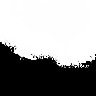

tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 

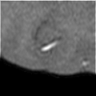

cam_0


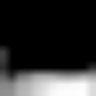

cam_1


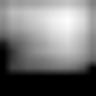

crf_la_0


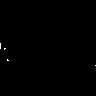

crf_la_1


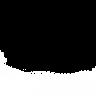

crf_la_2


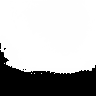

tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 

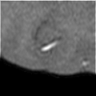

cam_0


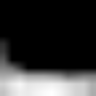

cam_1


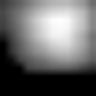

crf_la_0


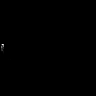

crf_la_1


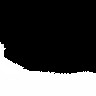

crf_la_2


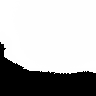

tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 

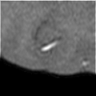

cam_0


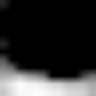

cam_1


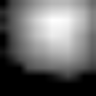

crf_la_0


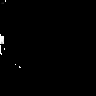

crf_la_1


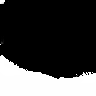

crf_la_2


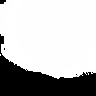

tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 

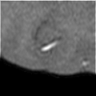

cam_0


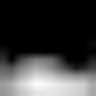

cam_1


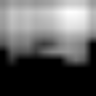

crf_la_0


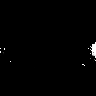

crf_la_1


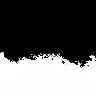

crf_la_2


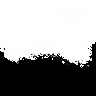

tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 

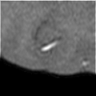

cam_0


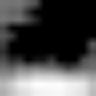

cam_1


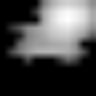

crf_la_0


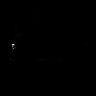

crf_la_1


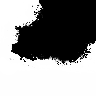

crf_la_2


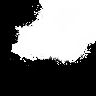

tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 

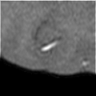

cam_0


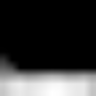

cam_1


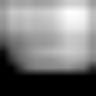

crf_la_0


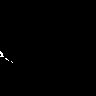

crf_la_1


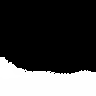

crf_la_2


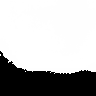

tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 

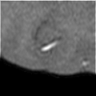

cam_0


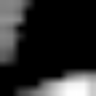

cam_1


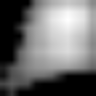

crf_la_0


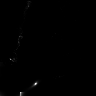

crf_la_1


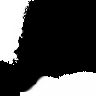

crf_la_2


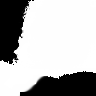

tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 

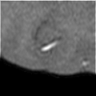

cam_0


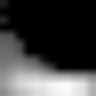

cam_1


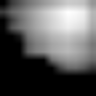

crf_la_0


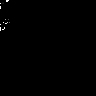

crf_la_1


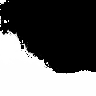

crf_la_2


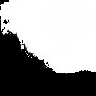

tensor([0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 

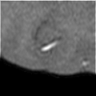

cam_0


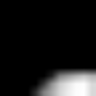

cam_1


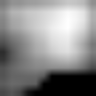

crf_la_0


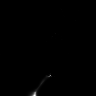

crf_la_1


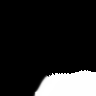

crf_la_2


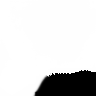

tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 

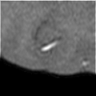

cam_0


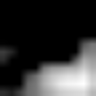

cam_1


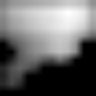

crf_la_0


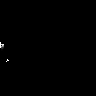

crf_la_1


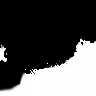

crf_la_2


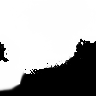

tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 

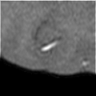

cam_0


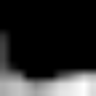

cam_1


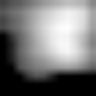

crf_la_0


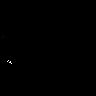

crf_la_1


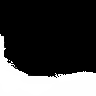

crf_la_2


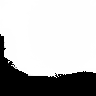

tensor([0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 

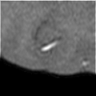

cam_0


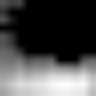

cam_1


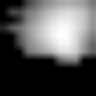

crf_la_0


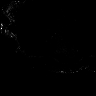

crf_la_1


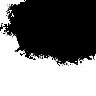

crf_la_2


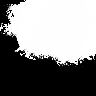

tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 

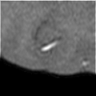

cam_0


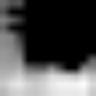

cam_1


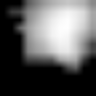

crf_la_0


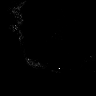

crf_la_1


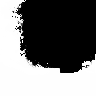

crf_la_2


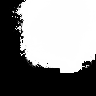

tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 

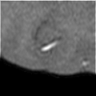

cam_0


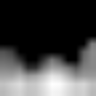

cam_1


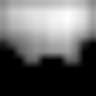

crf_la_0


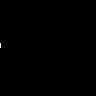

crf_la_1


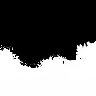

crf_la_2


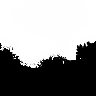

tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 

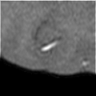

cam_0


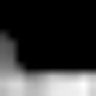

cam_1


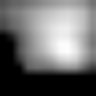

crf_la_0


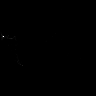

crf_la_1


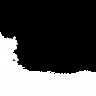

crf_la_2


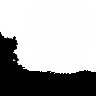

tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 

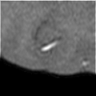

cam_0


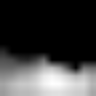

cam_1


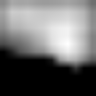

crf_la_0


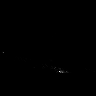

crf_la_1


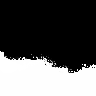

crf_la_2


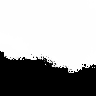

tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 

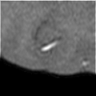

cam_0


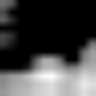

cam_1


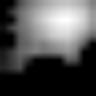

crf_la_0


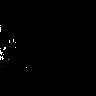

crf_la_1


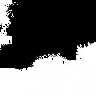

crf_la_2


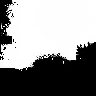

tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 

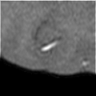

cam_0


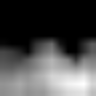

cam_1


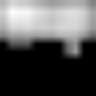

crf_la_0


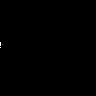

crf_la_1


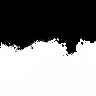

crf_la_2


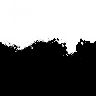

tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 

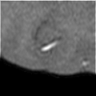

cam_0


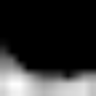

cam_1


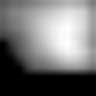

crf_la_0


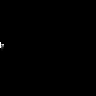

crf_la_1


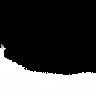

crf_la_2


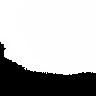

tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 

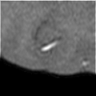

cam_0


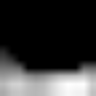

cam_1


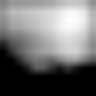

crf_la_0


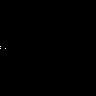

crf_la_1


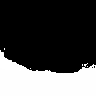

crf_la_2


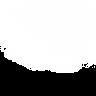

tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 

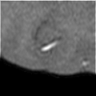

cam_0


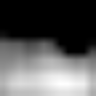

cam_1


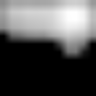

crf_la_0


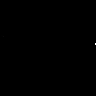

crf_la_1


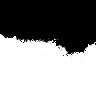

crf_la_2


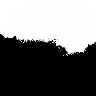

tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 

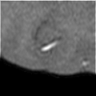

cam_0


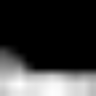

cam_1


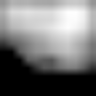

crf_la_0


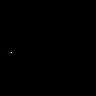

crf_la_1


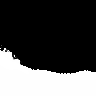

crf_la_2


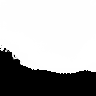

tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 

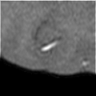

cam_0


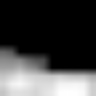

cam_1


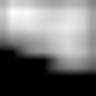

crf_la_0


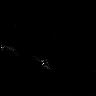

crf_la_1


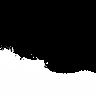

crf_la_2


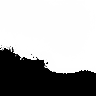

tensor([1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 

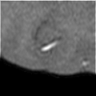

cam_0


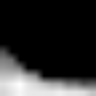

cam_1


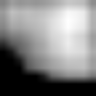

crf_la_0


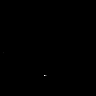

crf_la_1


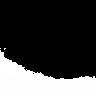

crf_la_2


tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 

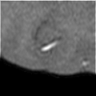

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')

validating ... loss: 0.2936476878585005
tensor([1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0

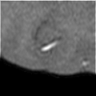

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 

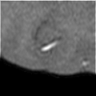

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 

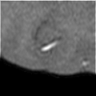

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 

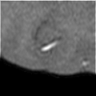

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 

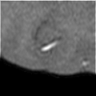

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 

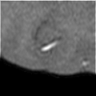

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 

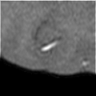

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 

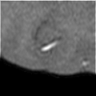

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 

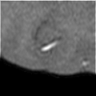

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 

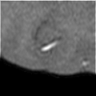

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 

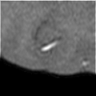

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 

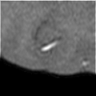

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 

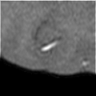

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 

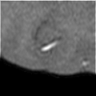

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 

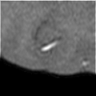

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 

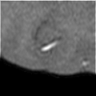

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 

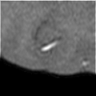

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 

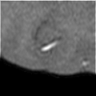

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 

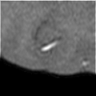

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 

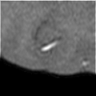

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 

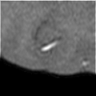

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

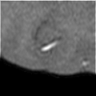

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 

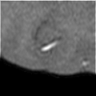

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 

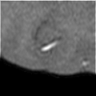

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 

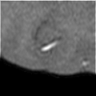

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 

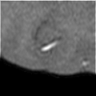

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 

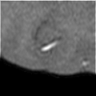

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 

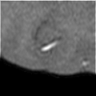

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 

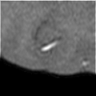

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 

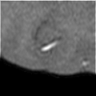

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 

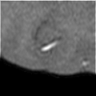

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 

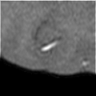

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 

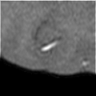

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 

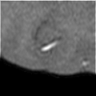

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 

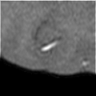

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 

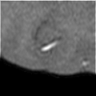

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 

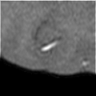

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 

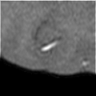

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 

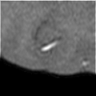

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 

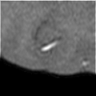

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 

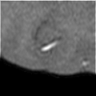

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 

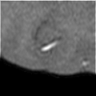

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 

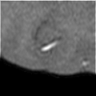

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 

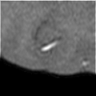

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 

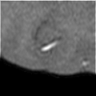

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0], device='cuda:0')
tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 

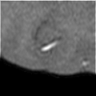

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 

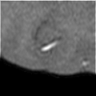

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0], device='cuda:0') tensor([1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 

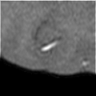

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 

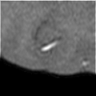

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 

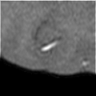

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 

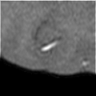

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 

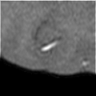

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0') tensor([0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1], device='cuda:0')
tensor([0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0') tensor([0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0], device='cuda:0')
tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 

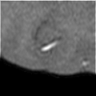

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0], device='cuda:0')
tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0], device='cuda:0')
tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0') tensor([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 

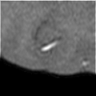

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0') tensor([1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0], device='cuda:0')
tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 

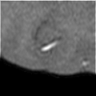

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0') tensor([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0') tensor([1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0') tensor([0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0], device='cuda:0') tensor([1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 

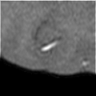

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


tensor([0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0') tensor([0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0], device='cuda:0')
tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0') tensor([0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1], device='cuda:0')
tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0') tensor([0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1], device='cuda:0')
tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0') tensor([0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0') tensor([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1], device='cuda:0')
tensor([1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 

In [ ]:
#!python3 train_cls.py --lr 0.01 --batch_size 16 --max_epoches 15 --crop_size 448 --wt_dec 5e-4 --voc12_root data/img #--network network.resnet38_cls #--weights [your_weights_file]

import numpy as np
import torch
from torch.backends import cudnn
cudnn.enabled = True
from torch.utils.data import DataLoader
from torchvision import transforms
import voc12.data
from tool import pyutils, imutils, torchutils
import argparse
import importlib
import torch.nn.functional as F

from voc12.captcha import *

def display_image(img,title=None):
  img = (img - np.min(img)) / (np.max(img) - np.min(img))
  img *= 255
  img = Image.fromarray(img.astype(np.uint8))
  if title: print(title)
  display(img)

def _crf_with_alpha(orig_img, v, alpha):
  bg_score = np.power(1 - np.max(v, axis=0, keepdims=True), alpha)
  bgcam_score = np.concatenate((bg_score, v), axis=0)
  crf_score = imutils.crf_inference(orig_img, bgcam_score, labels=bgcam_score.shape[0])

  n_crf_al = dict()

  n_crf_al[0] = crf_score[0]
  for i, key in enumerate([0,1]):
      n_crf_al[key+1] = crf_score[i+1]

  return n_crf_al


def validate(model, data_loader):
    print('\nvalidating ... ', flush=True, end='')

    val_loss_meter = pyutils.AverageMeter('loss')

    model.eval()

    with torch.no_grad():
        for pack in data_loader:
            img = pack[1]
            label = pack[2].cuda(non_blocking=True)

            x = model(img)
            loss = F.multilabel_soft_margin_loss(x, label)

            val_loss_meter.add({'loss': loss.item()})

    model.train()

    loss = val_loss_meter.pop('loss')

    print('loss:', loss)

    return loss

"""parser = argparse.ArgumentParser()
parser.add_argument("--batch_size", default=16, type=int)
parser.add_argument("--max_epoches", default=15, type=int)
parser.add_argument("--network", default="network.vgg16_cls", type=str)
parser.add_argument("--lr", default=0.1, type=float)
parser.add_argument("--num_workers", default=8, type=int)
parser.add_argument("--wt_dec", default=5e-4, type=float)
parser.add_argument("--weights", required=False, type=str)
parser.add_argument("--train_list", default="voc12/train_aug.txt", type=str)
parser.add_argument("--val_list", default="voc12/val.txt", type=str)
parser.add_argument("--session_name", default="vgg_cls", type=str)
parser.add_argument("--crop_size", default=448, type=int)
parser.add_argument("--voc12_root", required=True, type=str)
args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.batch_size = 16
args.max_epoches = 15
args.network = "network.vgg16_cls"
args.lr = 0.0001
args.num_workers = 8
args.wt_dec = 5e-4
args.weights = None
args.train_list = "voc12/train_aug.txt"
args.val_list = "voc12/val.txt"
args.session_name = "vgg_cls"
args.crop_size = 92
args.voc12_root = "data/img"
args.voc12_root_val = "data/img_val"

model = getattr(importlib.import_module(args.network), 'Net')()

pyutils.Logger(args.session_name + '.log')

print(vars(args))

"""train_dataset = voc12.data.VOC12ClsDataset(args.train_list, voc12_root=args.voc12_root,
                                            transform=transforms.Compose([
                    imutils.RandomResizeLong(256, 512),
                    transforms.RandomHorizontalFlip(),
                    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
                    np.asarray,
                    model.normalize,
                    imutils.RandomCrop(args.crop_size),
                    imutils.HWC_to_CHW,
                    torch.from_numpy
                ]))

train_data_loader = DataLoader(train_dataset, batch_size=args.batch_size,
                                shuffle=True, num_workers=args.num_workers, pin_memory=True, drop_last=True)

val_dataset = voc12.data.VOC12ClsDataset(args.val_list, voc12_root=args.voc12_root,
                                          transform=transforms.Compose([
                    np.asarray,
                    model.normalize,
                    imutils.CenterCrop(500),
                    imutils.HWC_to_CHW,
                    torch.from_numpy
                ]))
val_data_loader = DataLoader(val_dataset, batch_size=args.batch_size,
                              shuffle=False, num_workers=args.num_workers, pin_memory=True, drop_last=True)"""


train_dataset = AllBrainImages(args.voc12_root,transform=transforms.Compose([
  #Standardize(234.08844113652563,174.22328263189004),
  #Normalize(0,3205),
  #RandomResizeLong(args.crop_size, args.crop_size),
  #CenterCrop(),
  OneHot(),
  ToTensor()
]))

train_data_loader = DataLoader(train_dataset, batch_size=args.batch_size,
                                shuffle=True, num_workers=args.num_workers, pin_memory=True, drop_last=True)

val_dataset = AllBrainImages(args.voc12_root_val,transform=transforms.Compose([
  #Standardize(234.08844113652563,174.22328263189004),
  #Normalize(0,3205),
  #RandomResizeLong(args.crop_size, args.crop_size),
  #CenterCrop(),
  OneHot(),
  ToTensor()
]))

val_data_loader = DataLoader(val_dataset, batch_size=args.batch_size,
                              shuffle=False, num_workers=args.num_workers, pin_memory=True, drop_last=True)


max_step = (len(train_dataset) // args.batch_size) * args.max_epoches

"""param_groups = model.get_parameter_groups()
optimizer = torchutils.PolyOptimizer([
    {'params': param_groups[0], 'lr': args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[1], 'lr': 2*args.lr, 'weight_decay': 0},
    {'params': param_groups[2], 'lr': 10*args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[3], 'lr': 20*args.lr, 'weight_decay': 0}
], lr=args.lr, weight_decay=args.wt_dec, max_step=max_step)"""

optimizer = torch.optim.Adam(model.parameters(), lr=args.lr)#, momentum=.9)

"""if args.weights[-7:] == '.params':
    assert args.network == "network.resnet38_cls"
    import network.resnet38d
    weights_dict = network.resnet38d.convert_mxnet_to_torch(args.weights)
elif args.weights[-11:] == '.caffemodel':
    assert args.network == "network.vgg16_cls"
    import network.vgg16d
    weights_dict = network.vgg16d.convert_caffe_to_torch(args.weights)
else:
    weights_dict = torch.load(args.weights)

model.load_state_dict(weights_dict, strict=False)"""
model = torch.nn.DataParallel(model).cuda()
model.train()

avg_meter = pyutils.AverageMeter('loss')

timer = pyutils.Timer("Session started: ")

iter=0
validation_loss=np.inf

model_replicas = torch.nn.parallel.replicate(model, list(range(1)))
for ep in range(args.max_epoches):

    for slide_id, pack in enumerate(train_data_loader): 

        img = pack[1]
        label = pack[2].cuda(non_blocking=True)

        x = model(img)
        print(torch.argmax(x,axis=1),torch.argmax(label,axis=1))
        loss = F.multilabel_soft_margin_loss(x, label)

        avg_meter.add({'loss': loss.item()})

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if (iter-1)%50 == 0:
            timer.update_progress(iter / max_step)

            print('Iter:%5d/%5d' % (iter - 1, max_step),
                  'Loss:%.4f' % (avg_meter.pop('loss')),
                  'imps:%.1f' % ((iter+1) * args.batch_size / timer.get_stage_elapsed()),
                  'Fin:%s' % (timer.str_est_finish()),
                  'lr: %.4f' % (optimizer.param_groups[0]['lr']), flush=True)
            torch.save(model.module.state_dict(), args.session_name + '.pth')

            example=np.load("example.npy")
            display_image(example,"example")
            cam = model.module.forward_cam(
                torch.tensor(example).float()[None,None,...].cuda()
            )
            cam = F.interpolate(cam, 96, mode='bilinear', align_corners=False)[0]
            cam = cam.cpu().detach().numpy()
            for k in range(len(cam)): display_image(cam[k],f"cam_{k}")
            crf_la = _crf_with_alpha(example, cam, 4)
            for k in crf_la: display_image(crf_la[k],f"crf_la_{k}")
            
        iter+=1

    else:
        current_validation_loss = validate(model, val_data_loader)
        if current_validation_loss < validation_loss:
            validation_loss = current_validation_loss
            torch.save(model.module.state_dict(), args.session_name + '.pth')
        timer.reset_stage()

#torch.save(model.module.state_dict(), args.session_name + '.pth')


In [ ]:
!cp vgg_cls.pth /content/drive/MyDrive/tesi/CAPTCHA/vgg_cls_new96_ourOptimizer.pth

### w/ their optimizer

In [ ]:
%cd psa

/content/psa


{'batch_size': 16, 'max_epoches': 15, 'network': 'network.vgg16_cls', 'lr': 0.01, 'num_workers': 8, 'wt_dec': 0.0005, 'weights': 'vgg_cls.pth', 'train_list': 'voc12/train_aug.txt', 'val_list': 'voc12/val.txt', 'session_name': 'vgg_cls', 'crop_size': 92, 'voc12_root': 'data/img', 'voc12_root_val': 'data/img_val'}


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Session started:  Mon Jul 12 19:49:36 2021


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Iter:    0/21240 Loss:0.0247 imps:65.6 Fin:Mon Jul 12 22:42:21 2021 lr: 0.0100
example


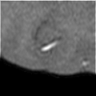

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


Iter:   50/21240 Loss:0.1278 imps:94.2 Fin:Mon Jul 12 20:50:54 2021 lr: 0.0100
example


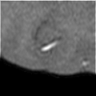

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


Iter:  100/21240 Loss:0.0787 imps:95.2 Fin:Mon Jul 12 20:49:42 2021 lr: 0.0100
example


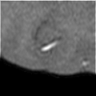

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


Iter:  150/21240 Loss:0.1152 imps:95.5 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0099
example


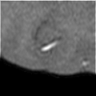

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


Iter:  200/21240 Loss:0.1570 imps:95.7 Fin:Mon Jul 12 20:49:05 2021 lr: 0.0099
example


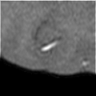

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


Iter:  250/21240 Loss:0.1025 imps:95.8 Fin:Mon Jul 12 20:48:58 2021 lr: 0.0099
example


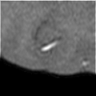

cam_0


cam_1


crf_la_0


crf_la_1


crf_la_2


Iter:  300/21240 Loss:4608389511654.9824 imps:95.9 Fin:Mon Jul 12 20:48:53 2021 lr: 0.0099
example


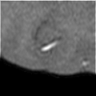

cam_0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in true_divide


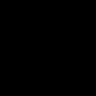

cam_1


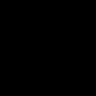

crf_la_0


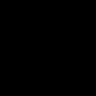

crf_la_1


crf_la_2


Iter:  350/21240 Loss:0.6931 imps:95.9 Fin:Mon Jul 12 20:48:51 2021 lr: 0.0099
example


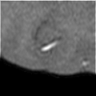

cam_0


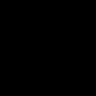

cam_1


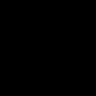

crf_la_0


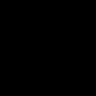

crf_la_1


crf_la_2


Iter:  400/21240 Loss:0.6931 imps:95.9 Fin:Mon Jul 12 20:48:49 2021 lr: 0.0098
example


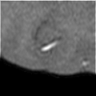

cam_0


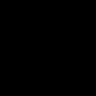

cam_1


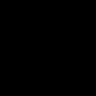

crf_la_0


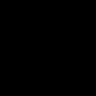

crf_la_1


crf_la_2


Iter:  450/21240 Loss:0.6931 imps:95.9 Fin:Mon Jul 12 20:48:46 2021 lr: 0.0098
example


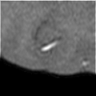

cam_0


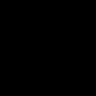

cam_1


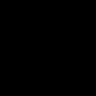

crf_la_0


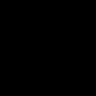

crf_la_1


crf_la_2


Iter:  500/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:44 2021 lr: 0.0098
example


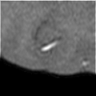

cam_0


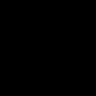

cam_1


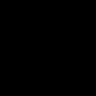

crf_la_0


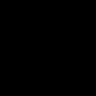

crf_la_1


crf_la_2


Iter:  550/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:43 2021 lr: 0.0098
example


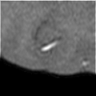

cam_0


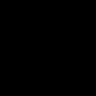

cam_1


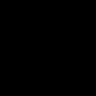

crf_la_0


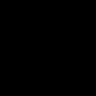

crf_la_1


crf_la_2


Iter:  600/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:42 2021 lr: 0.0097
example


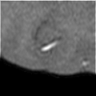

cam_0


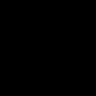

cam_1


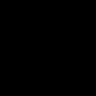

crf_la_0


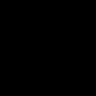

crf_la_1


crf_la_2


Iter:  650/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:41 2021 lr: 0.0097
example


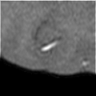

cam_0


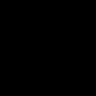

cam_1


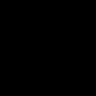

crf_la_0


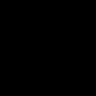

crf_la_1


crf_la_2


Iter:  700/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:40 2021 lr: 0.0097
example


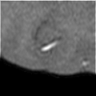

cam_0


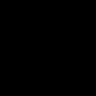

cam_1


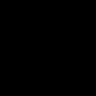

crf_la_0


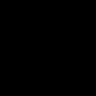

crf_la_1


crf_la_2


Iter:  750/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:40 2021 lr: 0.0097
example


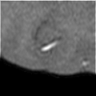

cam_0


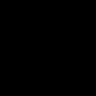

cam_1


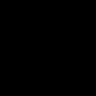

crf_la_0


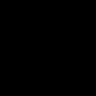

crf_la_1


crf_la_2


Iter:  800/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:40 2021 lr: 0.0097
example


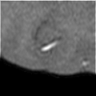

cam_0


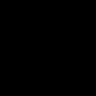

cam_1


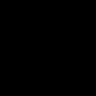

crf_la_0


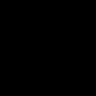

crf_la_1


crf_la_2


Iter:  850/21240 Loss:0.6931 imps:96.0 Fin:Mon Jul 12 20:48:39 2021 lr: 0.0096
example


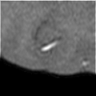

cam_0


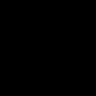

cam_1


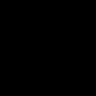

crf_la_0


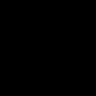

crf_la_1


crf_la_2


Iter:  900/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:38 2021 lr: 0.0096
example


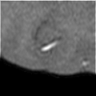

cam_0


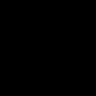

cam_1


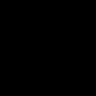

crf_la_0


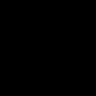

crf_la_1


crf_la_2


Iter:  950/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:38 2021 lr: 0.0096
example


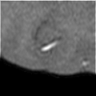

cam_0


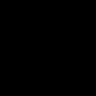

cam_1


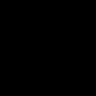

crf_la_0


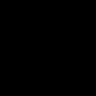

crf_la_1


crf_la_2


Iter: 1000/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:37 2021 lr: 0.0096
example


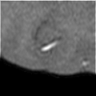

cam_0


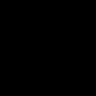

cam_1


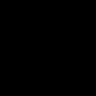

crf_la_0


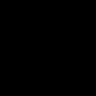

crf_la_1


crf_la_2


Iter: 1050/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:37 2021 lr: 0.0096
example


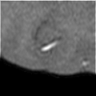

cam_0


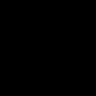

cam_1


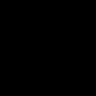

crf_la_0


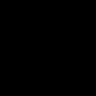

crf_la_1


crf_la_2


Iter: 1100/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:37 2021 lr: 0.0095
example


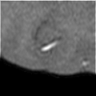

cam_0


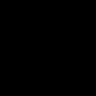

cam_1


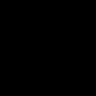

crf_la_0


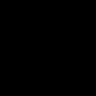

crf_la_1


crf_la_2


Iter: 1150/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:37 2021 lr: 0.0095
example


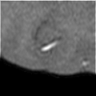

cam_0


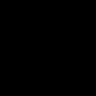

cam_1


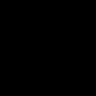

crf_la_0


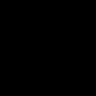

crf_la_1


crf_la_2


Iter: 1200/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:37 2021 lr: 0.0095
example


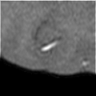

cam_0


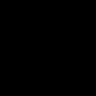

cam_1


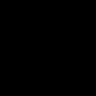

crf_la_0


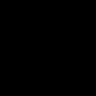

crf_la_1


crf_la_2


Iter: 1250/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:37 2021 lr: 0.0095
example


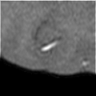

cam_0


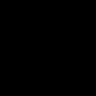

cam_1


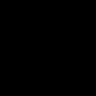

crf_la_0


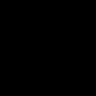

crf_la_1


crf_la_2


Iter: 1300/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:36 2021 lr: 0.0094
example


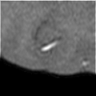

cam_0


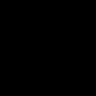

cam_1


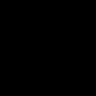

crf_la_0


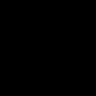

crf_la_1


crf_la_2


Iter: 1350/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:36 2021 lr: 0.0094
example


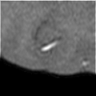

cam_0


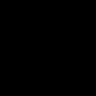

cam_1


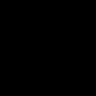

crf_la_0


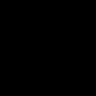

crf_la_1


crf_la_2


Iter: 1400/21240 Loss:0.6931 imps:96.1 Fin:Mon Jul 12 20:48:36 2021 lr: 0.0094
example


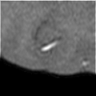

cam_0


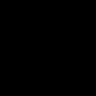

cam_1


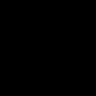

crf_la_0


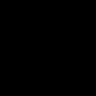

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter: 1450/21240 Loss:0.6931 imps:3908.5 Fin:Mon Jul 12 20:49:22 2021 lr: 0.0094
example


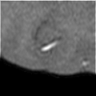

cam_0


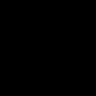

cam_1


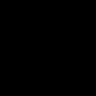

crf_la_0


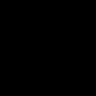

crf_la_1


crf_la_2


Iter: 1500/21240 Loss:0.6931 imps:1678.9 Fin:Mon Jul 12 20:49:21 2021 lr: 0.0094
example


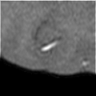

cam_0


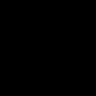

cam_1


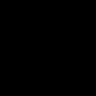

crf_la_0


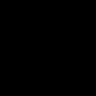

crf_la_1


crf_la_2


Iter: 1550/21240 Loss:0.6931 imps:1096.3 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0093
example


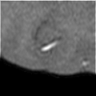

cam_0


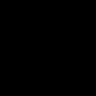

cam_1


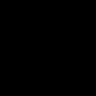

crf_la_0


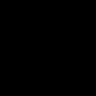

crf_la_1


crf_la_2


Iter: 1600/21240 Loss:0.6931 imps:827.6 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0093
example


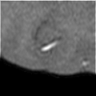

cam_0


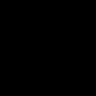

cam_1


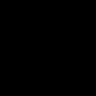

crf_la_0


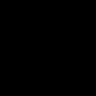

crf_la_1


crf_la_2


Iter: 1650/21240 Loss:0.6931 imps:672.7 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0093
example


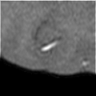

cam_0


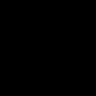

cam_1


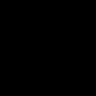

crf_la_0


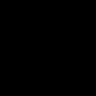

crf_la_1


crf_la_2


Iter: 1700/21240 Loss:0.6931 imps:571.9 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0093
example


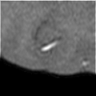

cam_0


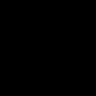

cam_1


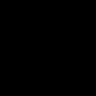

crf_la_0


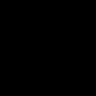

crf_la_1


crf_la_2


Iter: 1750/21240 Loss:0.6931 imps:501.0 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0093
example


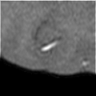

cam_0


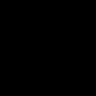

cam_1


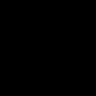

crf_la_0


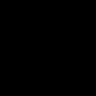

crf_la_1


crf_la_2


Iter: 1800/21240 Loss:0.6931 imps:448.5 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0092
example


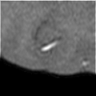

cam_0


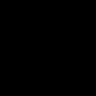

cam_1


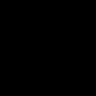

crf_la_0


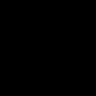

crf_la_1


crf_la_2


Iter: 1850/21240 Loss:0.6931 imps:408.1 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0092
example


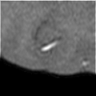

cam_0


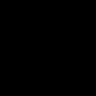

cam_1


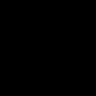

crf_la_0


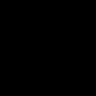

crf_la_1


crf_la_2


Iter: 1900/21240 Loss:0.6931 imps:376.1 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0092
example


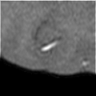

cam_0


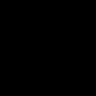

cam_1


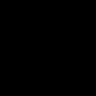

crf_la_0


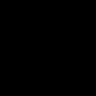

crf_la_1


crf_la_2


Iter: 1950/21240 Loss:0.6931 imps:350.0 Fin:Mon Jul 12 20:49:10 2021 lr: 0.0092
example


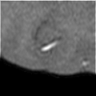

cam_0


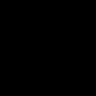

cam_1


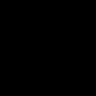

crf_la_0


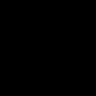

crf_la_1


crf_la_2


Iter: 2000/21240 Loss:0.6931 imps:328.3 Fin:Mon Jul 12 20:49:09 2021 lr: 0.0091
example


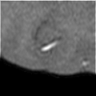

cam_0


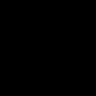

cam_1


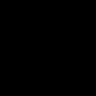

crf_la_0


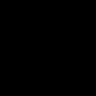

crf_la_1


crf_la_2


Iter: 2050/21240 Loss:0.6931 imps:310.0 Fin:Mon Jul 12 20:49:08 2021 lr: 0.0091
example


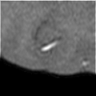

cam_0


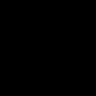

cam_1


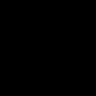

crf_la_0


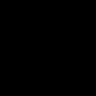

crf_la_1


crf_la_2


Iter: 2100/21240 Loss:0.6931 imps:294.4 Fin:Mon Jul 12 20:49:08 2021 lr: 0.0091
example


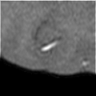

cam_0


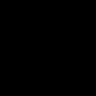

cam_1


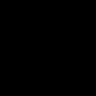

crf_la_0


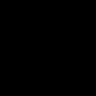

crf_la_1


crf_la_2


Iter: 2150/21240 Loss:0.6931 imps:281.0 Fin:Mon Jul 12 20:49:07 2021 lr: 0.0091
example


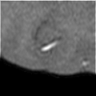

cam_0


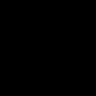

cam_1


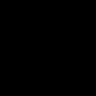

crf_la_0


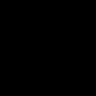

crf_la_1


crf_la_2


Iter: 2200/21240 Loss:0.6931 imps:269.2 Fin:Mon Jul 12 20:49:06 2021 lr: 0.0091
example


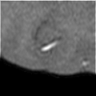

cam_0


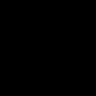

cam_1


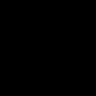

crf_la_0


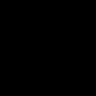

crf_la_1


crf_la_2


Iter: 2250/21240 Loss:0.6931 imps:258.9 Fin:Mon Jul 12 20:49:05 2021 lr: 0.0090
example


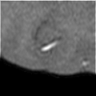

cam_0


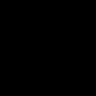

cam_1


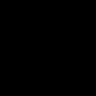

crf_la_0


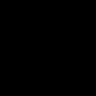

crf_la_1


crf_la_2


Iter: 2300/21240 Loss:0.6931 imps:249.7 Fin:Mon Jul 12 20:49:04 2021 lr: 0.0090
example


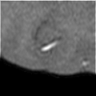

cam_0


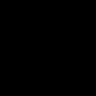

cam_1


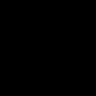

crf_la_0


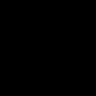

crf_la_1


crf_la_2


Iter: 2350/21240 Loss:0.6931 imps:241.5 Fin:Mon Jul 12 20:49:04 2021 lr: 0.0090
example


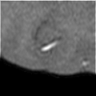

cam_0


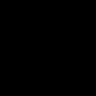

cam_1


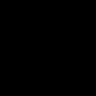

crf_la_0


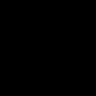

crf_la_1


crf_la_2


Iter: 2400/21240 Loss:0.6931 imps:234.2 Fin:Mon Jul 12 20:49:03 2021 lr: 0.0090
example


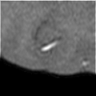

cam_0


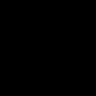

cam_1


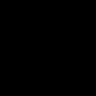

crf_la_0


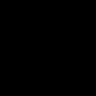

crf_la_1


crf_la_2


Iter: 2450/21240 Loss:0.6931 imps:227.5 Fin:Mon Jul 12 20:49:02 2021 lr: 0.0090
example


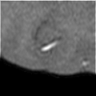

cam_0


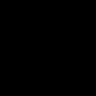

cam_1


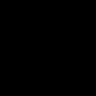

crf_la_0


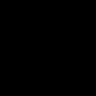

crf_la_1


crf_la_2


Iter: 2500/21240 Loss:0.6931 imps:221.4 Fin:Mon Jul 12 20:49:02 2021 lr: 0.0089
example


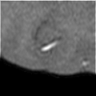

cam_0


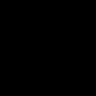

cam_1


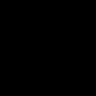

crf_la_0


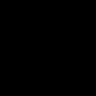

crf_la_1


crf_la_2


Iter: 2550/21240 Loss:0.6931 imps:215.9 Fin:Mon Jul 12 20:49:01 2021 lr: 0.0089
example


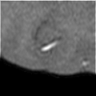

cam_0


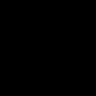

cam_1


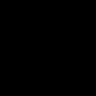

crf_la_0


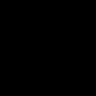

crf_la_1


crf_la_2


Iter: 2600/21240 Loss:0.6931 imps:210.9 Fin:Mon Jul 12 20:49:01 2021 lr: 0.0089
example


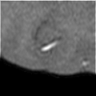

cam_0


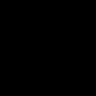

cam_1


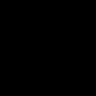

crf_la_0


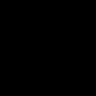

crf_la_1


crf_la_2


Iter: 2650/21240 Loss:0.6931 imps:206.2 Fin:Mon Jul 12 20:49:00 2021 lr: 0.0089
example


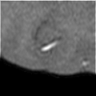

cam_0


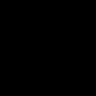

cam_1


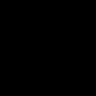

crf_la_0


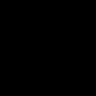

crf_la_1


crf_la_2


Iter: 2700/21240 Loss:0.6931 imps:201.9 Fin:Mon Jul 12 20:49:00 2021 lr: 0.0088
example


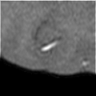

cam_0


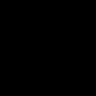

cam_1


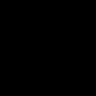

crf_la_0


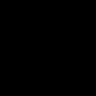

crf_la_1


crf_la_2


Iter: 2750/21240 Loss:0.6931 imps:198.0 Fin:Mon Jul 12 20:48:59 2021 lr: 0.0088
example


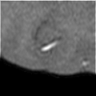

cam_0


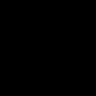

cam_1


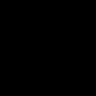

crf_la_0


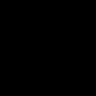

crf_la_1


crf_la_2


Iter: 2800/21240 Loss:0.6931 imps:194.3 Fin:Mon Jul 12 20:48:59 2021 lr: 0.0088
example


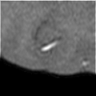

cam_0


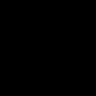

cam_1


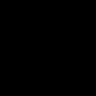

crf_la_0


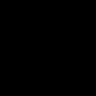

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter: 2850/21240 Loss:0.6931 imps:13678.1 Fin:Mon Jul 12 20:49:21 2021 lr: 0.0088
example


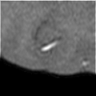

cam_0


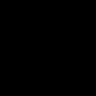

cam_1


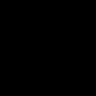

crf_la_0


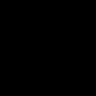

crf_la_1


crf_la_2


Iter: 2900/21240 Loss:0.6931 imps:3970.5 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0088
example


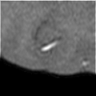

cam_0


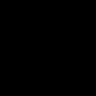

cam_1


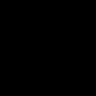

crf_la_0


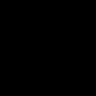

crf_la_1


crf_la_2


Iter: 2950/21240 Loss:0.6931 imps:2358.6 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0087
example


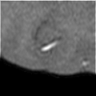

cam_0


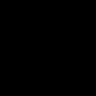

cam_1


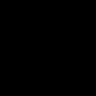

crf_la_0


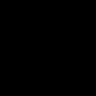

crf_la_1


crf_la_2


Iter: 3000/21240 Loss:0.6931 imps:1694.6 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0087
example


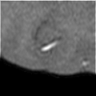

cam_0


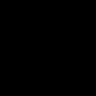

cam_1


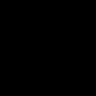

crf_la_0


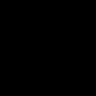

crf_la_1


crf_la_2


Iter: 3050/21240 Loss:0.6931 imps:1331.9 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0087
example


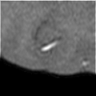

cam_0


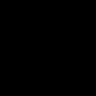

cam_1


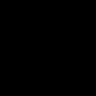

crf_la_0


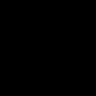

crf_la_1


crf_la_2


Iter: 3100/21240 Loss:0.6931 imps:1103.4 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0087
example


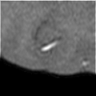

cam_0


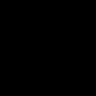

cam_1


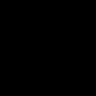

crf_la_0


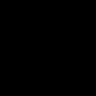

crf_la_1


crf_la_2


Iter: 3150/21240 Loss:0.6931 imps:946.2 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0087
example


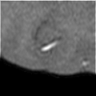

cam_0


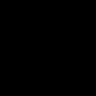

cam_1


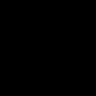

crf_la_0


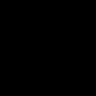

crf_la_1


crf_la_2


Iter: 3200/21240 Loss:0.6931 imps:831.5 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0086
example


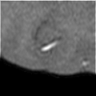

cam_0


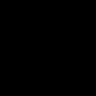

cam_1


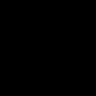

crf_la_0


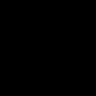

crf_la_1


crf_la_2


Iter: 3250/21240 Loss:0.6931 imps:743.9 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0086
example


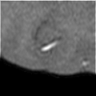

cam_0


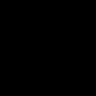

cam_1


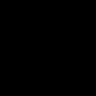

crf_la_0


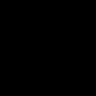

crf_la_1


crf_la_2


Iter: 3300/21240 Loss:0.6931 imps:674.9 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0086
example


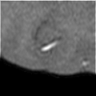

cam_0


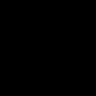

cam_1


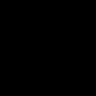

crf_la_0


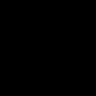

crf_la_1


crf_la_2


Iter: 3350/21240 Loss:0.6931 imps:619.3 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0086
example


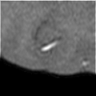

cam_0


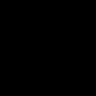

cam_1


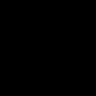

crf_la_0


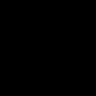

crf_la_1


crf_la_2


Iter: 3400/21240 Loss:0.6931 imps:573.5 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0085
example


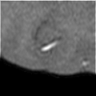

cam_0


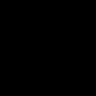

cam_1


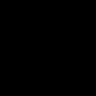

crf_la_0


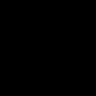

crf_la_1


crf_la_2


Iter: 3450/21240 Loss:0.6931 imps:534.9 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0085
example


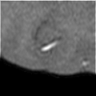

cam_0


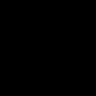

cam_1


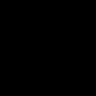

crf_la_0


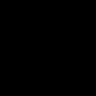

crf_la_1


crf_la_2


Iter: 3500/21240 Loss:0.6931 imps:502.1 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0085
example


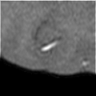

cam_0


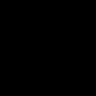

cam_1


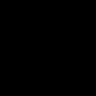

crf_la_0


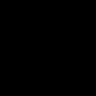

crf_la_1


crf_la_2


Iter: 3550/21240 Loss:0.6931 imps:474.0 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0085
example


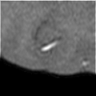

cam_0


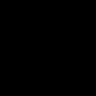

cam_1


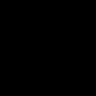

crf_la_0


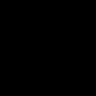

crf_la_1


crf_la_2


Iter: 3600/21240 Loss:0.6931 imps:449.5 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0085
example


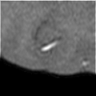

cam_0


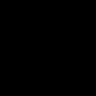

cam_1


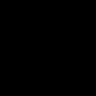

crf_la_0


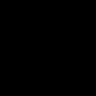

crf_la_1


crf_la_2


Iter: 3650/21240 Loss:0.6931 imps:427.9 Fin:Mon Jul 12 20:49:10 2021 lr: 0.0084
example


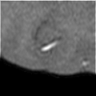

cam_0


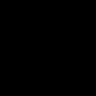

cam_1


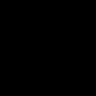

crf_la_0


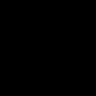

crf_la_1


crf_la_2


Iter: 3700/21240 Loss:0.6931 imps:408.9 Fin:Mon Jul 12 20:49:10 2021 lr: 0.0084
example


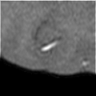

cam_0


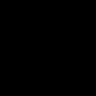

cam_1


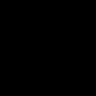

crf_la_0


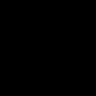

crf_la_1


crf_la_2


Iter: 3750/21240 Loss:0.6931 imps:391.9 Fin:Mon Jul 12 20:49:09 2021 lr: 0.0084
example


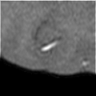

cam_0


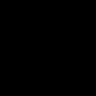

cam_1


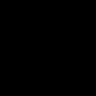

crf_la_0


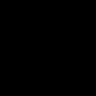

crf_la_1


crf_la_2


Iter: 3800/21240 Loss:0.6931 imps:376.6 Fin:Mon Jul 12 20:49:09 2021 lr: 0.0084
example


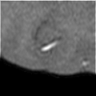

cam_0


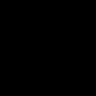

cam_1


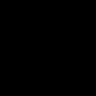

crf_la_0


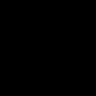

crf_la_1


crf_la_2


Iter: 3850/21240 Loss:0.6931 imps:362.9 Fin:Mon Jul 12 20:49:08 2021 lr: 0.0084
example


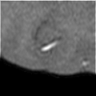

cam_0


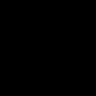

cam_1


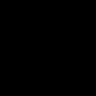

crf_la_0


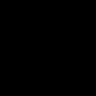

crf_la_1


crf_la_2


Iter: 3900/21240 Loss:0.6931 imps:350.4 Fin:Mon Jul 12 20:49:08 2021 lr: 0.0083
example


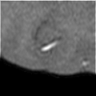

cam_0


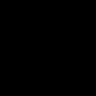

cam_1


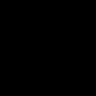

crf_la_0


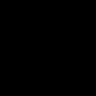

crf_la_1


crf_la_2


Iter: 3950/21240 Loss:0.6931 imps:339.0 Fin:Mon Jul 12 20:49:07 2021 lr: 0.0083
example


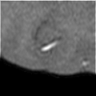

cam_0


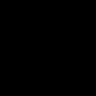

cam_1


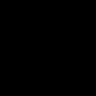

crf_la_0


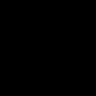

crf_la_1


crf_la_2


Iter: 4000/21240 Loss:0.6931 imps:328.7 Fin:Mon Jul 12 20:49:07 2021 lr: 0.0083
example


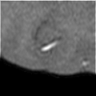

cam_0


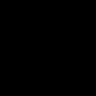

cam_1


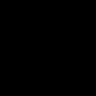

crf_la_0


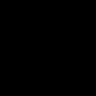

crf_la_1


crf_la_2


Iter: 4050/21240 Loss:0.6931 imps:319.1 Fin:Mon Jul 12 20:49:07 2021 lr: 0.0083
example


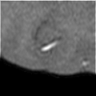

cam_0


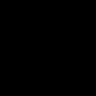

cam_1


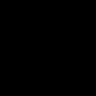

crf_la_0


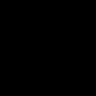

crf_la_1


crf_la_2


Iter: 4100/21240 Loss:0.6931 imps:310.4 Fin:Mon Jul 12 20:49:06 2021 lr: 0.0082
example


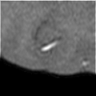

cam_0


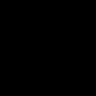

cam_1


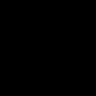

crf_la_0


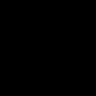

crf_la_1


crf_la_2


Iter: 4150/21240 Loss:0.6931 imps:302.3 Fin:Mon Jul 12 20:49:06 2021 lr: 0.0082
example


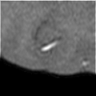

cam_0


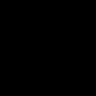

cam_1


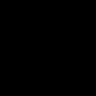

crf_la_0


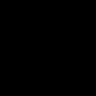

crf_la_1


crf_la_2


Iter: 4200/21240 Loss:0.6931 imps:294.7 Fin:Mon Jul 12 20:49:05 2021 lr: 0.0082
example


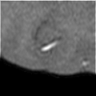

cam_0


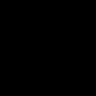

cam_1


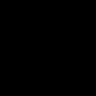

crf_la_0


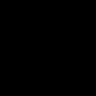

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter: 4250/21240 Loss:0.6931 imps:92569.7 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0082
example


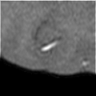

cam_0


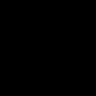

cam_1


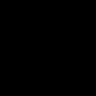

crf_la_0


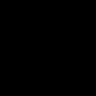

crf_la_1


crf_la_2


Iter: 4300/21240 Loss:0.6931 imps:7560.7 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0082
example


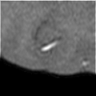

cam_0


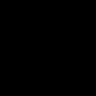

cam_1


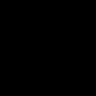

crf_la_0


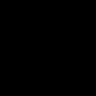

crf_la_1


crf_la_2


Iter: 4350/21240 Loss:0.6931 imps:3997.1 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0081
example


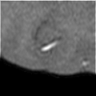

cam_0


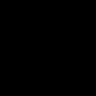

cam_1


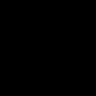

crf_la_0


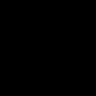

crf_la_1


crf_la_2


Iter: 4400/21240 Loss:0.6931 imps:2736.7 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0081
example


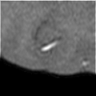

cam_0


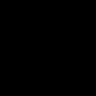

cam_1


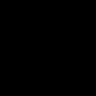

crf_la_0


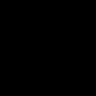

crf_la_1


crf_la_2


Iter: 4450/21240 Loss:0.6931 imps:2091.7 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0081
example


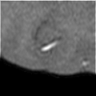

cam_0


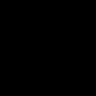

cam_1


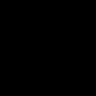

crf_la_0


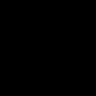

crf_la_1


crf_la_2


Iter: 4500/21240 Loss:0.6931 imps:1700.0 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0081
example


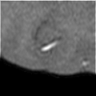

cam_0


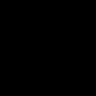

cam_1


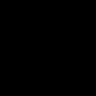

crf_la_0


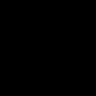

crf_la_1


crf_la_2


Iter: 4550/21240 Loss:0.6931 imps:1436.9 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0080
example


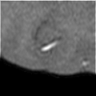

cam_0


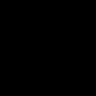

cam_1


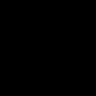

crf_la_0


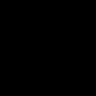

crf_la_1


crf_la_2


Iter: 4600/21240 Loss:0.6931 imps:1247.4 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0080
example


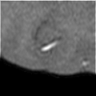

cam_0


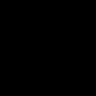

cam_1


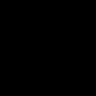

crf_la_0


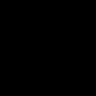

crf_la_1


crf_la_2


Iter: 4650/21240 Loss:0.6931 imps:1105.1 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0080
example


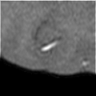

cam_0


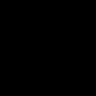

cam_1


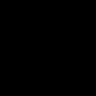

crf_la_0


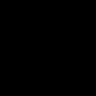

crf_la_1


crf_la_2


Iter: 4700/21240 Loss:0.6931 imps:994.0 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0080
example


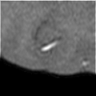

cam_0


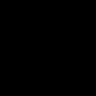

cam_1


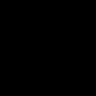

crf_la_0


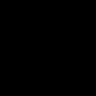

crf_la_1


crf_la_2


Iter: 4750/21240 Loss:0.6931 imps:905.1 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0080
example


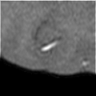

cam_0


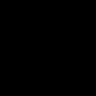

cam_1


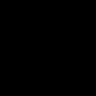

crf_la_0


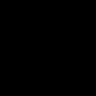

crf_la_1


crf_la_2


Iter: 4800/21240 Loss:0.6931 imps:832.1 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0079
example


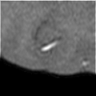

cam_0


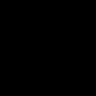

cam_1


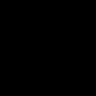

crf_la_0


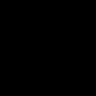

crf_la_1


crf_la_2


Iter: 4850/21240 Loss:0.6931 imps:771.3 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0079
example


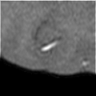

cam_0


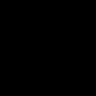

cam_1


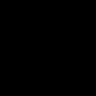

crf_la_0


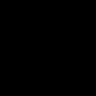

crf_la_1


crf_la_2


Iter: 4900/21240 Loss:0.6931 imps:719.8 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0079
example


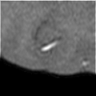

cam_0


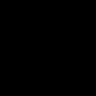

cam_1


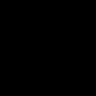

crf_la_0


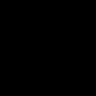

crf_la_1


crf_la_2


Iter: 4950/21240 Loss:0.6931 imps:675.6 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0079
example


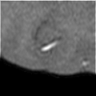

cam_0


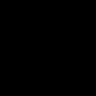

cam_1


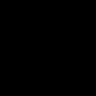

crf_la_0


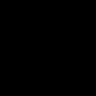

crf_la_1


crf_la_2


Iter: 5000/21240 Loss:0.6931 imps:637.1 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0079
example


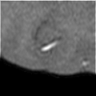

cam_0


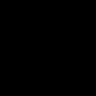

cam_1


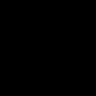

crf_la_0


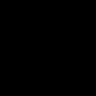

crf_la_1


crf_la_2


Iter: 5050/21240 Loss:0.6931 imps:603.5 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0078
example


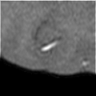

cam_0


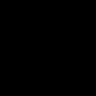

cam_1


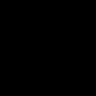

crf_la_0


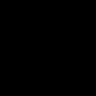

crf_la_1


crf_la_2


Iter: 5100/21240 Loss:0.6931 imps:573.7 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0078
example


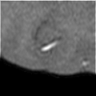

cam_0


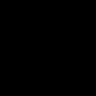

cam_1


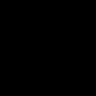

crf_la_0


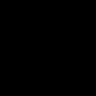

crf_la_1


crf_la_2


Iter: 5150/21240 Loss:0.6931 imps:547.4 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0078
example


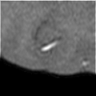

cam_0


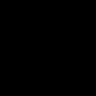

cam_1


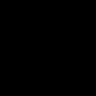

crf_la_0


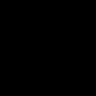

crf_la_1


crf_la_2


Iter: 5200/21240 Loss:0.6931 imps:523.8 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0078
example


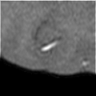

cam_0


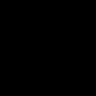

cam_1


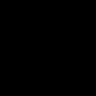

crf_la_0


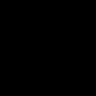

crf_la_1


crf_la_2


Iter: 5250/21240 Loss:0.6931 imps:502.5 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0077
example


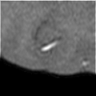

cam_0


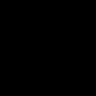

cam_1


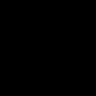

crf_la_0


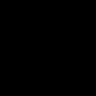

crf_la_1


crf_la_2


Iter: 5300/21240 Loss:0.6931 imps:483.3 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0077
example


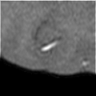

cam_0


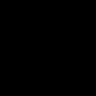

cam_1


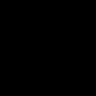

crf_la_0


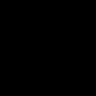

crf_la_1


crf_la_2


Iter: 5350/21240 Loss:0.6931 imps:465.7 Fin:Mon Jul 12 20:49:10 2021 lr: 0.0077
example


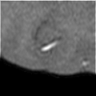

cam_0


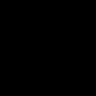

cam_1


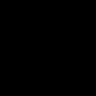

crf_la_0


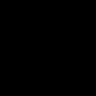

crf_la_1


crf_la_2


Iter: 5400/21240 Loss:0.6931 imps:449.7 Fin:Mon Jul 12 20:49:10 2021 lr: 0.0077
example


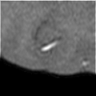

cam_0


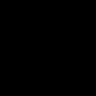

cam_1


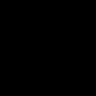

crf_la_0


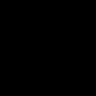

crf_la_1


crf_la_2


Iter: 5450/21240 Loss:0.6931 imps:435.0 Fin:Mon Jul 12 20:49:10 2021 lr: 0.0077
example


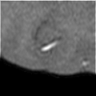

cam_0


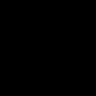

cam_1


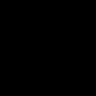

crf_la_0


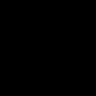

crf_la_1


crf_la_2


Iter: 5500/21240 Loss:0.6931 imps:421.5 Fin:Mon Jul 12 20:49:10 2021 lr: 0.0076
example


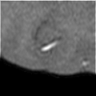

cam_0


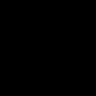

cam_1


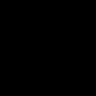

crf_la_0


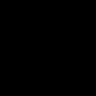

crf_la_1


crf_la_2


Iter: 5550/21240 Loss:0.6931 imps:409.1 Fin:Mon Jul 12 20:49:09 2021 lr: 0.0076
example


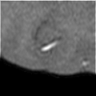

cam_0


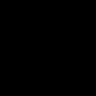

cam_1


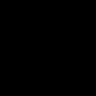

crf_la_0


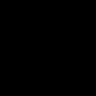

crf_la_1


crf_la_2


Iter: 5600/21240 Loss:0.6931 imps:397.5 Fin:Mon Jul 12 20:49:09 2021 lr: 0.0076
example


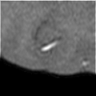

cam_0


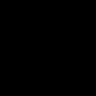

cam_1


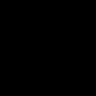

crf_la_0


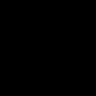

crf_la_1


crf_la_2


Iter: 5650/21240 Loss:0.6931 imps:386.8 Fin:Mon Jul 12 20:49:08 2021 lr: 0.0076
example


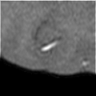

cam_0


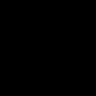

cam_1


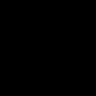

crf_la_0


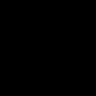

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter: 5700/21240 Loss:0.6931 imps:14554.1 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0075
example


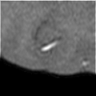

cam_0


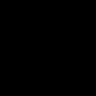

cam_1


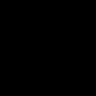

crf_la_0


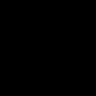

crf_la_1


crf_la_2


Iter: 5750/21240 Loss:0.6931 imps:6293.3 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0075
example


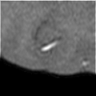

cam_0


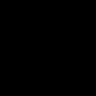

cam_1


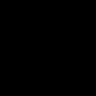

crf_la_0


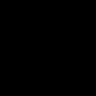

crf_la_1


crf_la_2


Iter: 5800/21240 Loss:0.6931 imps:4046.9 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0075
example


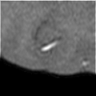

cam_0


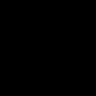

cam_1


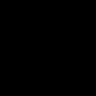

crf_la_0


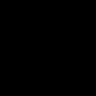

crf_la_1


crf_la_2


Iter: 5850/21240 Loss:0.6931 imps:2996.0 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0075
example


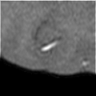

cam_0


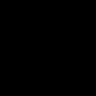

cam_1


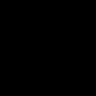

crf_la_0


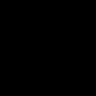

crf_la_1


crf_la_2


Iter: 5900/21240 Loss:0.6931 imps:2386.1 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0075
example


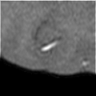

cam_0


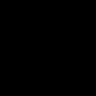

cam_1


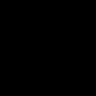

crf_la_0


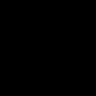

crf_la_1


crf_la_2


Iter: 5950/21240 Loss:0.6931 imps:1987.7 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0074
example


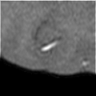

cam_0


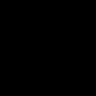

cam_1


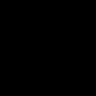

crf_la_0


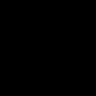

crf_la_1


crf_la_2


Iter: 6000/21240 Loss:0.6931 imps:1707.7 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0074
example


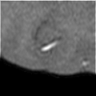

cam_0


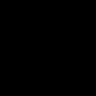

cam_1


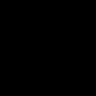

crf_la_0


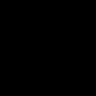

crf_la_1


crf_la_2


Iter: 6050/21240 Loss:0.6931 imps:1499.5 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0074
example


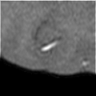

cam_0


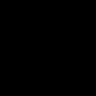

cam_1


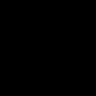

crf_la_0


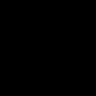

crf_la_1


crf_la_2


Iter: 6100/21240 Loss:0.6931 imps:1339.1 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0074
example


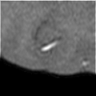

cam_0


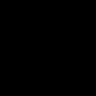

cam_1


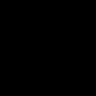

crf_la_0


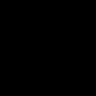

crf_la_1


crf_la_2


Iter: 6150/21240 Loss:0.6931 imps:1211.9 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0074
example


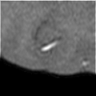

cam_0


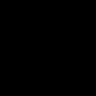

cam_1


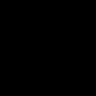

crf_la_0


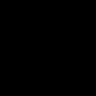

crf_la_1


crf_la_2


Iter: 6200/21240 Loss:0.6931 imps:1108.3 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0073
example


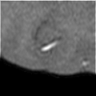

cam_0


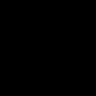

cam_1


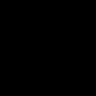

crf_la_0


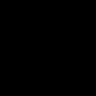

crf_la_1


crf_la_2


Iter: 6250/21240 Loss:0.6931 imps:1022.2 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0073
example


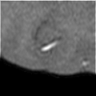

cam_0


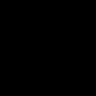

cam_1


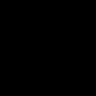

crf_la_0


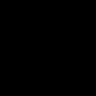

crf_la_1


crf_la_2


Iter: 6300/21240 Loss:0.6931 imps:949.6 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0073
example


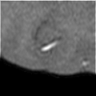

cam_0


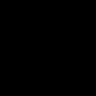

cam_1


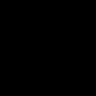

crf_la_0


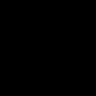

crf_la_1


crf_la_2


Iter: 6350/21240 Loss:0.6931 imps:887.5 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0073
example


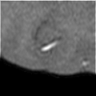

cam_0


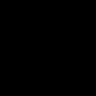

cam_1


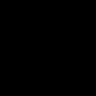

crf_la_0


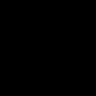

crf_la_1


crf_la_2


Iter: 6400/21240 Loss:0.6931 imps:833.8 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0072
example


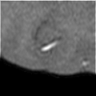

cam_0


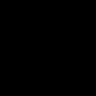

cam_1


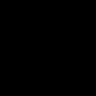

crf_la_0


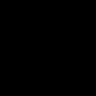

crf_la_1


crf_la_2


Iter: 6450/21240 Loss:0.6931 imps:787.0 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0072
example


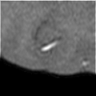

cam_0


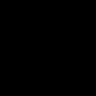

cam_1


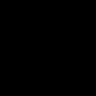

crf_la_0


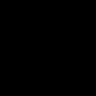

crf_la_1


crf_la_2


Iter: 6500/21240 Loss:0.6931 imps:745.8 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0072
example


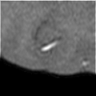

cam_0


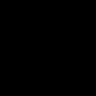

cam_1


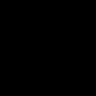

crf_la_0


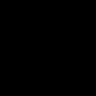

crf_la_1


crf_la_2


Iter: 6550/21240 Loss:0.6931 imps:709.2 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0072
example


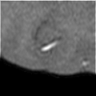

cam_0


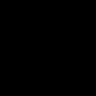

cam_1


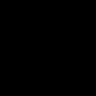

crf_la_0


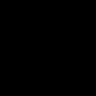

crf_la_1


crf_la_2


Iter: 6600/21240 Loss:0.6931 imps:676.5 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0072
example


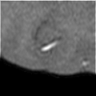

cam_0


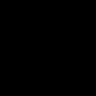

cam_1


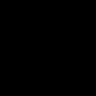

crf_la_0


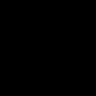

crf_la_1


crf_la_2


Iter: 6650/21240 Loss:0.6931 imps:647.2 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0071
example


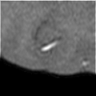

cam_0


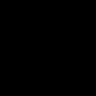

cam_1


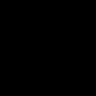

crf_la_0


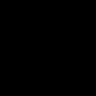

crf_la_1


crf_la_2


Iter: 6700/21240 Loss:0.6931 imps:620.7 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0071
example


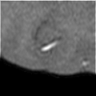

cam_0


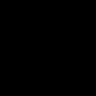

cam_1


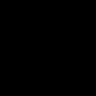

crf_la_0


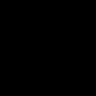

crf_la_1


crf_la_2


Iter: 6750/21240 Loss:0.6931 imps:596.5 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0071
example


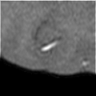

cam_0


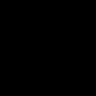

cam_1


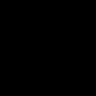

crf_la_0


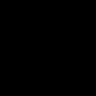

crf_la_1


crf_la_2


Iter: 6800/21240 Loss:0.6931 imps:574.5 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0071
example


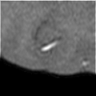

cam_0


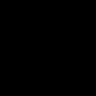

cam_1


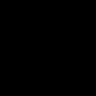

crf_la_0


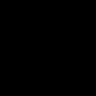

crf_la_1


crf_la_2


Iter: 6850/21240 Loss:0.6931 imps:554.3 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0070
example


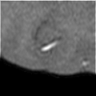

cam_0


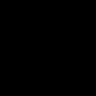

cam_1


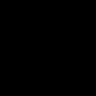

crf_la_0


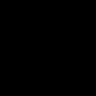

crf_la_1


crf_la_2


Iter: 6900/21240 Loss:0.6931 imps:535.8 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0070
example


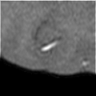

cam_0


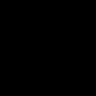

cam_1


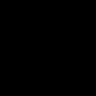

crf_la_0


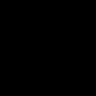

crf_la_1


crf_la_2


Iter: 6950/21240 Loss:0.6931 imps:518.8 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0070
example


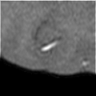

cam_0


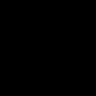

cam_1


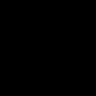

crf_la_0


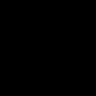

crf_la_1


crf_la_2


Iter: 7000/21240 Loss:0.6931 imps:503.0 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0070
example


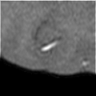

cam_0


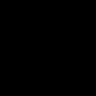

cam_1


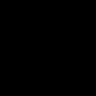

crf_la_0


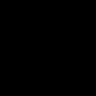

crf_la_1


crf_la_2


Iter: 7050/21240 Loss:0.6931 imps:488.3 Fin:Mon Jul 12 20:49:11 2021 lr: 0.0070
example


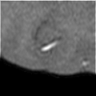

cam_0


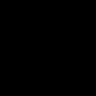

cam_1


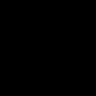

crf_la_0


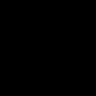

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter: 7100/21240 Loss:0.6931 imps:30893.2 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0069
example


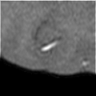

cam_0


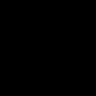

cam_1


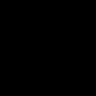

crf_la_0


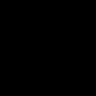

crf_la_1


crf_la_2


Iter: 7150/21240 Loss:0.6931 imps:9492.2 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0069
example


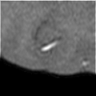

cam_0


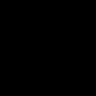

cam_1


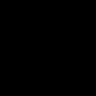

crf_la_0


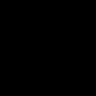

crf_la_1


crf_la_2


Iter: 7200/21240 Loss:0.6931 imps:5652.6 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0069
example


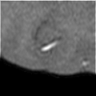

cam_0


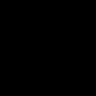

cam_1


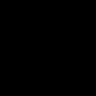

crf_la_0


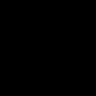

crf_la_1


crf_la_2


Iter: 7250/21240 Loss:0.6931 imps:4039.6 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0069
example


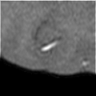

cam_0


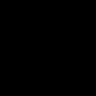

cam_1


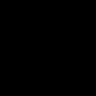

crf_la_0


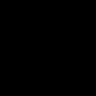

crf_la_1


crf_la_2


Iter: 7300/21240 Loss:0.6931 imps:3152.3 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0068
example


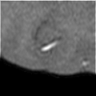

cam_0


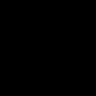

cam_1


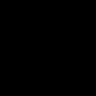

crf_la_0


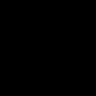

crf_la_1


crf_la_2


Iter: 7350/21240 Loss:0.6931 imps:2591.4 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0068
example


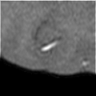

cam_0


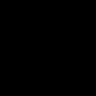

cam_1


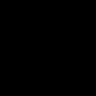

crf_la_0


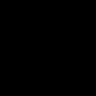

crf_la_1


crf_la_2


Iter: 7400/21240 Loss:0.6931 imps:2204.8 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0068
example


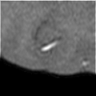

cam_0


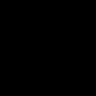

cam_1


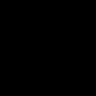

crf_la_0


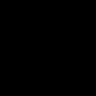

crf_la_1


crf_la_2


Iter: 7450/21240 Loss:0.6931 imps:1921.8 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0068
example


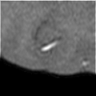

cam_0


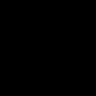

cam_1


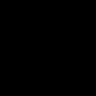

crf_la_0


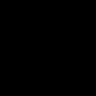

crf_la_1


crf_la_2


Iter: 7500/21240 Loss:0.6931 imps:1705.7 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0068
example


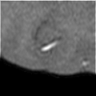

cam_0


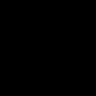

cam_1


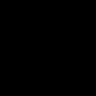

crf_la_0


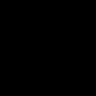

crf_la_1


crf_la_2


Iter: 7550/21240 Loss:0.6931 imps:1535.5 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0067
example


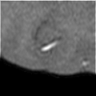

cam_0


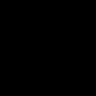

cam_1


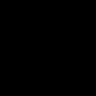

crf_la_0


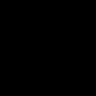

crf_la_1


crf_la_2


Iter: 7600/21240 Loss:0.6931 imps:1397.9 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0067
example


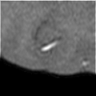

cam_0


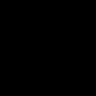

cam_1


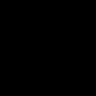

crf_la_0


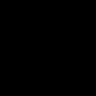

crf_la_1


crf_la_2


Iter: 7650/21240 Loss:0.6931 imps:1284.1 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0067
example


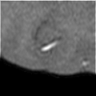

cam_0


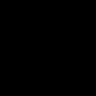

cam_1


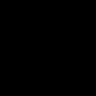

crf_la_0


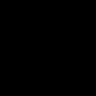

crf_la_1


crf_la_2


Iter: 7700/21240 Loss:0.6931 imps:1188.8 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0067
example


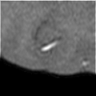

cam_0


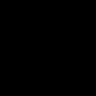

cam_1


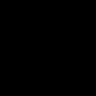

crf_la_0


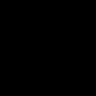

crf_la_1


crf_la_2


Iter: 7750/21240 Loss:0.6931 imps:1107.5 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0066
example


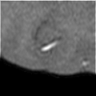

cam_0


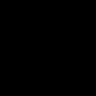

cam_1


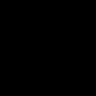

crf_la_0


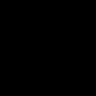

crf_la_1


crf_la_2


Iter: 7800/21240 Loss:0.6931 imps:1037.5 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0066
example


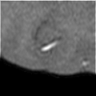

cam_0


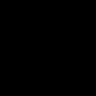

cam_1


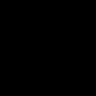

crf_la_0


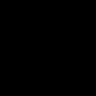

crf_la_1


crf_la_2


Iter: 7850/21240 Loss:0.6931 imps:976.4 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0066
example


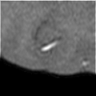

cam_0


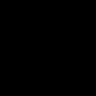

cam_1


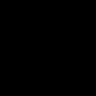

crf_la_0


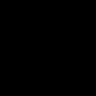

crf_la_1


crf_la_2


Iter: 7900/21240 Loss:0.6931 imps:923.0 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0066
example


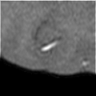

cam_0


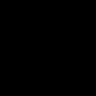

cam_1


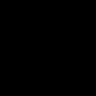

crf_la_0


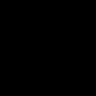

crf_la_1


crf_la_2


Iter: 7950/21240 Loss:0.6931 imps:875.6 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0066
example


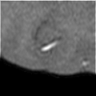

cam_0


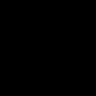

cam_1


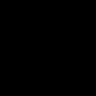

crf_la_0


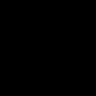

crf_la_1


crf_la_2


Iter: 8000/21240 Loss:0.6931 imps:833.3 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0065
example


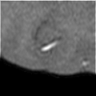

cam_0


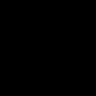

cam_1


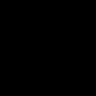

crf_la_0


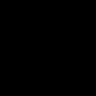

crf_la_1


crf_la_2


Iter: 8050/21240 Loss:0.6931 imps:795.5 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0065
example


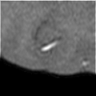

cam_0


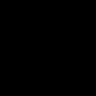

cam_1


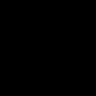

crf_la_0


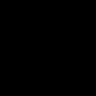

crf_la_1


crf_la_2


Iter: 8100/21240 Loss:0.6931 imps:761.3 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0065
example


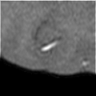

cam_0


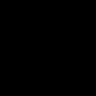

cam_1


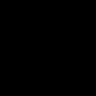

crf_la_0


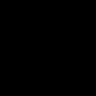

crf_la_1


crf_la_2


Iter: 8150/21240 Loss:0.6931 imps:730.3 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0065
example


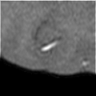

cam_0


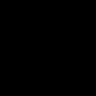

cam_1


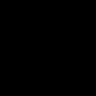

crf_la_0


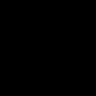

crf_la_1


crf_la_2


Iter: 8200/21240 Loss:0.6931 imps:702.0 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0064
example


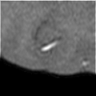

cam_0


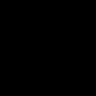

cam_1


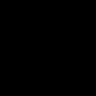

crf_la_0


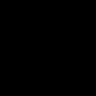

crf_la_1


crf_la_2


Iter: 8250/21240 Loss:0.6931 imps:676.2 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0064
example


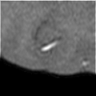

cam_0


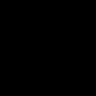

cam_1


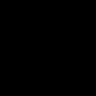

crf_la_0


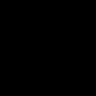

crf_la_1


crf_la_2


Iter: 8300/21240 Loss:0.6931 imps:652.5 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0064
example


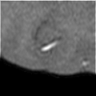

cam_0


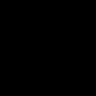

cam_1


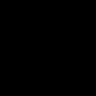

crf_la_0


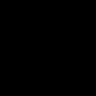

crf_la_1


crf_la_2


Iter: 8350/21240 Loss:0.6931 imps:630.6 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0064
example


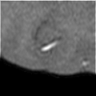

cam_0


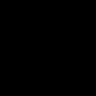

cam_1


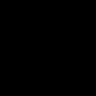

crf_la_0


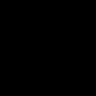

crf_la_1


crf_la_2


Iter: 8400/21240 Loss:0.6931 imps:610.4 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0064
example


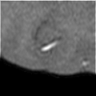

cam_0


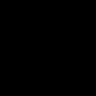

cam_1


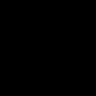

crf_la_0


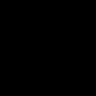

crf_la_1


crf_la_2


Iter: 8450/21240 Loss:0.6931 imps:591.7 Fin:Mon Jul 12 20:49:12 2021 lr: 0.0063
example


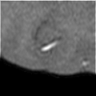

cam_0


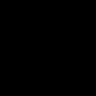

cam_1


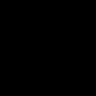

crf_la_0


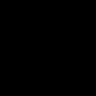

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter: 8500/21240 Loss:0.6931 imps:128810.0 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0063
example


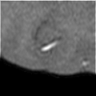

cam_0


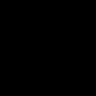

cam_1


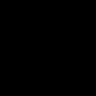

crf_la_0


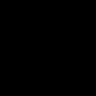

crf_la_1


crf_la_2


Iter: 8550/21240 Loss:0.6931 imps:14522.4 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0063
example


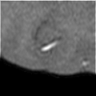

cam_0


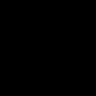

cam_1


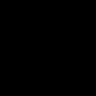

crf_la_0


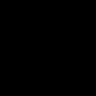

crf_la_1


crf_la_2


Iter: 8600/21240 Loss:0.6931 imps:7754.1 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0063
example


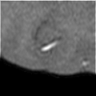

cam_0


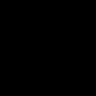

cam_1


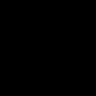

crf_la_0


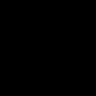

crf_la_1


crf_la_2


Iter: 8650/21240 Loss:0.6931 imps:5309.3 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0062
example


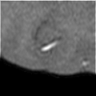

cam_0


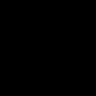

cam_1


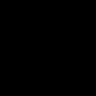

crf_la_0


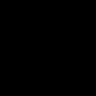

crf_la_1


crf_la_2


Iter: 8700/21240 Loss:0.6931 imps:4049.3 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0062
example


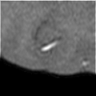

cam_0


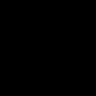

cam_1


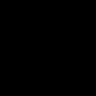

crf_la_0


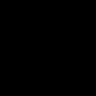

crf_la_1


crf_la_2


Iter: 8750/21240 Loss:0.6931 imps:3278.9 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0062
example


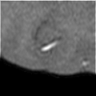

cam_0


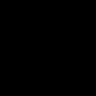

cam_1


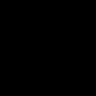

crf_la_0


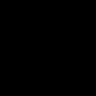

crf_la_1


crf_la_2


Iter: 8800/21240 Loss:0.6931 imps:2760.4 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0062
example


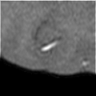

cam_0


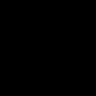

cam_1


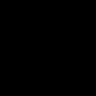

crf_la_0


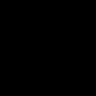

crf_la_1


crf_la_2


Iter: 8850/21240 Loss:0.6931 imps:2386.9 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0062
example


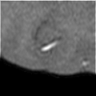

cam_0


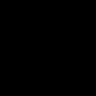

cam_1


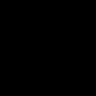

crf_la_0


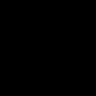

crf_la_1


crf_la_2


Iter: 8900/21240 Loss:0.6931 imps:2104.7 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0061
example


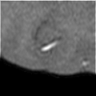

cam_0


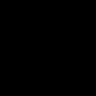

cam_1


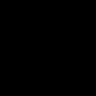

crf_la_0


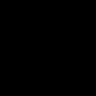

crf_la_1


crf_la_2


Iter: 8950/21240 Loss:0.6931 imps:1884.6 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0061
example


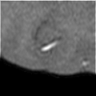

cam_0


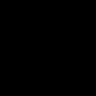

cam_1


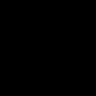

crf_la_0


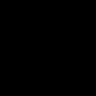

crf_la_1


crf_la_2


Iter: 9000/21240 Loss:0.6931 imps:1707.8 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0061
example


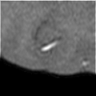

cam_0


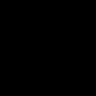

cam_1


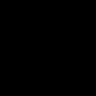

crf_la_0


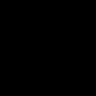

crf_la_1


crf_la_2


Iter: 9050/21240 Loss:0.6931 imps:1562.9 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0061
example


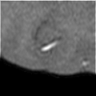

cam_0


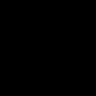

cam_1


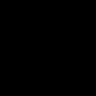

crf_la_0


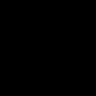

crf_la_1


crf_la_2


Iter: 9100/21240 Loss:0.6931 imps:1442.0 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0060
example


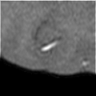

cam_0


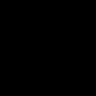

cam_1


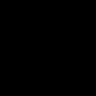

crf_la_0


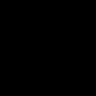

crf_la_1


crf_la_2


Iter: 9150/21240 Loss:0.6931 imps:1339.8 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0060
example


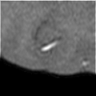

cam_0


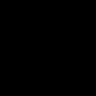

cam_1


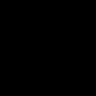

crf_la_0


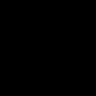

crf_la_1


crf_la_2


Iter: 9200/21240 Loss:0.6931 imps:1251.8 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0060
example


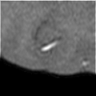

cam_0


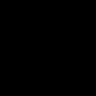

cam_1


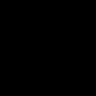

crf_la_0


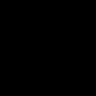

crf_la_1


crf_la_2


Iter: 9250/21240 Loss:0.6931 imps:1175.5 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0060
example


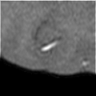

cam_0


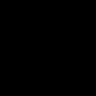

cam_1


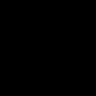

crf_la_0


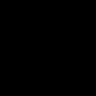

crf_la_1


crf_la_2


Iter: 9300/21240 Loss:0.6931 imps:1108.5 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0060
example


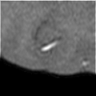

cam_0


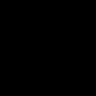

cam_1


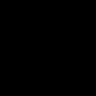

crf_la_0


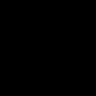

crf_la_1


crf_la_2


Iter: 9350/21240 Loss:0.6931 imps:1049.4 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0059
example


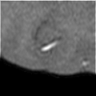

cam_0


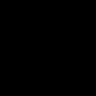

cam_1


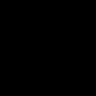

crf_la_0


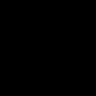

crf_la_1


crf_la_2


Iter: 9400/21240 Loss:0.6931 imps:996.8 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0059
example


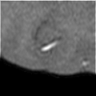

cam_0


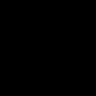

cam_1


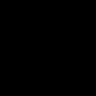

crf_la_0


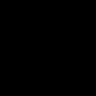

crf_la_1


crf_la_2


Iter: 9450/21240 Loss:0.6931 imps:949.8 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0059
example


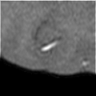

cam_0


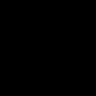

cam_1


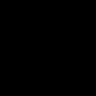

crf_la_0


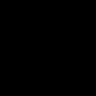

crf_la_1


crf_la_2


Iter: 9500/21240 Loss:0.6931 imps:907.3 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0059
example


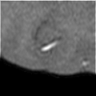

cam_0


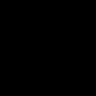

cam_1


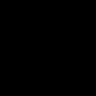

crf_la_0


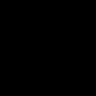

crf_la_1


crf_la_2


Iter: 9550/21240 Loss:0.6931 imps:868.9 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0058
example


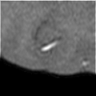

cam_0


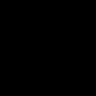

cam_1


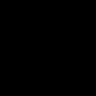

crf_la_0


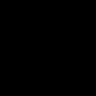

crf_la_1


crf_la_2


Iter: 9600/21240 Loss:0.6931 imps:834.0 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0058
example


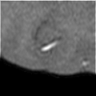

cam_0


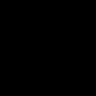

cam_1


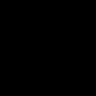

crf_la_0


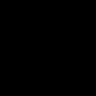

crf_la_1


crf_la_2


Iter: 9650/21240 Loss:0.6931 imps:802.1 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0058
example


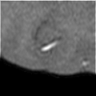

cam_0


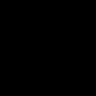

cam_1


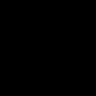

crf_la_0


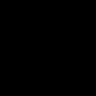

crf_la_1


crf_la_2


Iter: 9700/21240 Loss:0.6931 imps:772.8 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0058
example


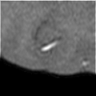

cam_0


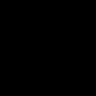

cam_1


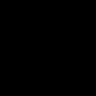

crf_la_0


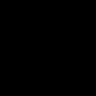

crf_la_1


crf_la_2


Iter: 9750/21240 Loss:0.6931 imps:745.9 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0058
example


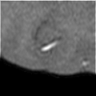

cam_0


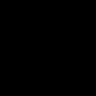

cam_1


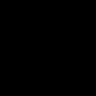

crf_la_0


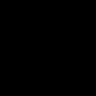

crf_la_1


crf_la_2


Iter: 9800/21240 Loss:0.6931 imps:721.1 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0057
example


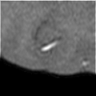

cam_0


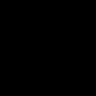

cam_1


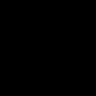

crf_la_0


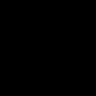

crf_la_1


crf_la_2


Iter: 9850/21240 Loss:0.6931 imps:698.1 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0057
example


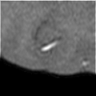

cam_0


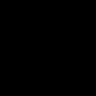

cam_1


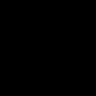

crf_la_0


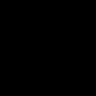

crf_la_1


crf_la_2


Iter: 9900/21240 Loss:0.6931 imps:676.7 Fin:Mon Jul 12 20:49:13 2021 lr: 0.0057
example


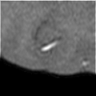

cam_0


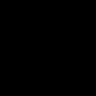

cam_1


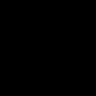

crf_la_0


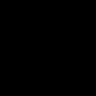

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter: 9950/21240 Loss:0.6931 imps:24146.2 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0057
example


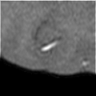

cam_0


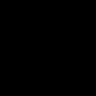

cam_1


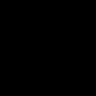

crf_la_0


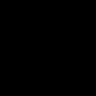

crf_la_1


crf_la_2


Iter:10000/21240 Loss:0.6931 imps:10673.1 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0056
example


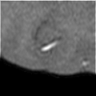

cam_0


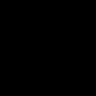

cam_1


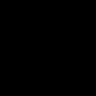

crf_la_0


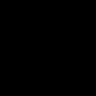

crf_la_1


crf_la_2


Iter:10050/21240 Loss:0.6931 imps:6899.3 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0056
example


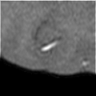

cam_0


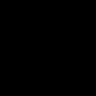

cam_1


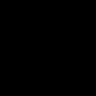

crf_la_0


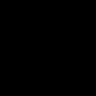

crf_la_1


crf_la_2


Iter:10100/21240 Loss:0.6931 imps:5109.8 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0056
example


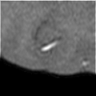

cam_0


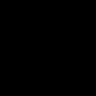

cam_1


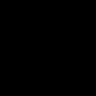

crf_la_0


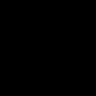

crf_la_1


crf_la_2


Iter:10150/21240 Loss:0.6931 imps:4066.0 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0056
example


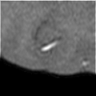

cam_0


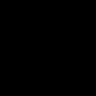

cam_1


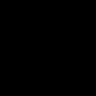

crf_la_0


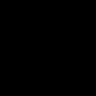

crf_la_1


crf_la_2


Iter:10200/21240 Loss:0.6931 imps:3381.7 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0055
example


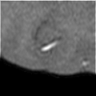

cam_0


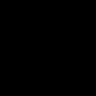

cam_1


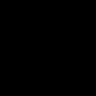

crf_la_0


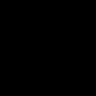

crf_la_1


crf_la_2


Iter:10250/21240 Loss:0.6931 imps:2898.8 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0055
example


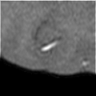

cam_0


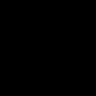

cam_1


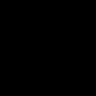

crf_la_0


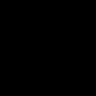

crf_la_1


crf_la_2


Iter:10300/21240 Loss:0.6931 imps:2538.8 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0055
example


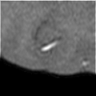

cam_0


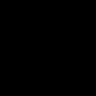

cam_1


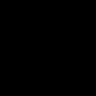

crf_la_0


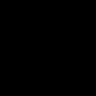

crf_la_1


crf_la_2


Iter:10350/21240 Loss:0.6931 imps:2261.1 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0055
example


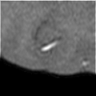

cam_0


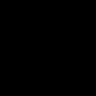

cam_1


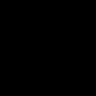

crf_la_0


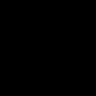

crf_la_1


crf_la_2


Iter:10400/21240 Loss:0.6931 imps:2039.8 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0055
example


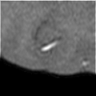

cam_0


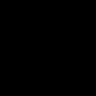

cam_1


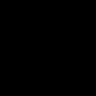

crf_la_0


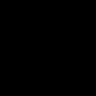

crf_la_1


crf_la_2


Iter:10450/21240 Loss:0.6931 imps:1859.6 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0054
example


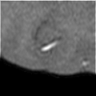

cam_0


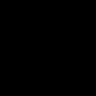

cam_1


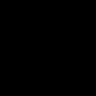

crf_la_0


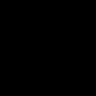

crf_la_1


crf_la_2


Iter:10500/21240 Loss:0.6931 imps:1710.3 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0054
example


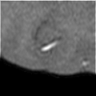

cam_0


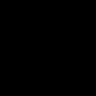

cam_1


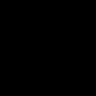

crf_la_0


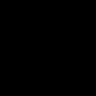

crf_la_1


crf_la_2


Iter:10550/21240 Loss:0.6931 imps:1584.3 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0054
example


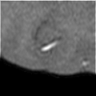

cam_0


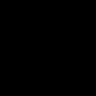

cam_1


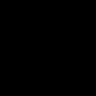

crf_la_0


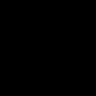

crf_la_1


crf_la_2


Iter:10600/21240 Loss:0.6931 imps:1476.6 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0054
example


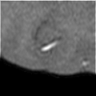

cam_0


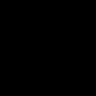

cam_1


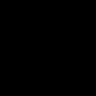

crf_la_0


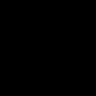

crf_la_1


crf_la_2


Iter:10650/21240 Loss:0.6931 imps:1383.2 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0053
example


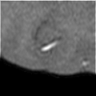

cam_0


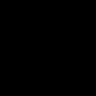

cam_1


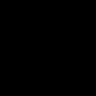

crf_la_0


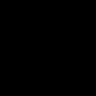

crf_la_1


crf_la_2


Iter:10700/21240 Loss:0.6931 imps:1301.6 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0053
example


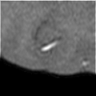

cam_0


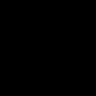

cam_1


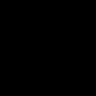

crf_la_0


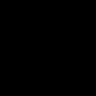

crf_la_1


crf_la_2


Iter:10750/21240 Loss:0.6931 imps:1229.8 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0053
example


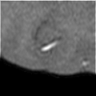

cam_0


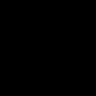

cam_1


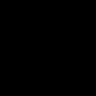

crf_la_0


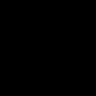

crf_la_1


crf_la_2


Iter:10800/21240 Loss:0.6931 imps:1166.1 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0053
example


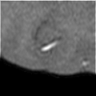

cam_0


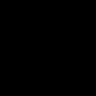

cam_1


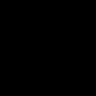

crf_la_0


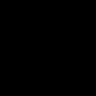

crf_la_1


crf_la_2


Iter:10850/21240 Loss:0.6931 imps:1109.2 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0053
example


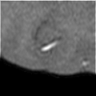

cam_0


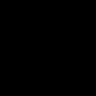

cam_1


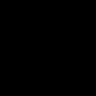

crf_la_0


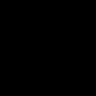

crf_la_1


crf_la_2


Iter:10900/21240 Loss:0.6931 imps:1058.1 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0052
example


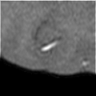

cam_0


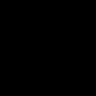

cam_1


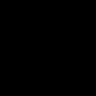

crf_la_0


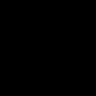

crf_la_1


crf_la_2


Iter:10950/21240 Loss:0.6931 imps:1011.9 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0052
example


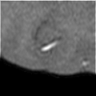

cam_0


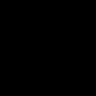

cam_1


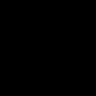

crf_la_0


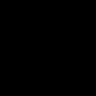

crf_la_1


crf_la_2


Iter:11000/21240 Loss:0.6931 imps:970.0 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0052
example


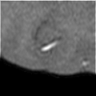

cam_0


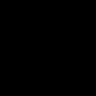

cam_1


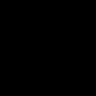

crf_la_0


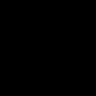

crf_la_1


crf_la_2


Iter:11050/21240 Loss:0.6931 imps:931.6 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0052
example


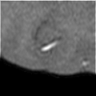

cam_0


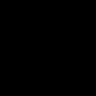

cam_1


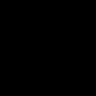

crf_la_0


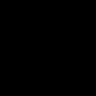

crf_la_1


crf_la_2


Iter:11100/21240 Loss:0.6931 imps:896.4 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0051
example


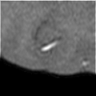

cam_0


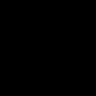

cam_1


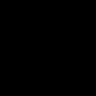

crf_la_0


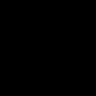

crf_la_1


crf_la_2


Iter:11150/21240 Loss:0.6931 imps:864.1 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0051
example


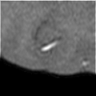

cam_0


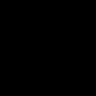

cam_1


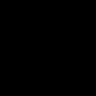

crf_la_0


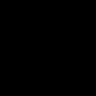

crf_la_1


crf_la_2


Iter:11200/21240 Loss:0.6931 imps:834.4 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0051
example


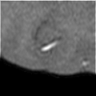

cam_0


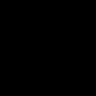

cam_1


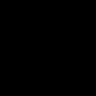

crf_la_0


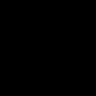

crf_la_1


crf_la_2


Iter:11250/21240 Loss:0.6931 imps:806.9 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0051
example


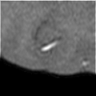

cam_0


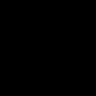

cam_1


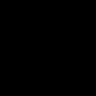

crf_la_0


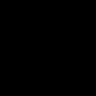

crf_la_1


crf_la_2


Iter:11300/21240 Loss:0.6931 imps:781.3 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0050
example


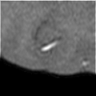

cam_0


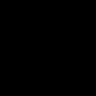

cam_1


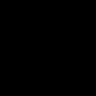

crf_la_0


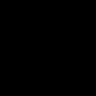

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter:11350/21240 Loss:0.6931 imps:45663.5 Fin:Mon Jul 12 20:49:20 2021 lr: 0.0050
example


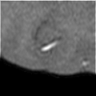

cam_0


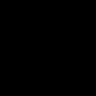

cam_1


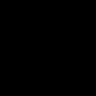

crf_la_0


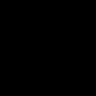

crf_la_1


crf_la_2


Iter:11400/21240 Loss:0.6931 imps:14795.6 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0050
example


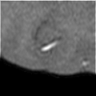

cam_0


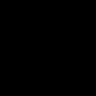

cam_1


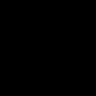

crf_la_0


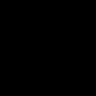

crf_la_1


crf_la_2


Iter:11450/21240 Loss:0.6931 imps:8873.9 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0050
example


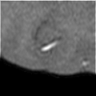

cam_0


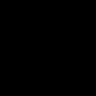

cam_1


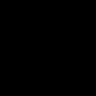

crf_la_0


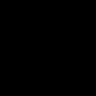

crf_la_1


crf_la_2


Iter:11500/21240 Loss:0.6931 imps:6355.7 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0050
example


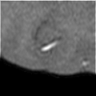

cam_0


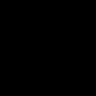

cam_1


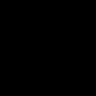

crf_la_0


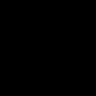

crf_la_1


crf_la_2


Iter:11550/21240 Loss:0.6931 imps:4959.7 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0049
example


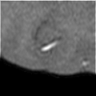

cam_0


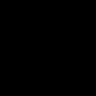

cam_1


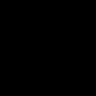

crf_la_0


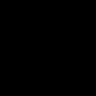

crf_la_1


crf_la_2


Iter:11600/21240 Loss:0.6931 imps:4072.0 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0049
example


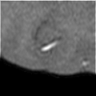

cam_0


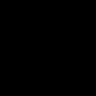

cam_1


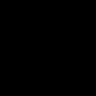

crf_la_0


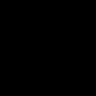

crf_la_1


crf_la_2


Iter:11650/21240 Loss:0.6931 imps:3457.2 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0049
example


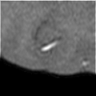

cam_0


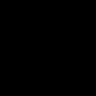

cam_1


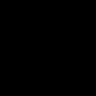

crf_la_0


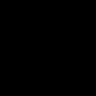

crf_la_1


crf_la_2


Iter:11700/21240 Loss:0.6931 imps:3007.0 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0049
example


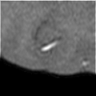

cam_0


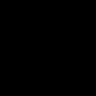

cam_1


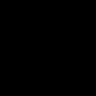

crf_la_0


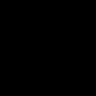

crf_la_1


crf_la_2


Iter:11750/21240 Loss:0.6931 imps:2663.6 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0048
example


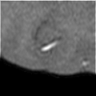

cam_0


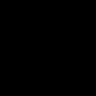

cam_1


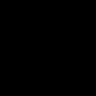

crf_la_0


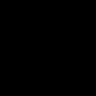

crf_la_1


crf_la_2


Iter:11800/21240 Loss:0.6931 imps:2392.6 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0048
example


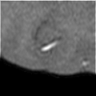

cam_0


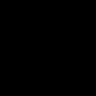

cam_1


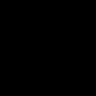

crf_la_0


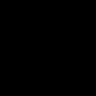

crf_la_1


crf_la_2


Iter:11850/21240 Loss:0.6931 imps:2173.9 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0048
example


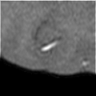

cam_0


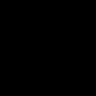

cam_1


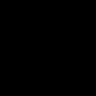

crf_la_0


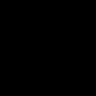

crf_la_1


crf_la_2


Iter:11900/21240 Loss:0.6931 imps:1993.1 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0048
example


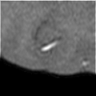

cam_0


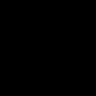

cam_1


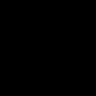

crf_la_0


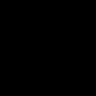

crf_la_1


crf_la_2


Iter:11950/21240 Loss:0.6931 imps:1841.4 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0048
example


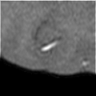

cam_0


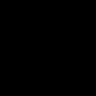

cam_1


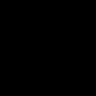

crf_la_0


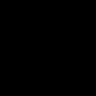

crf_la_1


crf_la_2


Iter:12000/21240 Loss:0.6931 imps:1712.0 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0047
example


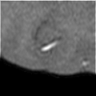

cam_0


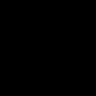

cam_1


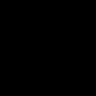

crf_la_0


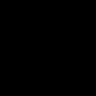

crf_la_1


crf_la_2


Iter:12050/21240 Loss:0.6931 imps:1600.2 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0047
example


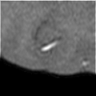

cam_0


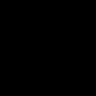

cam_1


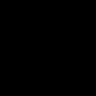

crf_la_0


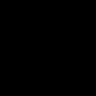

crf_la_1


crf_la_2


Iter:12100/21240 Loss:0.6931 imps:1503.1 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0047
example


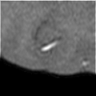

cam_0


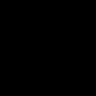

cam_1


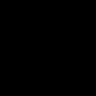

crf_la_0


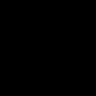

crf_la_1


crf_la_2


Iter:12150/21240 Loss:0.6931 imps:1417.6 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0047
example


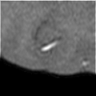

cam_0


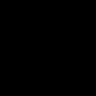

cam_1


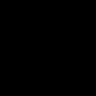

crf_la_0


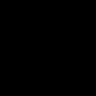

crf_la_1


crf_la_2


Iter:12200/21240 Loss:0.6931 imps:1342.1 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0046
example


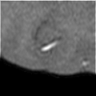

cam_0


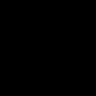

cam_1


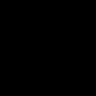

crf_la_0


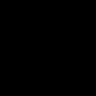

crf_la_1


crf_la_2


Iter:12250/21240 Loss:0.6931 imps:1274.8 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0046
example


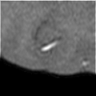

cam_0


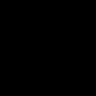

cam_1


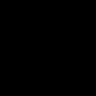

crf_la_0


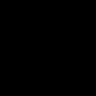

crf_la_1


crf_la_2


Iter:12300/21240 Loss:0.6931 imps:1214.3 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0046
example


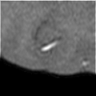

cam_0


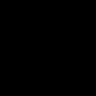

cam_1


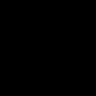

crf_la_0


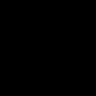

crf_la_1


crf_la_2


Iter:12350/21240 Loss:0.6931 imps:1159.8 Fin:Mon Jul 12 20:49:16 2021 lr: 0.0046
example


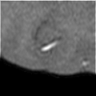

cam_0


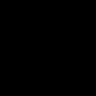

cam_1


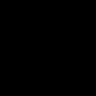

crf_la_0


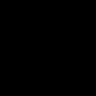

crf_la_1


crf_la_2


Iter:12400/21240 Loss:0.6931 imps:1110.3 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0045
example


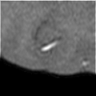

cam_0


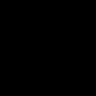

cam_1


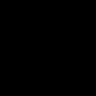

crf_la_0


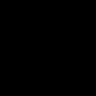

crf_la_1


crf_la_2


Iter:12450/21240 Loss:0.6931 imps:1065.1 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0045
example


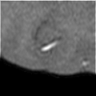

cam_0


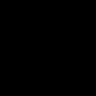

cam_1


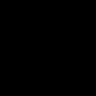

crf_la_0


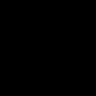

crf_la_1


crf_la_2


Iter:12500/21240 Loss:0.6931 imps:1023.8 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0045
example


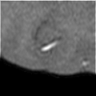

cam_0


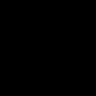

cam_1


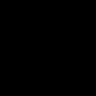

crf_la_0


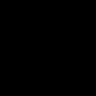

crf_la_1


crf_la_2


Iter:12550/21240 Loss:0.6931 imps:985.8 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0045
example


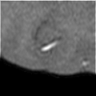

cam_0


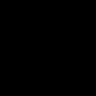

cam_1


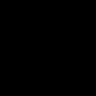

crf_la_0


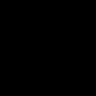

crf_la_1


crf_la_2


Iter:12600/21240 Loss:0.6931 imps:950.9 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0045
example


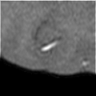

cam_0


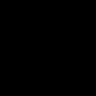

cam_1


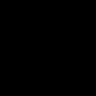

crf_la_0


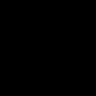

crf_la_1


crf_la_2


Iter:12650/21240 Loss:0.6931 imps:918.7 Fin:Mon Jul 12 20:49:15 2021 lr: 0.0044
example


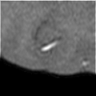

cam_0


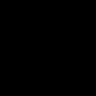

cam_1


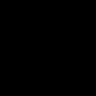

crf_la_0


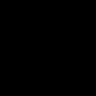

crf_la_1


crf_la_2


Iter:12700/21240 Loss:0.6931 imps:888.8 Fin:Mon Jul 12 20:49:14 2021 lr: 0.0044
example


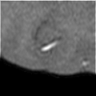

cam_0


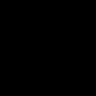

cam_1


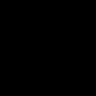

crf_la_0


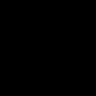

crf_la_1


crf_la_2



validating ... loss: 0.6931471824645996
Iter:12750/21240 Loss:0.6931 imps:147504.9 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0044
example


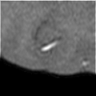

cam_0


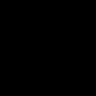

cam_1


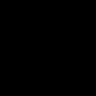

crf_la_0


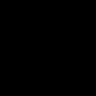

crf_la_1


crf_la_2


Iter:12800/21240 Loss:0.6931 imps:21001.9 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0044
example


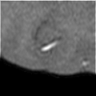

cam_0


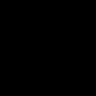

cam_1


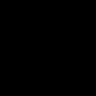

crf_la_0


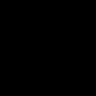

crf_la_1


crf_la_2


Iter:12850/21240 Loss:0.6931 imps:11376.4 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0043
example


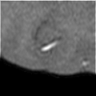

cam_0


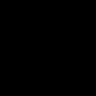

cam_1


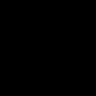

crf_la_0


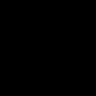

crf_la_1


crf_la_2


Iter:12900/21240 Loss:0.6931 imps:7821.3 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0043
example


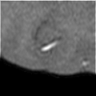

cam_0


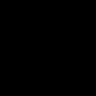

cam_1


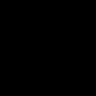

crf_la_0


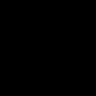

crf_la_1


crf_la_2


Iter:12950/21240 Loss:0.6931 imps:5969.0 Fin:Mon Jul 12 20:49:19 2021 lr: 0.0043
example


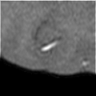

cam_0


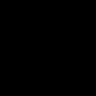

cam_1


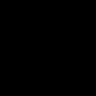

crf_la_0


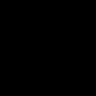

crf_la_1


crf_la_2


Iter:13000/21240 Loss:0.6931 imps:4833.5 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0043
example


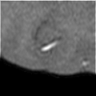

cam_0


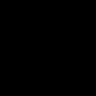

cam_1


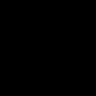

crf_la_0


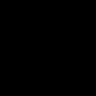

crf_la_1


crf_la_2


Iter:13050/21240 Loss:0.6931 imps:4066.1 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0042
example


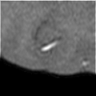

cam_0


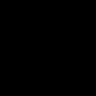

cam_1


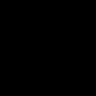

crf_la_0


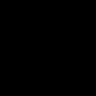

crf_la_1


crf_la_2


Iter:13100/21240 Loss:0.6931 imps:3511.8 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0042
example


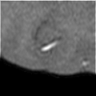

cam_0


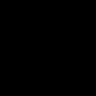

cam_1


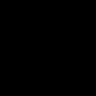

crf_la_0


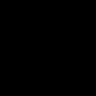

crf_la_1


crf_la_2


Iter:13150/21240 Loss:0.6931 imps:3094.1 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0042
example


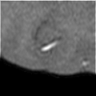

cam_0


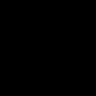

cam_1


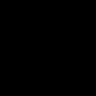

crf_la_0


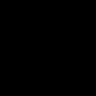

crf_la_1


crf_la_2


Iter:13200/21240 Loss:0.6931 imps:2767.7 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0042
example


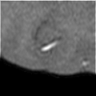

cam_0


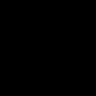

cam_1


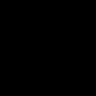

crf_la_0


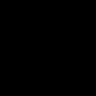

crf_la_1


crf_la_2


Iter:13250/21240 Loss:0.6931 imps:2504.8 Fin:Mon Jul 12 20:49:18 2021 lr: 0.0041
example


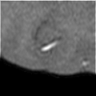

cam_0


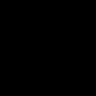

cam_1


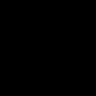

crf_la_0


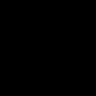

crf_la_1


crf_la_2


Iter:13300/21240 Loss:0.6931 imps:2289.5 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0041
example


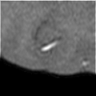

cam_0


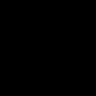

cam_1


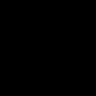

crf_la_0


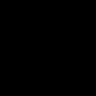

crf_la_1


crf_la_2


Iter:13350/21240 Loss:0.6931 imps:2109.3 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0041
example


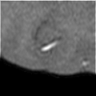

cam_0


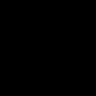

cam_1


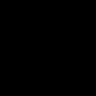

crf_la_0


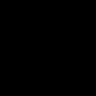

crf_la_1


crf_la_2


Iter:13400/21240 Loss:0.6931 imps:1956.3 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0041
example


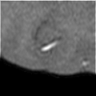

cam_0


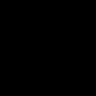

cam_1


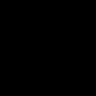

crf_la_0


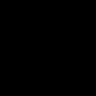

crf_la_1


crf_la_2


Iter:13450/21240 Loss:0.6931 imps:1825.0 Fin:Mon Jul 12 20:49:17 2021 lr: 0.0041
example


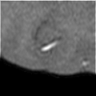

cam_0


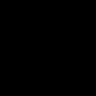

cam_1


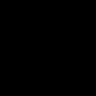

crf_la_0


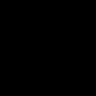

crf_la_1


crf_la_2


KeyboardInterrupt: ignored

In [ ]:
#!python3 train_cls.py --lr 0.01 --batch_size 16 --max_epoches 15 --crop_size 448 --wt_dec 5e-4 --voc12_root data/img #--network network.resnet38_cls #--weights [your_weights_file]

import numpy as np
import torch
from torch.backends import cudnn
cudnn.enabled = True
from torch.utils.data import DataLoader
from torchvision import transforms
import voc12.data
from tool import pyutils, imutils, torchutils
import argparse
import importlib
import torch.nn.functional as F

from voc12.captcha import *

def display_image(img,title=None):
  img = (img - np.min(img)) / (np.max(img) - np.min(img))
  img *= 255
  img = Image.fromarray(img.astype(np.uint8))
  if title: print(title)
  display(img)

def _crf_with_alpha(orig_img, v, alpha):
  bg_score = np.power(1 - np.max(v, axis=0, keepdims=True), alpha)
  bgcam_score = np.concatenate((bg_score, v), axis=0)
  crf_score = imutils.crf_inference(orig_img, bgcam_score, labels=bgcam_score.shape[0])

  n_crf_al = dict()

  n_crf_al[0] = crf_score[0]
  for i, key in enumerate([0,1]):
      n_crf_al[key+1] = crf_score[i+1]

  return n_crf_al


def validate(model, data_loader):
    print('\nvalidating ... ', flush=True, end='')

    val_loss_meter = pyutils.AverageMeter('loss')

    model.eval()

    with torch.no_grad():
        for pack in data_loader:
            img = pack[1]
            label = pack[2].cuda(non_blocking=True)

            x = model(img)
            loss = F.multilabel_soft_margin_loss(x, label)

            val_loss_meter.add({'loss': loss.item()})

    model.train()

    loss = val_loss_meter.pop('loss')

    print('loss:', loss)

    return loss

"""parser = argparse.ArgumentParser()
parser.add_argument("--batch_size", default=16, type=int)
parser.add_argument("--max_epoches", default=15, type=int)
parser.add_argument("--network", default="network.vgg16_cls", type=str)
parser.add_argument("--lr", default=0.1, type=float)
parser.add_argument("--num_workers", default=8, type=int)
parser.add_argument("--wt_dec", default=5e-4, type=float)
parser.add_argument("--weights", required=False, type=str)
parser.add_argument("--train_list", default="voc12/train_aug.txt", type=str)
parser.add_argument("--val_list", default="voc12/val.txt", type=str)
parser.add_argument("--session_name", default="vgg_cls", type=str)
parser.add_argument("--crop_size", default=448, type=int)
parser.add_argument("--voc12_root", required=True, type=str)
args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.batch_size = 16
args.max_epoches = 15
args.network = "network.vgg16_cls"
args.lr = 0.01
args.num_workers = 8
args.wt_dec = 5e-4
args.weights = "vgg_cls.pth"
args.train_list = "voc12/train_aug.txt"
args.val_list = "voc12/val.txt"
args.session_name = "vgg_cls"
args.crop_size = 92
args.voc12_root = "data/img"
args.voc12_root_val = "data/img_val"

model = getattr(importlib.import_module(args.network), 'Net')()

pyutils.Logger(args.session_name + '.log')

print(vars(args))

"""train_dataset = voc12.data.VOC12ClsDataset(args.train_list, voc12_root=args.voc12_root,
                                            transform=transforms.Compose([
                    imutils.RandomResizeLong(256, 512),
                    transforms.RandomHorizontalFlip(),
                    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
                    np.asarray,
                    model.normalize,
                    imutils.RandomCrop(args.crop_size),
                    imutils.HWC_to_CHW,
                    torch.from_numpy
                ]))

train_data_loader = DataLoader(train_dataset, batch_size=args.batch_size,
                                shuffle=True, num_workers=args.num_workers, pin_memory=True, drop_last=True)

val_dataset = voc12.data.VOC12ClsDataset(args.val_list, voc12_root=args.voc12_root,
                                          transform=transforms.Compose([
                    np.asarray,
                    model.normalize,
                    imutils.CenterCrop(500),
                    imutils.HWC_to_CHW,
                    torch.from_numpy
                ]))
val_data_loader = DataLoader(val_dataset, batch_size=args.batch_size,
                              shuffle=False, num_workers=args.num_workers, pin_memory=True, drop_last=True)"""


train_dataset = AllBrainImages(args.voc12_root,transform=transforms.Compose([
  #Standardize(234.08844113652563,174.22328263189004),
  #Normalize(0,3205),
  #RandomResizeLong(args.crop_size, args.crop_size),
  #CenterCrop(),
  OneHot(),
  ToTensor()
]))

train_data_loader = DataLoader(train_dataset, batch_size=args.batch_size,
                                shuffle=True, num_workers=args.num_workers, pin_memory=True, drop_last=True)

val_dataset = AllBrainImages(args.voc12_root_val,transform=transforms.Compose([
  #Standardize(234.08844113652563,174.22328263189004),
  #Normalize(0,3205),
  #RandomResizeLong(args.crop_size, args.crop_size),
  #CenterCrop(),
  OneHot(),
  ToTensor()
]))

val_data_loader = DataLoader(val_dataset, batch_size=args.batch_size,
                              shuffle=False, num_workers=args.num_workers, pin_memory=True, drop_last=True)


max_step = (len(train_dataset) // args.batch_size) * args.max_epoches

param_groups = model.get_parameter_groups()
optimizer = torchutils.PolyOptimizer([
    {'params': param_groups[0], 'lr': args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[1], 'lr': 2*args.lr, 'weight_decay': 0},
    {'params': param_groups[2], 'lr': 10*args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[3], 'lr': 20*args.lr, 'weight_decay': 0}
], lr=args.lr, weight_decay=args.wt_dec, max_step=max_step)

#optimizer = torch.optim.SGD(model.parameters(), lr=args.lr, momentum=.9)

if args.weights[-7:] == '.params':
    assert args.network == "network.resnet38_cls"
    import network.resnet38d
    weights_dict = network.resnet38d.convert_mxnet_to_torch(args.weights)
elif args.weights[-11:] == '.caffemodel':
    assert args.network == "network.vgg16_cls"
    import network.vgg16d
    weights_dict = network.vgg16d.convert_caffe_to_torch(args.weights)
else:
    weights_dict = torch.load(args.weights)

model.load_state_dict(weights_dict, strict=False)
model = torch.nn.DataParallel(model).cuda()
model.train()

avg_meter = pyutils.AverageMeter('loss')

timer = pyutils.Timer("Session started: ")

iter=0
validation_loss=np.inf

model_replicas = torch.nn.parallel.replicate(model, list(range(1)))
for ep in range(args.max_epoches):

    for slide_id, pack in enumerate(train_data_loader): 

        img = pack[1]
        label = pack[2].cuda(non_blocking=True)

        x = model(img)
        #print(torch.argmax(x,axis=1),torch.argmax(label,axis=1))
        loss = F.multilabel_soft_margin_loss(x, label)

        avg_meter.add({'loss': loss.item()})

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if (iter-1)%50 == 0:
            timer.update_progress(iter / max_step)

            print('Iter:%5d/%5d' % (iter - 1, max_step),
                  'Loss:%.4f' % (avg_meter.pop('loss')),
                  'imps:%.1f' % ((iter+1) * args.batch_size / timer.get_stage_elapsed()),
                  'Fin:%s' % (timer.str_est_finish()),
                  'lr: %.4f' % (optimizer.param_groups[0]['lr']), flush=True)
            torch.save(model.module.state_dict(), args.session_name + '.pth')

            example=np.load("example.npy")
            display_image(example,"example")
            cam = model.module.forward_cam(
                torch.tensor(example).float()[None,None,...].cuda()
            )
            cam = F.interpolate(cam, 96, mode='bilinear', align_corners=False)[0]
            cam = cam.cpu().detach().numpy()
            for k in range(len(cam)): display_image(cam[k],f"cam_{k}")
            crf_la = _crf_with_alpha(example, cam, 4)
            for k in crf_la: display_image(crf_la[k],f"crf_la_{k}")
            
        iter+=1

    else:
        current_validation_loss = validate(model, val_data_loader)
        if current_validation_loss < validation_loss:
            validation_loss = current_validation_loss
            torch.save(model.module.state_dict(), args.session_name + '.pth')
        timer.reset_stage()

#torch.save(model.module.state_dict(), args.session_name + '.pth')


In [ ]:
#!python3 train_cls.py --lr 0.01 --batch_size 16 --max_epoches 15 --crop_size 448 --wt_dec 5e-4 --voc12_root data/img #--network network.resnet38_cls #--weights [your_weights_file]

import numpy as np
import torch
from torch.backends import cudnn
cudnn.enabled = True
from torch.utils.data import DataLoader
from torchvision import transforms
import voc12.data
from tool import pyutils, imutils, torchutils
import argparse
import importlib
import torch.nn.functional as F

from voc12.captcha import *


def validate(model, data_loader):
    print('\nvalidating ... ', flush=True, end='')

    val_loss_meter = pyutils.AverageMeter('loss')

    model.eval()

    with torch.no_grad():
        for pack in data_loader:
            img = pack[1]
            label = pack[2].cuda(non_blocking=True)

            x = model(img)
            loss = F.multilabel_soft_margin_loss(x, label)

            val_loss_meter.add({'loss': loss.item()})

    model.train()

    loss = val_loss_meter.pop('loss')

    print('loss:', loss)

    return loss

"""parser = argparse.ArgumentParser()
parser.add_argument("--batch_size", default=16, type=int)
parser.add_argument("--max_epoches", default=15, type=int)
parser.add_argument("--network", default="network.vgg16_cls", type=str)
parser.add_argument("--lr", default=0.1, type=float)
parser.add_argument("--num_workers", default=8, type=int)
parser.add_argument("--wt_dec", default=5e-4, type=float)
parser.add_argument("--weights", required=False, type=str)
parser.add_argument("--train_list", default="voc12/train_aug.txt", type=str)
parser.add_argument("--val_list", default="voc12/val.txt", type=str)
parser.add_argument("--session_name", default="vgg_cls", type=str)
parser.add_argument("--crop_size", default=448, type=int)
parser.add_argument("--voc12_root", required=True, type=str)
args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.batch_size = 16
args.max_epoches = 15
args.network = "network.vgg16_cls"
args.lr = 0.01
args.num_workers = 8
args.wt_dec = 5e-4
args.weights = "vgg_cls.pth"
args.train_list = "voc12/train_aug.txt"
args.val_list = "voc12/val.txt"
args.session_name = "vgg_cls"
args.crop_size = 92
args.voc12_root = "data/img"
args.voc12_root_val = "data/img_val"

model = getattr(importlib.import_module(args.network), 'Net')()

pyutils.Logger(args.session_name + '.log')

print(vars(args))

"""train_dataset = voc12.data.VOC12ClsDataset(args.train_list, voc12_root=args.voc12_root,
                                            transform=transforms.Compose([
                    imutils.RandomResizeLong(256, 512),
                    transforms.RandomHorizontalFlip(),
                    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
                    np.asarray,
                    model.normalize,
                    imutils.RandomCrop(args.crop_size),
                    imutils.HWC_to_CHW,
                    torch.from_numpy
                ]))

train_data_loader = DataLoader(train_dataset, batch_size=args.batch_size,
                                shuffle=True, num_workers=args.num_workers, pin_memory=True, drop_last=True)

val_dataset = voc12.data.VOC12ClsDataset(args.val_list, voc12_root=args.voc12_root,
                                          transform=transforms.Compose([
                    np.asarray,
                    model.normalize,
                    imutils.CenterCrop(500),
                    imutils.HWC_to_CHW,
                    torch.from_numpy
                ]))
val_data_loader = DataLoader(val_dataset, batch_size=args.batch_size,
                              shuffle=False, num_workers=args.num_workers, pin_memory=True, drop_last=True)"""


train_dataset = AllBrainImages(args.voc12_root,transform=transforms.Compose([
  #Standardize(234.08844113652563,174.22328263189004),
  #Normalize(0,3205),
  #RandomResizeLong(args.crop_size, args.crop_size),
  #CenterCrop(),
  OneHot(),
  ToTensor()
]))

train_data_loader = DataLoader(train_dataset, batch_size=args.batch_size,
                                shuffle=True, num_workers=args.num_workers, pin_memory=True, drop_last=True)

val_dataset = BrainImage(args.voc12_root_val,"37_96_img",transform=transforms.Compose([
  #Standardize(234.08844113652563,174.22328263189004),
  #Normalize(0,3205),
  #RandomResizeLong(args.crop_size, args.crop_size),
  #CenterCrop(),
  OneHot(),
  ToTensor()
]))

val_data_loader = DataLoader(val_dataset, batch_size=args.batch_size,
                              shuffle=False, num_workers=args.num_workers, pin_memory=True, drop_last=True)


max_step = (len(train_dataset) // args.batch_size) * args.max_epoches

param_groups = model.get_parameter_groups()
optimizer = torchutils.PolyOptimizer([
    {'params': param_groups[0], 'lr': args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[1], 'lr': 2*args.lr, 'weight_decay': 0},
    {'params': param_groups[2], 'lr': 10*args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[3], 'lr': 20*args.lr, 'weight_decay': 0}
], lr=args.lr, weight_decay=args.wt_dec, max_step=max_step)

#optimizer = torch.optim.SGD(model.parameters(), lr=args.lr, momentum=.9)

if args.weights[-7:] == '.params':
    assert args.network == "network.resnet38_cls"
    import network.resnet38d
    weights_dict = network.resnet38d.convert_mxnet_to_torch(args.weights)
elif args.weights[-11:] == '.caffemodel':
    assert args.network == "network.vgg16_cls"
    import network.vgg16d
    weights_dict = network.vgg16d.convert_caffe_to_torch(args.weights)
else:
    weights_dict = torch.load(args.weights)

model.load_state_dict(weights_dict, strict=False)
model = torch.nn.DataParallel(model).cuda()
model.train()

avg_meter = pyutils.AverageMeter('loss')

timer = pyutils.Timer("Session started: ")

iter=0
validation_loss=np.inf
for ep in range(args.max_epoches):

    for slide_id, pack in enumerate(train_data_loader): 

        img = pack[1]
        label = pack[2].cuda(non_blocking=True)

        x = model(img)
        #print(torch.argmax(x,axis=1),torch.argmax(label,axis=1))
        loss = F.multilabel_soft_margin_loss(x, label)

        avg_meter.add({'loss': loss.item()})

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if (iter-1)%50 == 0:
            timer.update_progress(iter / max_step)

            print('Iter:%5d/%5d' % (iter - 1, max_step),
                  'Loss:%.4f' % (avg_meter.pop('loss')),
                  'imps:%.1f' % ((iter+1) * args.batch_size / timer.get_stage_elapsed()),
                  'Fin:%s' % (timer.str_est_finish()),
                  'lr: %.4f' % (optimizer.param_groups[0]['lr']), flush=True)
        iter+=1

    else:
        current_validation_loss = validate(model, val_data_loader)
        if current_validation_loss < validation_loss:
            validation_loss = current_validation_loss
            torch.save(model.module.state_dict(), args.session_name + '.pth')
        timer.reset_stage()

#torch.save(model.module.state_dict(), args.session_name + '.pth')


{'batch_size': 16, 'max_epoches': 15, 'network': 'network.vgg16_cls', 'lr': 0.01, 'num_workers': 8, 'wt_dec': 0.0005, 'weights': 'vgg_cls.pth', 'train_list': 'voc12/train_aug.txt', 'val_list': 'voc12/val.txt', 'session_name': 'vgg_cls', 'crop_size': 92, 'voc12_root': 'data/img', 'voc12_root_val': 'data/img_val'}


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Session started:  Wed Jun 30 10:50:32 2021
Iter:    0/12180 Loss:0.1783 imps:67.7 Fin:Wed Jun 30 12:26:29 2021 lr: 0.0100


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Iter:   50/12180 Loss:0.0307 imps:96.4 Fin:Wed Jun 30 11:24:53 2021 lr: 0.0100
Iter:  100/12180 Loss:0.0525 imps:97.2 Fin:Wed Jun 30 11:24:16 2021 lr: 0.0099
Iter:  150/12180 Loss:0.0565 imps:97.6 Fin:Wed Jun 30 11:24:03 2021 lr: 0.0099
Iter:  200/12180 Loss:0.0447 imps:97.7 Fin:Wed Jun 30 11:23:57 2021 lr: 0.0099
Iter:  250/12180 Loss:0.0465 imps:97.8 Fin:Wed Jun 30 11:23:53 2021 lr: 0.0098
Iter:  300/12180 Loss:0.0550 imps:97.9 Fin:Wed Jun 30 11:23:50 2021 lr: 0.0098
Iter:  350/12180 Loss:0.0400 imps:97.9 Fin:Wed Jun 30 11:23:48 2021 lr: 0.0097
Iter:  400/12180 Loss:0.0494 imps:98.0 Fin:Wed Jun 30 11:23:47 2021 lr: 0.0097
Iter:  450/12180 Loss:0.0431 imps:98.0 Fin:Wed Jun 30 11:23:46 2021 lr: 0.0097
Iter:  500/12180 Loss:0.0375 imps:98.0 Fin:Wed Jun 30 11:23:45 2021 lr: 0.0096
Iter:  550/12180 Loss:0.0321 imps:98.0 Fin:Wed Jun 30 11:23:44 2021 lr: 0.0096
Iter:  600/12180 Loss:0.0368 imps:98.0 Fin:Wed Jun 30 11:23:43 2021 lr: 0.0096
Iter:  650/12180 Loss:0.0461 imps:98.0 Fin:Wed Jun 3

KeyboardInterrupt: ignored

In [ ]:
!cp vgg_cls.pth /content/drive/MyDrive/tesi/CAPTCHA/vgg_cls_96_theirOptimizer.pth

## Infer

In [ ]:
!cp /content/drive/MyDrive/tesi/CAPTCHA/vgg_cls_new96_ourOptimizer.pth ./vgg_cls.pth

In [ ]:
!mkdir out_cam
!mkdir out_la_crf
!mkdir out_ha_crf

500
image


cam_0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide


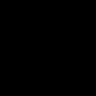

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


501
image


cam_0


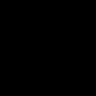

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


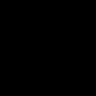

502
image


cam_0


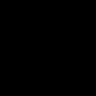

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


503
image


cam_0


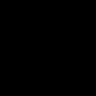

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


504
image


cam_0


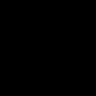

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


505
image


cam_0


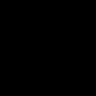

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


506
image


cam_0


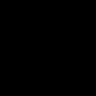

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


507
image


cam_0


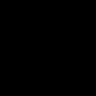

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


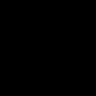

508
image


cam_0


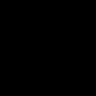

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


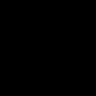

509
image


cam_0


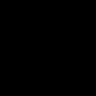

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


510
image


cam_0


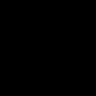

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


511
image


cam_0


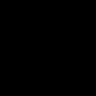

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


512
image


cam_0


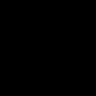

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


513
image


cam_0


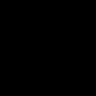

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


514
image


cam_0


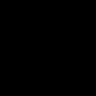

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


515
image


cam_0


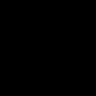

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


516
image


cam_0


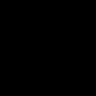

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


517
image


cam_0


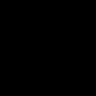

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


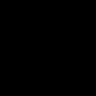

518
image


cam_0


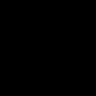

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


519
image


cam_0


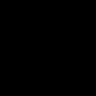

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


520
image


cam_0


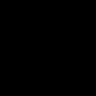

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


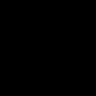

521
image


cam_0


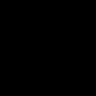

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


522
image


cam_0


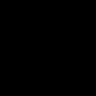

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


523
image


cam_0


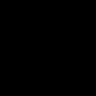

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


524
image


cam_0


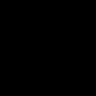

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


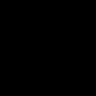

525
image


cam_0


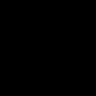

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


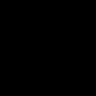

526
image


cam_0


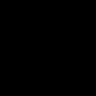

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


527
image


cam_0


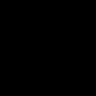

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


528
image


cam_0


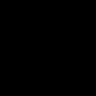

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


529
image


cam_0


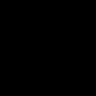

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


530
image


cam_0


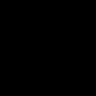

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


531
image


cam_0


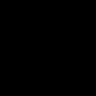

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


532
image


cam_0


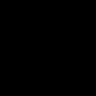

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


533
image


cam_0


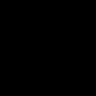

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


534
image


cam_0


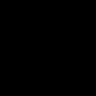

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


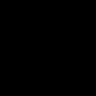

535
image


cam_0


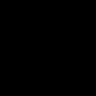

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


536
image


cam_0


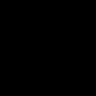

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


537
image


cam_0


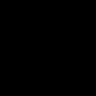

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


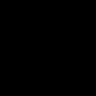

538
image


cam_0


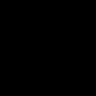

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


539
image


cam_0


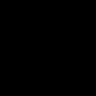

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


540
image


cam_0


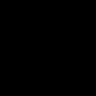

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


541
image


cam_0


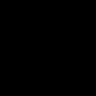

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


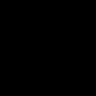

542
image


cam_0


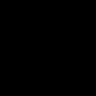

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


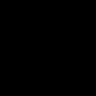

543
image


cam_0


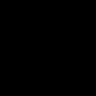

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


544
image


cam_0


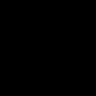

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


545
image


cam_0


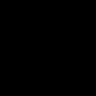

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


546
image


cam_0


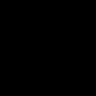

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


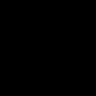

547
image


cam_0


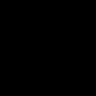

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


548
image


cam_0


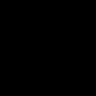

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


549
image


cam_0


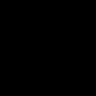

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


550
image


cam_0


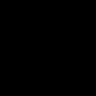

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


551
image


cam_0


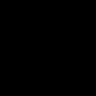

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


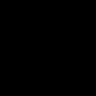

552
image


cam_0


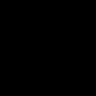

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


553
image


cam_0


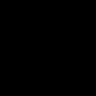

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


554
image


cam_0


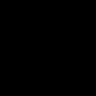

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


555
image


cam_0


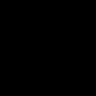

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


556
image


cam_0


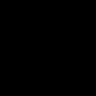

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


557
image


cam_0


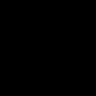

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


558
image


cam_0


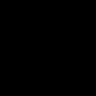

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


559
image


cam_0


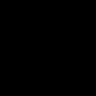

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


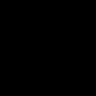

560
image


cam_0


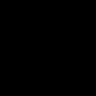

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


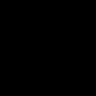

561
image


cam_0


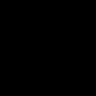

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


562
image


cam_0


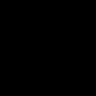

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


563
image


cam_0


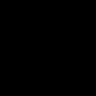

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


564
image


cam_0


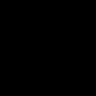

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


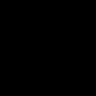

565
image


cam_0


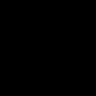

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


566
image


cam_0


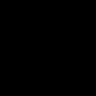

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


567
image


cam_0


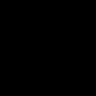

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


568
image


cam_0


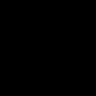

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


569
image


cam_0


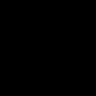

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


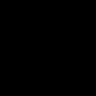

570
image


cam_0


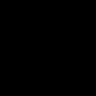

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


571
image


cam_0


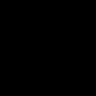

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


572
image


cam_0


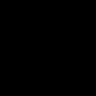

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


573
image


cam_0


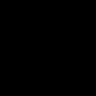

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


574
image


cam_0


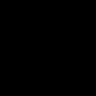

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


575
image


cam_0


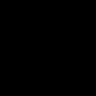

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


576
image


cam_0


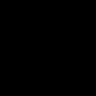

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


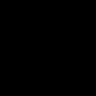

577
image


cam_0


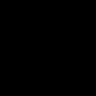

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


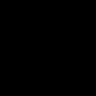

578
image


cam_0


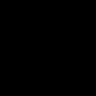

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


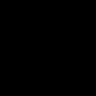

579
image


cam_0


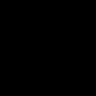

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


580
image


cam_0


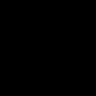

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


581
image


cam_0


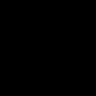

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


582
image


cam_0


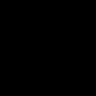

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


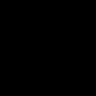

583
image


cam_0


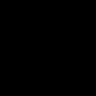

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


584
image


cam_0


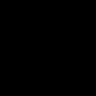

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


585
image


cam_0


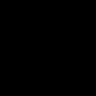

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


586
image


cam_0


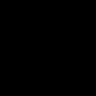

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


587
image


cam_0


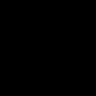

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


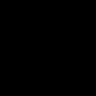

588
image


cam_0


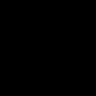

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


589
image


cam_0


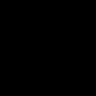

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


590
image


cam_0


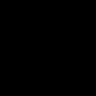

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


591
image


cam_0


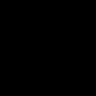

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


592
image


cam_0


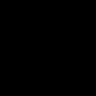

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


593
image


cam_0


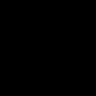

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


594
image


cam_0


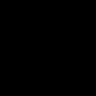

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


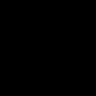

595
image


cam_0


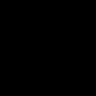

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


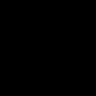

596
image


cam_0


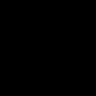

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


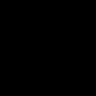

597
image


cam_0


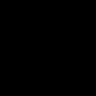

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


598
image


cam_0


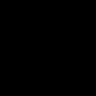

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


599
image


cam_0


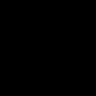

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


600
image


cam_0


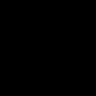

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


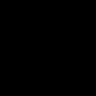

601
image


cam_0


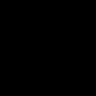

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


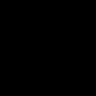

602
image


cam_0


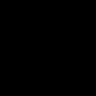

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


603
image


cam_0


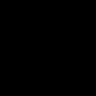

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


604
image


cam_0


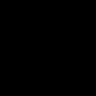

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


605
image


cam_0


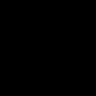

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


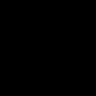

606
image


cam_0


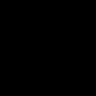

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


607
image


cam_0


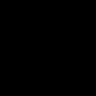

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


608
image


cam_0


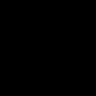

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


609
image


cam_0


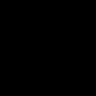

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


610
image


cam_0


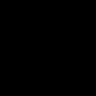

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


611
image


cam_0


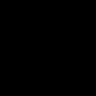

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


612
image


cam_0


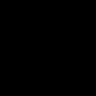

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


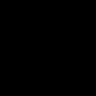

613
image


cam_0


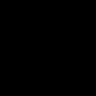

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


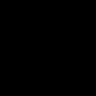

614
image


cam_0


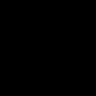

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


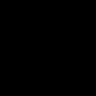

615
image


cam_0


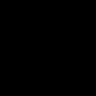

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


616
image


cam_0


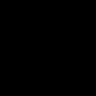

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


617
image


cam_0


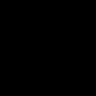

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


618
image


cam_0


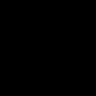

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


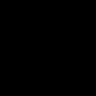

619
image


cam_0


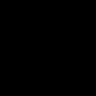

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


620
image


cam_0


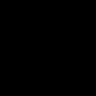

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


621
image


cam_0


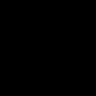

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


622
image


cam_0


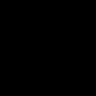

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


623
image


cam_0


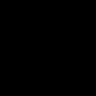

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


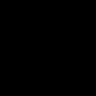

624
image


cam_0


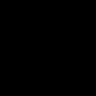

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


625
image


cam_0


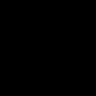

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


626
image


cam_0


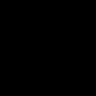

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


627
image


cam_0


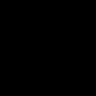

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


628
image


cam_0


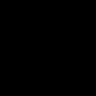

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


629
image


cam_0


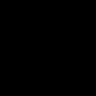

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


630
image


cam_0


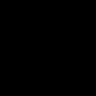

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


631
image


cam_0


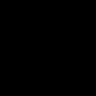

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


632
image


cam_0


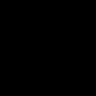

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


633
image


cam_0


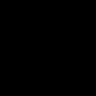

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


634
image


cam_0


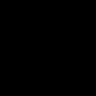

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


635
image


cam_0


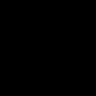

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


636
image


cam_0


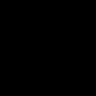

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


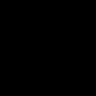

637
image


cam_0


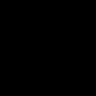

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


638
image


cam_0


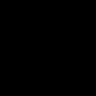

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


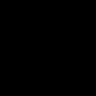

639
image


cam_0


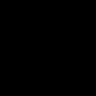

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


640
image


cam_0


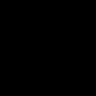

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


641
image


cam_0


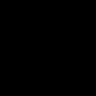

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


642
image


cam_0


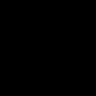

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


643
image


cam_0


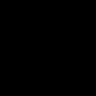

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


644
image


cam_0


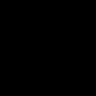

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


645
image


cam_0


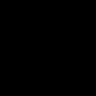

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


646
image


cam_0


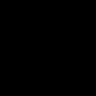

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


647
image


cam_0


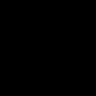

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


648
image


cam_0


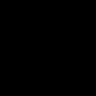

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


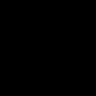

649
image


cam_0


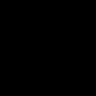

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


650
image


cam_0


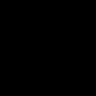

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


651
image


cam_0


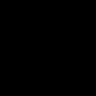

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


652
image


cam_0


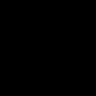

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


653
image


cam_0


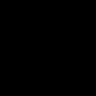

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


654
image


cam_0


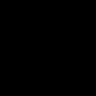

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


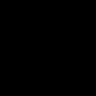

655
image


cam_0


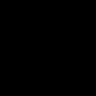

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


656
image


cam_0


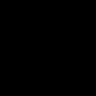

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


657
image


cam_0


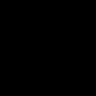

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


658
image


cam_0


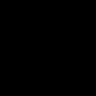

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


659
image


cam_0


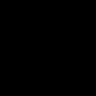

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


660
image


cam_0


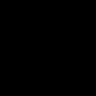

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


661
image


cam_0


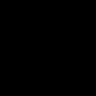

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


662
image


cam_0


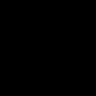

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


663
image


cam_0


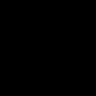

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


664
image


cam_0


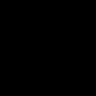

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


665
image


cam_0


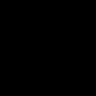

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


666
image


cam_0


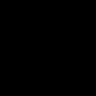

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


667
image


cam_0


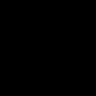

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


668
image


cam_0


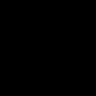

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


669
image


cam_0


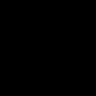

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


670
image


cam_0


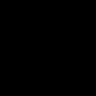

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


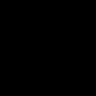

671
image


cam_0


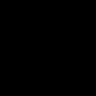

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


672
image


cam_0


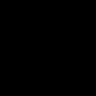

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


673
image


cam_0


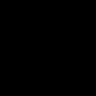

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


674
image


cam_0


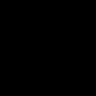

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


675
image


cam_0


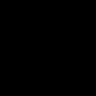

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


676
image


cam_0


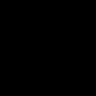

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


677
image


cam_0


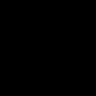

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


678
image


cam_0


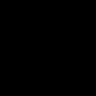

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


679
image


cam_0


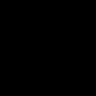

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


680
image


cam_0


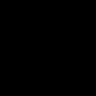

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


681
image


cam_0


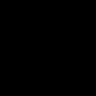

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


682
image


cam_0


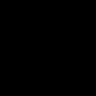

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


683
image


cam_0


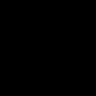

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


684
image


cam_0


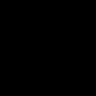

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


685
image


cam_0


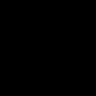

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


686
image


cam_0


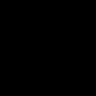

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


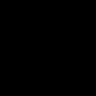

687
image


cam_0


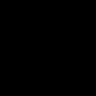

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


688
image


cam_0


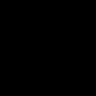

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


689
image


cam_0


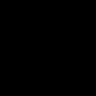

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


690
image


cam_0


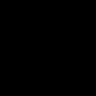

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


691
image


cam_0


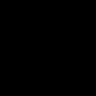

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


692
image


cam_0


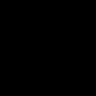

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


693
image


cam_0


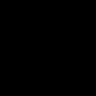

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


694
image


cam_0


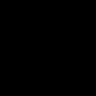

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


695
image


cam_0


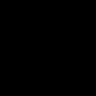

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


696
image


cam_0


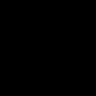

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


697
image


cam_0


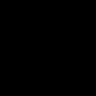

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


698
image


cam_0


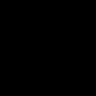

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


699
image


cam_0


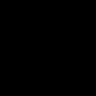

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


700
image


cam_0


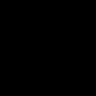

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


701
image


cam_0


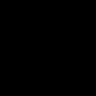

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


702
image


cam_0


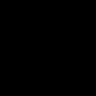

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


703
image


cam_0


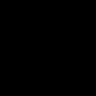

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


704
image


cam_0


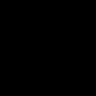

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


705
image


cam_0


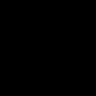

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


706
image


cam_0


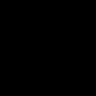

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


707
image


cam_0


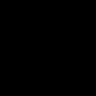

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


708
image


cam_0


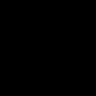

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


709
image


cam_0


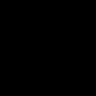

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


710
image


cam_0


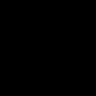

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


711
image


cam_0


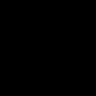

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


712
image


cam_0


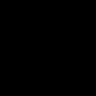

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


713
image


cam_0


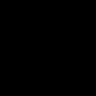

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


714
image


cam_0


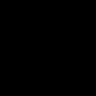

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


715
image


cam_0


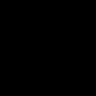

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


716
image


cam_0


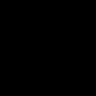

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


717
image


cam_0


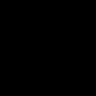

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


718
image


cam_0


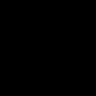

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


719
image


cam_0


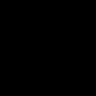

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


720
image


cam_0


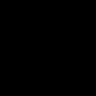

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


721
image


cam_0


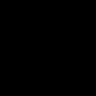

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


722
image


cam_0


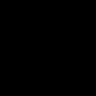

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


723
image


cam_0


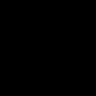

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


724
image


cam_0


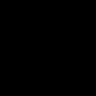

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


725
image


cam_0


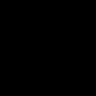

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


726
image


cam_0


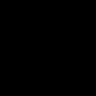

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


727
image


cam_0


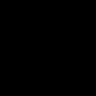

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


728
image


cam_0


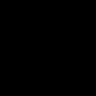

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


729
image


cam_0


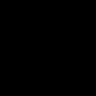

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


730
image


cam_0


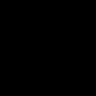

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


731
image


cam_0


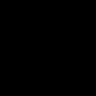

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


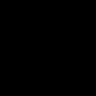

732
image


cam_0


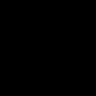

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


733
image


cam_0


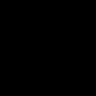

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


734
image


cam_0


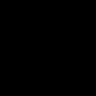

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


735
image


cam_0


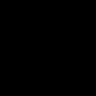

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


736
image


cam_0


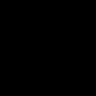

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


737
image


cam_0


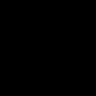

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


738
image


cam_0


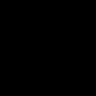

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


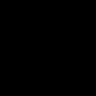

739
image


cam_0


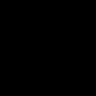

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


740
image


cam_0


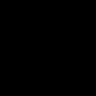

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


741
image


cam_0


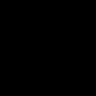

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


742
image


cam_0


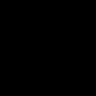

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


743
image


cam_0


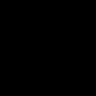

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


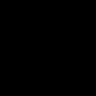

744
image


cam_0


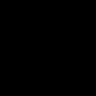

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


745
image


cam_0


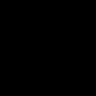

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


746
image


cam_0


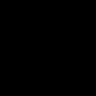

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


747
image


cam_0


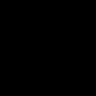

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


748
image


cam_0


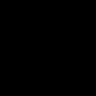

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


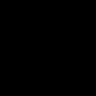

749
image


cam_0


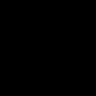

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


750
image


cam_0


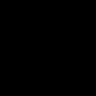

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


751
image


cam_0


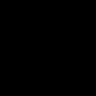

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


752
image


cam_0


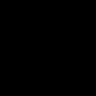

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


753
image


cam_0


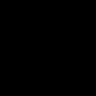

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


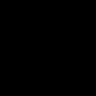

754
image


cam_0


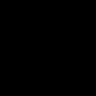

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


755
image


cam_0


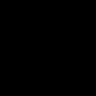

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


756
image


cam_0


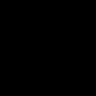

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


757
image


cam_0


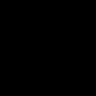

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


758
image


cam_0


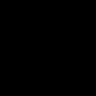

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


759
image


cam_0


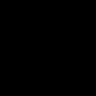

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


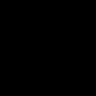

760
image


cam_0


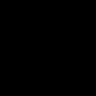

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


761
image


cam_0


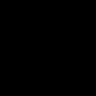

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


762
image


cam_0


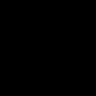

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


763
image


cam_0


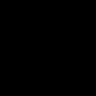

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


764
image


cam_0


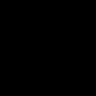

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


765
image


cam_0


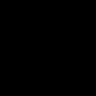

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


766
image


cam_0


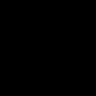

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


767
image


cam_0


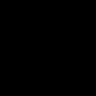

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


768
image


cam_0


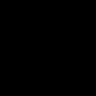

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


769
image


cam_0


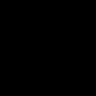

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


770
image


cam_0


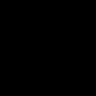

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


771
image


cam_0


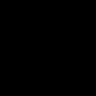

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


772
image


cam_0


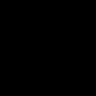

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


773
image


cam_0


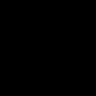

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


774
image


cam_0


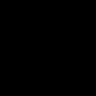

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


775
image


cam_0


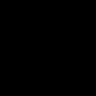

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


776
image


cam_0


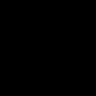

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


777
image


cam_0


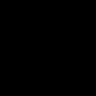

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


778
image


cam_0


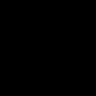

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


779
image


cam_0


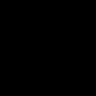

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


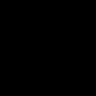

780
image


cam_0


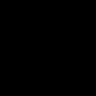

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


781
image


cam_0


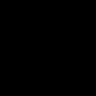

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


782
image


cam_0


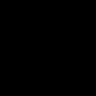

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


783
image


cam_0


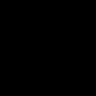

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


784
image


cam_0


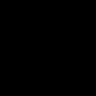

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


785
image


cam_0


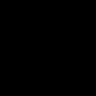

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


786
image


cam_0


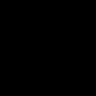

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


787
image


cam_0


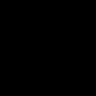

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


788
image


cam_0


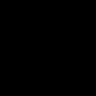

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


789
image


cam_0


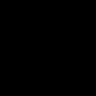

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


790
image


cam_0


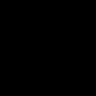

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


791
image


cam_0


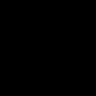

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


792
image


cam_0


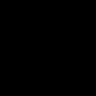

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


793
image


cam_0


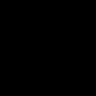

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


794
image


cam_0


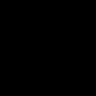

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


795
image


cam_0


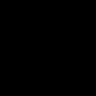

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


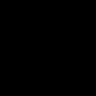

796
image


cam_0


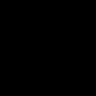

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


797
image


cam_0


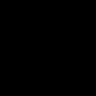

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


798
image


cam_0


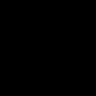

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


799
image


cam_0


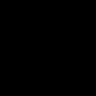

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


800
image


cam_0


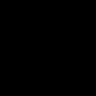

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


Exception: ignored

In [ ]:
#!python3 infer_cls.py --voc12_root data/train_pnetcls --weights vgg_cls.pth --out_cam ./out_cam #--out_la_crf ./out_la_crf --out_ha_crf ./out_ha_crf #--infer_list voc12/train_aug.txt --network [network.vgg16_cls | network.resnet38_cls]

import numpy as np
import torch
from torch.backends import cudnn
cudnn.enabled = True
import voc12.data
import scipy.misc
import importlib
from torch.utils.data import DataLoader
import torchvision
from tool import imutils, pyutils
import argparse
from PIL import Image
import torch.nn.functional as F
import os.path

from voc12.captcha import *

#if __name__ == '__main__':

class display_image():
  def __init__(self):
    self.count=0
  def __call__(self,img,title=None):
    img = (img - np.min(img)) / (np.max(img) - np.min(img))
    img *= 255
    img = Image.fromarray(img.astype(np.uint8))
    if title: print(title)
    display(img)
    img.save("/content/CAMs/{:03d}_{}.png".format(self.count//7,title))
    self.count+=1
display_image=display_image()

"""    parser = argparse.ArgumentParser()
    parser.add_argument("--weights", required=True, type=str)
    parser.add_argument("--network", default="network.vgg16_cls", type=str)
    parser.add_argument("--infer_list", default="voc12/val.txt", type=str)
    parser.add_argument("--num_workers", default=8, type=int)
    parser.add_argument("--voc12_root", required=True, type=str)
    parser.add_argument("--low_alpha", default=4, type=int)
    parser.add_argument("--high_alpha", default=32, type=int)
    parser.add_argument("--out_cam", default=None, type=str)
    parser.add_argument("--out_la_crf", default=None, type=str)
    parser.add_argument("--out_ha_crf", default=None, type=str)
    parser.add_argument("--out_cam_pred", default=None, type=str)

    args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.weights = "./vgg_cls.pth"
args.voc12_root = "data/img2"
args.out_cam = "./out_cam"
args.out_la_crf = "./out_la_crf"#None
args.out_ha_crf = "./out_ha_crf"#None
args.out_cam_pred = None

args.network = "network.vgg16_cls"
args.num_workers = 8
args.low_alpha = 4
args.high_alpha = 32

model = getattr(importlib.import_module(args.network), 'Net')()
model.load_state_dict(torch.load(args.weights))

model.eval()
model.cuda()

"""infer_dataset = voc12.data.VOC12ClsDatasetMSF(args.infer_list, voc12_root=args.voc12_root,
                                                scales=(1, 0.5, 1.5, 2.0),
                                                inter_transform=torchvision.transforms.Compose(
                                                    [np.asarray,
                                                    model.normalize,
                                                    imutils.HWC_to_CHW]))

infer_data_loader = DataLoader(infer_dataset, shuffle=False, num_workers=args.num_workers, pin_memory=True)"""

infer_data_loader = CAPTCHADataLoader(args.voc12_root,batch_size=1,transform=torchvision.transforms.Compose([
  #Normalize(234.08844113652563,174.22328263189004),
  #MakeItStupid(),
  OneHot(),
  ToTensor()
]))

n_gpus = torch.cuda.device_count()
model_replicas = torch.nn.parallel.replicate(model, list(range(n_gpus)))

for brain_iter,brain in enumerate(infer_data_loader):
  brain_cam = []
  brain_la_crf = []
  brain_ha_crf = []
  for iter, (_, img_list, label) in enumerate(brain):
    if iter < 500: continue
    #img_name = img_name[0];

    print(iter)
    
    label = label[0]

    #img_path = voc12.data.get_img_path(img_name, args.voc12_root)
    #orig_img = np.asarray(Image.open(img_path))

    orig_img = brain.dataset.data[iter]
    orig_img_size = orig_img.shape[:2]

    if iter == 5: np.save("example.npy",orig_img)

    display_image(orig_img,"image")
    
    #print(model(img_list.cuda()))

    img_list = img_list[None,...]

    def _work(i, img):
        with torch.no_grad():
            with torch.cuda.device(i%n_gpus):
                cam = model_replicas[i%n_gpus].forward_cam(img.cuda())
                cam = F.interpolate(cam, orig_img_size, mode='bilinear', align_corners=False)[0]
                cam = cam.cpu().numpy() * label.clone().view(2, 1, 1).numpy()
                if i % 2 == 1:
                    cam = np.flip(cam, axis=-1)
                return cam

    thread_pool = pyutils.BatchThreader(_work, list(enumerate(img_list)),
                                        batch_size=12, prefetch_size=0, processes=args.num_workers)

    cam_list = thread_pool.pop_results()

    #raise Exception(cam_list[0].shape)

    sum_cam = np.sum(cam_list, axis=0)
    norm_cam = sum_cam / (np.max(sum_cam, (1, 2), keepdims=True) + 1e-5)
    for k in range(len(norm_cam)): display_image(norm_cam[k],f"cam_{k}")

    cam_dict = {}
    for i in range(2):
        if label[i] > 1e-5:
            cam_dict[i] = norm_cam[i]

    if args.out_cam is not None:
        brain_cam.append(cam_dict)
        #np.save(os.path.join(args.out_cam, img_name + '.npy'), cam_dict)

    if args.out_cam_pred is not None:
        bg_score = [np.ones_like(norm_cam[0])*0.2]
        pred = np.argmax(np.concatenate((bg_score, norm_cam)), 0)
        #display(Image.fromarray((pred*255).astype(np.uint8)).resize((128,128),Image.ANTIALIAS))
        #scipy.misc.imsave(os.path.join(args.out_cam_pred, img_name + '.png'), pred.astype(np.uint8))

    def _crf_with_alpha(cam_dict, alpha):
        v = np.array(list(cam_dict.values()))
        bg_score = np.power(1 - np.max(v, axis=0, keepdims=True), alpha)
        bgcam_score = np.concatenate((bg_score, v), axis=0)
        #raise Exception(orig_img.shape,bgcam_score.shape)
        crf_score = imutils.crf_inference(orig_img, bgcam_score, labels=bgcam_score.shape[0])

        n_crf_al = dict()

        n_crf_al[0] = crf_score[0]
        for i, key in enumerate(cam_dict.keys()):
            n_crf_al[key+1] = crf_score[i+1]

        return n_crf_al

    if args.out_la_crf is not None:
        crf_la = _crf_with_alpha(cam_dict, args.low_alpha)
        for k in crf_la: display_image(crf_la[k],f"crf_la_{k}")
        brain_la_crf.append(crf_la)
        #np.save(os.path.join(args.out_la_crf, img_name + '.npy'), crf_la)

    if args.out_ha_crf is not None:
        crf_ha = _crf_with_alpha(cam_dict, args.high_alpha)
        for k in crf_ha: display_image(crf_ha[k],f"crf_ha_{k}")
        if iter == 800: raise Exception("CHECK")
        brain_ha_crf.append(crf_ha)
        #np.save(os.path.join(args.out_ha_crf, img_name + '.npy'), crf_ha)
  np.save(os.path.join(args.out_cam, brain.dataset.id + '.npy'), brain_cam)
  np.save(os.path.join(args.out_la_crf, brain.dataset.id + '.npy'), brain_la_crf)
  np.save(os.path.join(args.out_ha_crf, brain.dataset.id + '.npy'), brain_ha_crf)

In [ ]:
!cp -r /content/CAMs /content/drive/MyDrive/tesi/CAPTCHA/newCAMs_ones

In [ ]:
!zip -r CAMs.zip CAMs

  adding: CAMs/ (stored 0%)
  adding: CAMs/206_cam_1.png (stored 0%)
  adding: CAMs/040_cam_1.png (stored 0%)
  adding: CAMs/246_image.png (stored 0%)
  adding: CAMs/071_crf_la_2.png (stored 0%)
  adding: CAMs/020_image.png (stored 0%)
  adding: CAMs/075_crf_la_0.png (stored 0%)
  adding: CAMs/139_crf_la_2.png (stored 0%)
  adding: CAMs/074_crf_ha_0.png (deflated 8%)
  adding: CAMs/019_crf_ha_0.png (deflated 5%)
  adding: CAMs/282_crf_la_2.png (stored 0%)
  adding: CAMs/110_crf_ha_2.png (stored 0%)
  adding: CAMs/007_cam_0.png (deflated 15%)
  adding: CAMs/300_cam_1.png (stored 0%)
  adding: CAMs/227_crf_ha_0.png (stored 0%)
  adding: CAMs/160_cam_1.png (stored 0%)
  adding: CAMs/214_crf_ha_2.png (stored 0%)
  adding: CAMs/074_crf_la_0.png (deflated 6%)
  adding: CAMs/298_image.png (stored 0%)
  adding: CAMs/021_image.png (stored 0%)
  adding: CAMs/045_crf_la_0.png (stored 0%)
  adding: CAMs/030_crf_ha_2.png (deflated 8%)
  adding: CAMs/253_crf_ha_0.png (stored 0%)
  adding: CAMs/225_c

0
image


cam_0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide


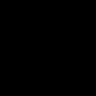

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


1
image


cam_0


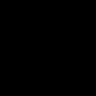

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


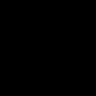

2
image


cam_0


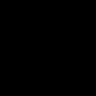

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


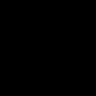

3
image


cam_0


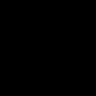

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


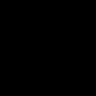

4
image


cam_0


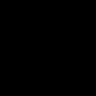

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


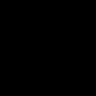

5
image


cam_0


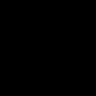

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


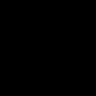

6
image


cam_0


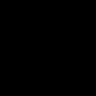

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


7
image


cam_0


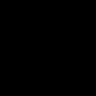

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


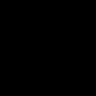

8
image


cam_0


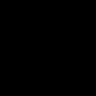

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


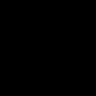

9
image


cam_0


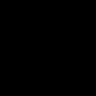

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


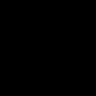

10
image


cam_0


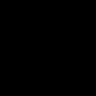

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


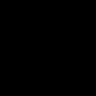

11
image


cam_0


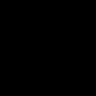

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


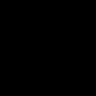

12
image


cam_0


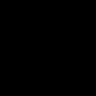

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


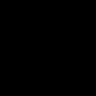

13
image


cam_0


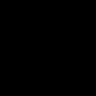

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


14
image


cam_0


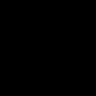

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


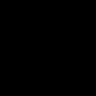

15
image


cam_0


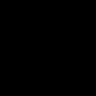

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


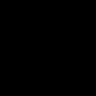

16
image


cam_0


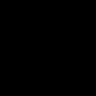

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


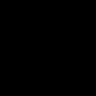

17
image


cam_0


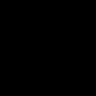

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


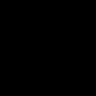

18
image


cam_0


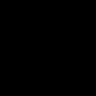

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


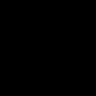

19
image


cam_0


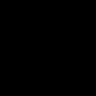

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


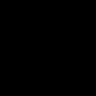

20
image


cam_0


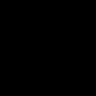

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


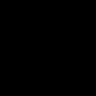

21
image


cam_0


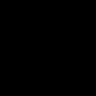

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


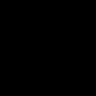

22
image


cam_0


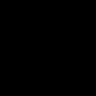

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


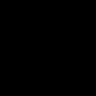

23
image


cam_0


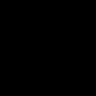

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


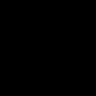

24
image


cam_0


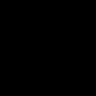

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


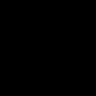

25
image


cam_0


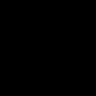

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


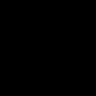

26
image


cam_0


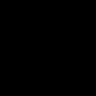

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


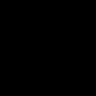

27
image


cam_0


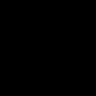

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


28
image


cam_0


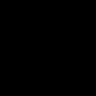

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


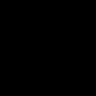

29
image


cam_0


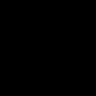

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


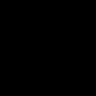

30
image


cam_0


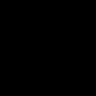

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


31
image


cam_0


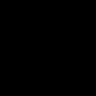

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


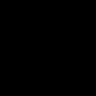

32
image


cam_0


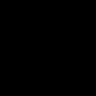

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


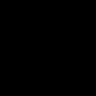

33
image


cam_0


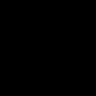

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


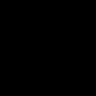

34
image


cam_0


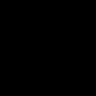

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


35
image


cam_0


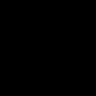

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


36
image


cam_0


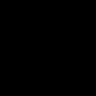

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


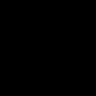

37
image


cam_0


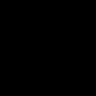

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


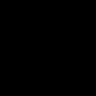

38
image


cam_0


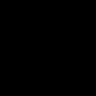

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


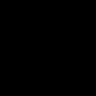

39
image


cam_0


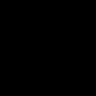

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


40
image


cam_0


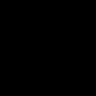

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


41
image


cam_0


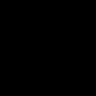

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


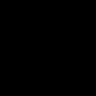

42
image


cam_0


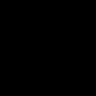

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


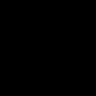

43
image


cam_0


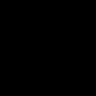

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


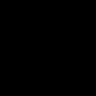

44
image


cam_0


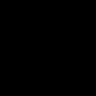

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


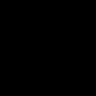

45
image


cam_0


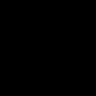

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


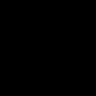

46
image


cam_0


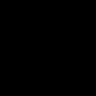

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


47
image


cam_0


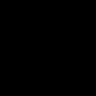

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


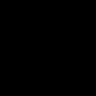

48
image


cam_0


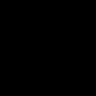

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


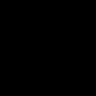

49
image


cam_0


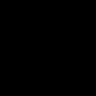

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


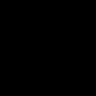

50
image


cam_0


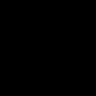

cam_1


crf_la_0


crf_la_2


crf_ha_0


crf_ha_2


Exception: ignored

In [ ]:
#!python3 infer_cls.py --voc12_root data/train_pnetcls --weights vgg_cls.pth --out_cam ./out_cam #--out_la_crf ./out_la_crf --out_ha_crf ./out_ha_crf #--infer_list voc12/train_aug.txt --network [network.vgg16_cls | network.resnet38_cls]

import numpy as np
import torch
from torch.backends import cudnn
cudnn.enabled = True
import voc12.data
import scipy.misc
import importlib
from torch.utils.data import DataLoader
import torchvision
from tool import imutils, pyutils
import argparse
from PIL import Image
import torch.nn.functional as F
import os.path

from voc12.captcha import *

#if __name__ == '__main__':

def display_image(img,title=None):
  img = (img - np.min(img)) / (np.max(img) - np.min(img))
  img *= 255
  img = Image.fromarray(img.astype(np.uint8))
  if title: print(title)
  display(img)

"""    parser = argparse.ArgumentParser()
    parser.add_argument("--weights", required=True, type=str)
    parser.add_argument("--network", default="network.vgg16_cls", type=str)
    parser.add_argument("--infer_list", default="voc12/val.txt", type=str)
    parser.add_argument("--num_workers", default=8, type=int)
    parser.add_argument("--voc12_root", required=True, type=str)
    parser.add_argument("--low_alpha", default=4, type=int)
    parser.add_argument("--high_alpha", default=32, type=int)
    parser.add_argument("--out_cam", default=None, type=str)
    parser.add_argument("--out_la_crf", default=None, type=str)
    parser.add_argument("--out_ha_crf", default=None, type=str)
    parser.add_argument("--out_cam_pred", default=None, type=str)

    args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.weights = "vgg_cls.pth"
args.voc12_root = "data/img"
args.out_cam = "./out_cam"
args.out_la_crf = "./out_la_crf"#None
args.out_ha_crf = "./out_ha_crf"#None
args.out_cam_pred = None

args.network = "network.vgg16_cls"
args.num_workers = 8
args.low_alpha = 4
args.high_alpha = 32

model = getattr(importlib.import_module(args.network), 'Net')()
model.load_state_dict(torch.load(args.weights))

model.eval()
model.cuda()

"""infer_dataset = voc12.data.VOC12ClsDatasetMSF(args.infer_list, voc12_root=args.voc12_root,
                                                scales=(1, 0.5, 1.5, 2.0),
                                                inter_transform=torchvision.transforms.Compose(
                                                    [np.asarray,
                                                    model.normalize,
                                                    imutils.HWC_to_CHW]))

infer_data_loader = DataLoader(infer_dataset, shuffle=False, num_workers=args.num_workers, pin_memory=True)"""

infer_data_loader = CAPTCHADataLoader(args.voc12_root,batch_size=1,transform=torchvision.transforms.Compose([
  #Normalize(234.08844113652563,174.22328263189004),
  #MakeItStupid(),
  OneHot(),
  ToTensor()
]))

n_gpus = torch.cuda.device_count()
model_replicas = torch.nn.parallel.replicate(model, list(range(n_gpus)))

for brain_iter,brain in enumerate(infer_data_loader):
  brain_cam = []
  brain_la_crf = []
  brain_ha_crf = []
  for iter, (_, img_list, label) in enumerate(brain):
    #img_name = img_name[0];

    print(iter)
    
    label = label[0]

    #img_path = voc12.data.get_img_path(img_name, args.voc12_root)
    #orig_img = np.asarray(Image.open(img_path))

    orig_img = brain.dataset.data[iter]
    orig_img_size = orig_img.shape[:2]

    if iter == 5: np.save("example.npy",orig_img)

    display_image(orig_img,"image")
    
    #print(model(img_list.cuda()))

    img_list = img_list[None,...]

    def _work(i, img):
        with torch.no_grad():
            with torch.cuda.device(i%n_gpus):
                cam = model_replicas[i%n_gpus].forward_cam(img.cuda())
                cam = F.interpolate(cam, orig_img_size, mode='bilinear', align_corners=False)[0]
                cam = cam.cpu().numpy() * label.clone().view(2, 1, 1).numpy()
                if i % 2 == 1:
                    cam = np.flip(cam, axis=-1)
                return cam

    thread_pool = pyutils.BatchThreader(_work, list(enumerate(img_list)),
                                        batch_size=12, prefetch_size=0, processes=args.num_workers)

    cam_list = thread_pool.pop_results()

    #raise Exception(cam_list[0].shape)

    sum_cam = np.sum(cam_list, axis=0)
    norm_cam = sum_cam / (np.max(sum_cam, (1, 2), keepdims=True) + 1e-5)
    for k in range(len(norm_cam)): display_image(norm_cam[k],f"cam_{k}")

    cam_dict = {}
    for i in range(2):
        if label[i] > 1e-5:
            cam_dict[i] = norm_cam[i]

    if args.out_cam is not None:
        brain_cam.append(cam_dict)
        #np.save(os.path.join(args.out_cam, img_name + '.npy'), cam_dict)

    if args.out_cam_pred is not None:
        bg_score = [np.ones_like(norm_cam[0])*0.2]
        pred = np.argmax(np.concatenate((bg_score, norm_cam)), 0)
        #display(Image.fromarray((pred*255).astype(np.uint8)).resize((128,128),Image.ANTIALIAS))
        #scipy.misc.imsave(os.path.join(args.out_cam_pred, img_name + '.png'), pred.astype(np.uint8))

    def _crf_with_alpha(cam_dict, alpha):
        v = np.array(list(cam_dict.values()))
        bg_score = np.power(1 - np.max(v, axis=0, keepdims=True), alpha)
        bgcam_score = np.concatenate((bg_score, v), axis=0)
        #raise Exception(orig_img.shape,bgcam_score.shape)
        crf_score = imutils.crf_inference(orig_img, bgcam_score, labels=bgcam_score.shape[0])

        n_crf_al = dict()

        n_crf_al[0] = crf_score[0]
        for i, key in enumerate(cam_dict.keys()):
            n_crf_al[key+1] = crf_score[i+1]

        return n_crf_al

    if args.out_la_crf is not None:
        crf_la = _crf_with_alpha(cam_dict, args.low_alpha)
        for k in crf_la: display_image(crf_la[k],f"crf_la_{k}")
        brain_la_crf.append(crf_la)
        #np.save(os.path.join(args.out_la_crf, img_name + '.npy'), crf_la)

    if args.out_ha_crf is not None:
        crf_ha = _crf_with_alpha(cam_dict, args.high_alpha)
        for k in crf_ha: display_image(crf_ha[k],f"crf_ha_{k}")
        if iter == 50: raise Exception("CHECK")
        brain_ha_crf.append(crf_ha)
        #np.save(os.path.join(args.out_ha_crf, img_name + '.npy'), crf_ha)
  np.save(os.path.join(args.out_cam, brain.dataset.id + '.npy'), brain_cam)
  np.save(os.path.join(args.out_la_crf, brain.dataset.id + '.npy'), brain_la_crf)
  np.save(os.path.join(args.out_ha_crf, brain.dataset.id + '.npy'), brain_ha_crf)

import time
time.sleep(60*60*2)

In [ ]:
#!python3 infer_cls.py --voc12_root data/train_pnetcls --weights vgg_cls.pth --out_cam ./out_cam #--out_la_crf ./out_la_crf --out_ha_crf ./out_ha_crf #--infer_list voc12/train_aug.txt --network [network.vgg16_cls | network.resnet38_cls]

import numpy as np
import torch
from torch.backends import cudnn
cudnn.enabled = True
import voc12.data
import scipy.misc
import importlib
from torch.utils.data import DataLoader
import torchvision
from tool import imutils, pyutils
import argparse
from PIL import Image
import torch.nn.functional as F
import os.path

from voc12.captcha import *

#if __name__ == '__main__':

def display_image(img,title=None):
  img = (img - np.min(img)) / (np.max(img) - np.min(img))
  img *= 255
  img = Image.fromarray(img.astype(np.uint8))
  if title: print(title)
  display(img)

"""    parser = argparse.ArgumentParser()
    parser.add_argument("--weights", required=True, type=str)
    parser.add_argument("--network", default="network.vgg16_cls", type=str)
    parser.add_argument("--infer_list", default="voc12/val.txt", type=str)
    parser.add_argument("--num_workers", default=8, type=int)
    parser.add_argument("--voc12_root", required=True, type=str)
    parser.add_argument("--low_alpha", default=4, type=int)
    parser.add_argument("--high_alpha", default=32, type=int)
    parser.add_argument("--out_cam", default=None, type=str)
    parser.add_argument("--out_la_crf", default=None, type=str)
    parser.add_argument("--out_ha_crf", default=None, type=str)
    parser.add_argument("--out_cam_pred", default=None, type=str)

    args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.weights = "vgg_cls.pth"
args.voc12_root = "data/img"
args.out_cam = "./out_cam"
args.out_la_crf = "./out_la_crf"#None
args.out_ha_crf = "./out_ha_crf"#None
args.out_cam_pred = None

args.network = "network.vgg16_cls"
args.num_workers = 8
args.low_alpha = 4
args.high_alpha = 32

model = getattr(importlib.import_module(args.network), 'Net')()
model.load_state_dict(torch.load(args.weights))

model.eval()
model.cuda()

"""infer_dataset = voc12.data.VOC12ClsDatasetMSF(args.infer_list, voc12_root=args.voc12_root,
                                                scales=(1, 0.5, 1.5, 2.0),
                                                inter_transform=torchvision.transforms.Compose(
                                                    [np.asarray,
                                                    model.normalize,
                                                    imutils.HWC_to_CHW]))

infer_data_loader = DataLoader(infer_dataset, shuffle=False, num_workers=args.num_workers, pin_memory=True)"""

infer_data_loader = CAPTCHADataLoader(args.voc12_root,batch_size=1,transform=torchvision.transforms.Compose([
  #Normalize(234.08844113652563,174.22328263189004),
  #MakeItStupid(),
  OneHot(),
  ToTensor()
]))

n_gpus = torch.cuda.device_count()
model_replicas = torch.nn.parallel.replicate(model, list(range(n_gpus)))

for brain_iter,brain in enumerate(infer_data_loader):
  brain_cam = []
  brain_la_crf = []
  brain_ha_crf = []
  for iter, (_, img_list, label) in enumerate(brain):
    #img_name = img_name[0];
    
    label = label[0]

    #img_path = voc12.data.get_img_path(img_name, args.voc12_root)
    #orig_img = np.asarray(Image.open(img_path))

    orig_img = brain.dataset.data[iter]
    orig_img_size = orig_img.shape[:2]

    #display_image(orig_img,"image")
    
    #print(model(img_list.cuda()))

    img_list = img_list[None,...]

    def _work(i, img):
        with torch.no_grad():
            with torch.cuda.device(i%n_gpus):
                cam = model_replicas[i%n_gpus].forward_cam(img.cuda())
                cam = F.interpolate(cam, orig_img_size, mode='bilinear', align_corners=False)[0]
                cam = cam.cpu().numpy() * label.clone().view(2, 1, 1).numpy()
                if i % 2 == 1:
                    cam = np.flip(cam, axis=-1)
                return cam

    thread_pool = pyutils.BatchThreader(_work, list(enumerate(img_list)),
                                        batch_size=12, prefetch_size=0, processes=args.num_workers)

    cam_list = thread_pool.pop_results()

    #raise Exception(cam_list[0].shape)

    sum_cam = np.sum(cam_list, axis=0)
    norm_cam = sum_cam / (np.max(sum_cam, (1, 2), keepdims=True) + 1e-5)
    #for k in range(len(norm_cam)): display_image(norm_cam[k],f"cam_{k}")

    cam_dict = {}
    for i in range(2):
        if label[i] > 1e-5:
            cam_dict[i] = norm_cam[i]

    if args.out_cam is not None:
        brain_cam.append(cam_dict)
        #np.save(os.path.join(args.out_cam, img_name + '.npy'), cam_dict)

    if args.out_cam_pred is not None:
        bg_score = [np.ones_like(norm_cam[0])*0.2]
        pred = np.argmax(np.concatenate((bg_score, norm_cam)), 0)
        #display(Image.fromarray((pred*255).astype(np.uint8)).resize((128,128),Image.ANTIALIAS))
        #scipy.misc.imsave(os.path.join(args.out_cam_pred, img_name + '.png'), pred.astype(np.uint8))

    def _crf_with_alpha(cam_dict, alpha):
        v = np.array(list(cam_dict.values()))
        bg_score = np.power(1 - np.max(v, axis=0, keepdims=True), alpha)
        bgcam_score = np.concatenate((bg_score, v), axis=0)
        #raise Exception(orig_img.shape,bgcam_score.shape)
        crf_score = imutils.crf_inference(orig_img, bgcam_score, labels=bgcam_score.shape[0])

        n_crf_al = dict()

        n_crf_al[0] = crf_score[0]
        for i, key in enumerate(cam_dict.keys()):
            n_crf_al[key+1] = crf_score[i+1]

        return n_crf_al

    if args.out_la_crf is not None:
        crf_la = _crf_with_alpha(cam_dict, args.low_alpha)
        #for k in crf_la: display_image(crf_la[k],f"crf_la_{k}")
        brain_la_crf.append(crf_la)
        #np.save(os.path.join(args.out_la_crf, img_name + '.npy'), crf_la)

    if args.out_ha_crf is not None:
        crf_ha = _crf_with_alpha(cam_dict, args.high_alpha)
        #for k in crf_ha: display_image(crf_ha[k],f"crf_ha_{k}")
        #if iter == 50: raise Exception("CHECK")
        brain_ha_crf.append(crf_ha)
        #np.save(os.path.join(args.out_ha_crf, img_name + '.npy'), crf_ha)
  np.save(os.path.join(args.out_cam, brain.dataset.id + '.npy'), brain_cam)
  np.save(os.path.join(args.out_la_crf, brain.dataset.id + '.npy'), brain_la_crf)
  np.save(os.path.join(args.out_ha_crf, brain.dataset.id + '.npy'), brain_ha_crf)

import time
time.sleep(60*60*2)

KeyboardInterrupt: ignored

In [ ]:
!mkdir output_96_v3
!cp -r out_cam output_96_v3
!cp -r out_ha_crf output_96_v3
!cp -r out_la_crf output_96_v3

In [ ]:
!cp -r output_96_v3/ /content/drive/MyDrive/tesi/CAPTCHA/output_96_v3

In [ ]:
#MAKE IT TO A NEW FORMAT, FROM DICT TO NUMPY

for image_path in os.listdir("/content/psa/out_cam/"):
  image_path="/content/psa/out_cam/"+image_path
  image=[]
  for i,case in enumerate(np.load(image_path,allow_pickle=True)):
    key=list(case.keys())[0]
    image.append(case[key])
  np.save(image_path,np.array(image))

for image_path in os.listdir("/content/psa/out_ha_crf/"):
  image_path="/content/psa/out_ha_crf/"+image_path
  image=[]
  for i,case in enumerate(np.load(image_path,allow_pickle=True)):
    key=list(case.keys())[0]
    image.append(case[key])
  np.save(image_path,np.array(image))

for image_path in os.listdir("/content/psa/out_la_crf/"):
  image_path="/content/psa/out_la_crf/"+image_path
  image=[]
  for i,case in enumerate(np.load(image_path,allow_pickle=True)):
    key=list(case.keys())[0]
    image.append(case[key])
  np.save(image_path,np.array(image))

## Train affinity net

In [ ]:
#!python3 train_aff.py --lr 0.1 --batch_size 8 --max_epoches 8 --crop_size 448 --voc12_root [your_voc12_root_folder] --network [network.vgg16_aff | network.resnet38_aff] --weights [your_weights_file] --wt_dec 5e-4 --la_crf_dir [your_output_folder] --ha_crf_dir [your_output_folder]

from tool import imutils
from torch.utils.data import DataLoader
from torchvision import transforms
import voc12.data
from voc12.captcha import *

class AllBrainImages(torch.utils.data.Dataset):
  def __init__(self,root_dir,transform=None,label_la_dir=None,label_ha_dir=None,label_transform=None):
    self.dataloader=CAPTCHADataLoader(root_dir,1,transform=transform)
    self.map=[j for i,brain in enumerate(self.dataloader) for j in [i]*len(brain)]
    self.label_la_dir=label_la_dir
    self.label_ha_dir=label_ha_dir
    self.label_transform=label_transform
    self.extract_aff_lab_func = voc12.data.ExtractAffinityLabelInRadius(cropsize=32//8)

  def __len__(self):
    return sum(len(brain) for brain in self.dataloader)
  
  def __getitem__(self, id):
    brain_id=self.map[id]
    slice_id=id-self.map.index(brain_id)
    dataset=self.dataloader.loaders[brain_id].dataset
    if self.label_la_dir is not None and self.label_ha_dir is not None:
      label_la_path = os.path.join(self.label_la_dir, dataset.id + '.npy')
      label_ha_path = os.path.join(self.label_ha_dir, dataset.id + '.npy')
      label_la = np.load(label_la_path,allow_pickle=True).item()
      label_ha = np.load(label_ha_path,allow_pickle=True).item()
      label = np.array(list(label_la.values()) + list(label_ha.values()))
      label = label[:,slice_id]
      label = np.transpose(label, (1, 2, 0))
      if self.label_transform: label = self.label_transform(label)
      no_score_region = np.max(label, -1) < 1e-5
      label_la, label_ha = np.array_split(label, 2, axis=-1)
      label_la = np.argmax(label_la, axis=-1).astype(np.uint8)
      label_ha = np.argmax(label_ha, axis=-1).astype(np.uint8)
      label = label_la.copy()
      label[label_la == 0] = 255
      label[label_ha == 0] = 0
      label[no_score_region] = 255 # mostly outer of cropped region
      label = self.extract_aff_lab_func(label)
      return dataset.__getitem__(slice_id),label

    return dataset.__getitem__(slice_id)

train_dataset = AllBrainImages("data/train_pnetcls",
  label_la_dir="output_v1/out_la_crf",label_ha_dir="output_v1/out_ha_crf",
  transform=transforms.Compose([
      #Normalize(234.08844113652563,174.22328263189004),
      OneHot(),
      ToTensor()
    ]),
  label_transform=transforms.Compose([
      imutils.AvgPool2d(8)
  ]))
  

train_data_loader = DataLoader(train_dataset, batch_size=8,
                                shuffle=True, num_workers=8, pin_memory=True, drop_last=True)

for batch in train_data_loader:
  raise Exception(batch)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Exception: ignored

In [ ]:
%cd psa

/content/psa


In [ ]:
import numpy as np
import torch
from torch.backends import cudnn
from torch.utils.data import DataLoader
cudnn.enabled = True
from torchvision import transforms
import voc12.data
from tool import pyutils, imutils, torchutils
import argparse
import importlib

from voc12.captcha import *

def display_image(img,title=None):
  img = (img - np.min(img)) / (np.max(img) - np.min(img))
  img *= 255
  img = Image.fromarray(img.astype(np.uint8))
  if title: print(title)
  display(img)


"""parser = argparse.ArgumentParser()
parser.add_argument("--batch_size", default=8, type=int)
parser.add_argument("--max_epoches", default=8, type=int)
parser.add_argument("--network", default="network.vgg16_aff", type=str)
parser.add_argument("--lr", default=0.1, type=float)
parser.add_argument("--num_workers", default=8, type=int)
parser.add_argument("--wt_dec", default=5e-4, type=float)
parser.add_argument("--train_list", default="voc12/train_aug.txt", type=str)
parser.add_argument("--val_list", default="voc12/val.txt", type=str)
parser.add_argument("--session_name", default="vgg_aff", type=str)
parser.add_argument("--crop_size", default=448, type=int)
parser.add_argument("--weights", required=True, type=str)
parser.add_argument("--voc12_root", required=True, type=str)
parser.add_argument("--la_crf_dir", required=True, type=str)
parser.add_argument("--ha_crf_dir", required=True, type=str)
args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.batch_size=8
args.max_epoches=8
args.network="network.vgg16_aff"
args.lr=0.1
args.num_workers=8
args.wt_dec=5e-4
args.train_list="voc12/train_aug.txt"
args.val_list="voc12/val.txt"
args.session_name="vgg_aff"

#?
args.crop_size=96#448
args.weights="vgg_cls.pth"
args.voc12_root="data/img"
args.la_crf_dir="output_96_v3/out_la_crf"
args.ha_crf_dir="output_96_v3/out_ha_crf"


pyutils.Logger(args.session_name + '.log')
model = getattr(importlib.import_module(args.network), 'Net')()


"""train_dataset = voc12.data.VOC12AffDataset(args.train_list, label_la_dir=args.la_crf_dir, label_ha_dir=args.ha_crf_dir,
                                            voc12_root=args.voc12_root, cropsize=args.crop_size, radius=5,
                joint_transform_list=[
                    None,
                    None,
                    imutils.RandomCrop(args.crop_size),
                    imutils.RandomHorizontalFlip()
                ],
                img_transform_list=[
                    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
                    np.asarray,
                    model.normalize,
                    imutils.HWC_to_CHW
                ],
                label_transform_list=[
                    None,
                    None,
                    None,
                    imutils.AvgPool2d(8)
                ])"""

train_dataset = AllBrainImages(args.voc12_root,
  label_la_dir=args.la_crf_dir,label_ha_dir=args.ha_crf_dir,
  transform=transforms.Compose([
      #Normalize(234.08844113652563,174.22328263189004),
      OneHot(),
      ToTensor()
    ]),
  label_transform=transforms.Compose([
      imutils.AvgPool2d(8)
  ]))

train_data_loader = DataLoader(train_dataset, batch_size=args.batch_size, shuffle=True, num_workers=args.num_workers,
                                pin_memory=True, drop_last=True)
max_step = len(train_dataset) // args.batch_size * args.max_epoches

param_groups = model.get_parameter_groups()
optimizer = torchutils.PolyOptimizer([
    {'params': param_groups[0], 'lr': args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[1], 'lr': 2*args.lr, 'weight_decay': 0},
    {'params': param_groups[2], 'lr': 10*args.lr, 'weight_decay': args.wt_dec},
    {'params': param_groups[3], 'lr': 20*args.lr, 'weight_decay': 0}
], lr=args.lr, weight_decay=args.wt_dec, max_step=max_step)

if args.weights[-7:] == '.params':
    import network.resnet38d
    assert args.network == "network.resnet38_aff"
    weights_dict = network.resnet38d.convert_mxnet_to_torch(args.weights)
elif args.weights[-11:] == '.caffemodel':
    import network.vgg16d
    assert args.network == "network.vgg16_aff"
    weights_dict = network.vgg16d.convert_caffe_to_torch(args.weights)
else:
    weights_dict = torch.load(args.weights)

model.load_state_dict(weights_dict, strict=False)
model = torch.nn.DataParallel(model).cuda()
model.train()

avg_meter = pyutils.AverageMeter('loss', 'bg_loss', 'fg_loss', 'neg_loss', 'bg_cnt', 'fg_cnt', 'neg_cnt')

timer = pyutils.Timer("Session started: ")

for ep in range(args.max_epoches):

    for iter, pack in enumerate(train_data_loader):

        display_image(pack[0][1][0][0].detach().numpy(),"data")

        aff = model.forward(pack[0][1])
        
        display_image(aff[0].cpu().detach().numpy(),"aff")

        bg_label = pack[1][0].cuda(non_blocking=True)
        fg_label = pack[1][1].cuda(non_blocking=True)
        neg_label = pack[1][2].cuda(non_blocking=True)

        display_image(bg_label[0].cpu().detach().numpy(),"bg_label")
        display_image(fg_label[0].cpu().detach().numpy(),"fg_label")
        display_image(neg_label[0].cpu().detach().numpy(),"neg_label")

        #raise Exception(bg_label.shape,fg_label.shape,neg_label.shape)

        bg_count = torch.sum(bg_label) + 1e-5
        fg_count = torch.sum(fg_label) + 1e-5
        neg_count = torch.sum(neg_label) + 1e-5

        bg_loss = torch.sum(- bg_label * torch.log(aff + 1e-5)) / bg_count
        fg_loss = torch.sum(- fg_label * torch.log(aff + 1e-5)) / fg_count
        neg_loss = torch.sum(- neg_label * torch.log(1. + 1e-5 - aff)) / neg_count

        loss = bg_loss/4 + fg_loss/4 + neg_loss/2

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        avg_meter.add({
            'loss': loss.item(),
            'bg_loss': bg_loss.item(), 'fg_loss': fg_loss.item(), 'neg_loss': neg_loss.item(),
            'bg_cnt': bg_count.item(), 'fg_cnt': fg_count.item(), 'neg_cnt': neg_count.item()
        })

        if (optimizer.global_step - 1) % 50 == 0:

            timer.update_progress(optimizer.global_step / max_step)

            print('Iter:%5d/%5d' % (optimizer.global_step-1, max_step),
                  'loss:%.4f %.4f %.4f %.4f' % avg_meter.get('loss', 'bg_loss', 'fg_loss', 'neg_loss'),
                  'cnt:%.0f %.0f %.0f' % avg_meter.get('bg_cnt', 'fg_cnt', 'neg_cnt'),
                  'imps:%.1f' % ((iter+1) * args.batch_size / timer.get_stage_elapsed()),
                  'Fin:%s' % (timer.str_est_finish()),
                  'lr: %.4f' % (optimizer.param_groups[0]['lr']), flush=True)

            avg_meter.pop()

            torch.save(model.module.state_dict(), args.session_name + '.pth')


    else:
        print('')
        timer.reset_stage()


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


KeyboardInterrupt: ignored

In [ ]:
!cp vgg_aff.pth /content/drive/MyDrive/tesi/CAPTCHA/vgg_aff_v1.pth

## Random walks

In [ ]:
!cp /content/drive/MyDrive/tesi/CAPTCHA/vgg_aff_v1.pth ./vgg_aff.pth

In [ ]:
!mkdir out_rw

In [ ]:
import torch
import torchvision
from tool import imutils

import argparse
import importlib
import numpy as np

import voc12.data
from torch.utils.data import DataLoader
import scipy.misc
import torch.nn.functional as F
import os.path

def display_image(img,title=None):
  img = (img - np.min(img)) / (np.max(img) - np.min(img))
  img *= 255
  img = Image.fromarray(img.astype(np.uint8))
  if title: print(title)
  display(img)

def get_indices_in_radius(height, width, radius):

    search_dist = []
    for x in range(1, radius):
        search_dist.append((0, x))

    for y in range(1, radius):
        for x in range(-radius+1, radius):
            if x*x + y*y < radius*radius:
                search_dist.append((y, x))

    full_indices = np.reshape(np.arange(0, height * width, dtype=np.int64),
                              (height, width))
    radius_floor = radius-1
    cropped_height = height - radius_floor
    cropped_width = width - 2 * radius_floor

    indices_from = np.reshape(full_indices[:-radius_floor, radius_floor:-radius_floor], [-1])

    indices_from_to_list = []

    for dy, dx in search_dist:

        indices_to = full_indices[dy:dy + cropped_height, radius_floor + dx:radius_floor + dx + cropped_width]
        indices_to = np.reshape(indices_to, [-1])

        indices_from_to = np.stack((indices_from, indices_to), axis=1)

        indices_from_to_list.append(indices_from_to)

    concat_indices_from_to = np.concatenate(indices_from_to_list, axis=0)

    return concat_indices_from_to



"""parser = argparse.ArgumentParser()
parser.add_argument("--weights", required=True, type=str)
parser.add_argument("--network", default="network.vgg16_aff", type=str)
parser.add_argument("--infer_list", default="voc12/train_aug.txt", type=str)
parser.add_argument("--num_workers", default=8, type=int)
parser.add_argument("--cam_dir", required=True, type=str)
parser.add_argument("--voc12_root", required=True, type=str)
parser.add_argument("--alpha", default=16, type=int)
parser.add_argument("--out_rw", required=True, type=str)
parser.add_argument("--beta", default=8, type=int)
parser.add_argument("--logt", default=8, type=int)
args = parser.parse_args()"""

class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()

args.weights="vgg_aff.pth"
args.network="network.vgg16_aff"
args.infer_list="voc12/train_aug.txt"
args.num_workers=8
args.cam_dir="output_96_v3/out_cam"
args.voc12_root="data/img"
args.alpha=16
args.out_rw="out_rw"
args.beta=8
args.logt=8

model = getattr(importlib.import_module(args.network), 'Net')()

model.load_state_dict(torch.load(args.weights))

model.eval()
model.cuda()

"""infer_dataset = voc12.data.VOC12ImageDataset(args.infer_list, voc12_root=args.voc12_root,
                                            transform=torchvision.transforms.Compose(
    [np.asarray,
      model.normalize,
      imutils.HWC_to_CHW]))
infer_data_loader = DataLoader(infer_dataset, shuffle=False, num_workers=args.num_workers, pin_memory=True)"""

infer_data_loader = CAPTCHADataLoader(args.voc12_root,batch_size=1,transform=torchvision.transforms.Compose([
  #Normalize(234.08844113652563,174.22328263189004),
  #MakeItStupid(),
  OneHot(),
  ToTensor()
]))

#for iter, (name, img) in enumerate(infer_data_loader):
for brain_iter,brain in enumerate(infer_data_loader):
  res = []
  cams = np.load(os.path.join(args.cam_dir, brain.dataset.id + '.npy'))

  for iter, (_, img, label) in enumerate(brain):

    #name = name[0]
    print(iter)

    orig_shape = img.shape
    padded_size = (int(np.ceil(img.shape[2]/8)*8), int(np.ceil(img.shape[3]/8)*8))

    p2d = (0, padded_size[1] - img.shape[3], 0, padded_size[0] - img.shape[2])
    img = F.pad(img, p2d)

    dheight = int(np.ceil(img.shape[2]/8))
    dwidth = int(np.ceil(img.shape[3]/8))

    #cam = np.load(os.path.join(args.cam_dir, name + '.npy')).item()
    cam = cams[iter]

    cam_full_arr = np.zeros((21, orig_shape[2], orig_shape[3]), np.float32)
    
    #for k, v in cam.items():
        #cam_full_arr[k+1] = v
    k = 1 if iter < 500 else 0
    cam_full_arr[k+1] = cam

    cam_full_arr[0] = (1 - np.max(cam_full_arr[1:], (0), keepdims=False))**args.alpha
    cam_full_arr = np.pad(cam_full_arr, ((0, 0), (0, p2d[3]), (0, p2d[1])), mode='constant')

    with torch.no_grad():
        aff_mat = torch.pow(model.forward(img.cuda(), True), args.beta)

        trans_mat = aff_mat / torch.sum(aff_mat, dim=0, keepdim=True)
        for _ in range(args.logt):
            trans_mat = torch.matmul(trans_mat, trans_mat)

        cam_full_arr = torch.from_numpy(cam_full_arr)
        cam_full_arr = F.avg_pool2d(cam_full_arr, 8, 8)

        cam_vec = cam_full_arr.view(21, -1)

        cam_rw = torch.matmul(cam_vec.cuda(), trans_mat)
        cam_rw = cam_rw.view(1, 21, dheight, dwidth)

        cam_rw = torch.nn.Upsample((img.shape[2], img.shape[3]), mode='bilinear')(cam_rw)
        _, cam_rw_pred = torch.max(cam_rw, 1)

        res.append(np.uint8(cam_rw_pred.cpu().data[0])[:orig_shape[2], :orig_shape[3]])

        #scipy.misc.imsave(os.path.join(args.out_rw, name + '.png'), res)
  np.save(os.path.join(args.out_rw, brain.dataset.id + '.npy'), np.array(res))


Exception: ignored

In [ ]:
image=np.load("/content/psa/out_rw/002_96_img.npy")[30]
display(Image.fromarray(image*120))
np.unique(image,return_counts=True)

(array([0, 2], dtype=uint8), array([  92, 9124]))

In [ ]:
import numpy as np
from PIL import Image
image=np.load("/content/psa/data/img/002_96_img.npy")[30]
image=image/np.max(image)
image*=255
Image.fromarray(image.astype(np.uint8))

In [ ]:
from PIL import Image
Image.fromarray((np.load("/content/psa/data/train_pnetcls/002_32_vessel.npy")[0]).astype(np.uint8))

In [ ]:
np.max(np.load("/content/psa/data/train_pnetcls/002_32_vessel.npy"))

3205